## Setup, Loading Data and CDFs

In [16]:
DATA_NAME = 'syntheticMRI2D-coronal' 
TRANSFORM = 'gabor'
CHANNEL = ''
PARAM_CSV = "gabor_new.csv"

In [17]:
path_list = DATA_NAME.split("-") + TRANSFORM.split("-")
if CHANNEL:
    path_list.append(CHANNEL)
print(f"Name the notebook:\n{'_'.join(path_list[::-1])}.ipynb")
FULL_DATA_NAME='-'.join(path_list)

Name the notebook:
gabor_coronal_syntheticMRI2D.ipynb


In [18]:
import git
from pathlib import Path
import os
import pandas as pd
import numpy as np

ROOT_DIR = Path(git.Repo('.', search_parent_directories=True).working_tree_dir)
CWD = os.path.join(ROOT_DIR, "results", "case-studies", *path_list)

assert CWD == os.getcwd()
Path(os.path.join(CWD, "CSVs")).mkdir(exist_ok=True)
Path(os.path.join(CWD, "plots")).mkdir(exist_ok=True)
Path(os.path.join(CWD, "cache")).mkdir(exist_ok=True)

GROUP = 'layer' if TRANSFORM.split("-")[0] == 'wavelet' else ('band' if TRANSFORM.split("-")[0] == 'fourier' else 'filter_idx')
RERUN = False
SKIP_OPTIMIZE_STEP = False
CWD

'/Users/michaelmurphy/Documents/GitHub/hierarchical-bayesian-model-validation/results/case-studies/syntheticMRI2D/coronal/gabor'

In [19]:
os.chdir(os.path.join(ROOT_DIR, "utilities"))
from testing import * # If MATLAB is not installed, open utilities and set to False
from plotting import *
from learned import *
os.chdir(CWD)
np.random.seed(0)

In [20]:
group_data_map = pd.read_pickle(os.path.join(ROOT_DIR, "transformed-data", f'{FULL_DATA_NAME}.pickle'))
group_total_samples = pd.read_pickle(os.path.join(ROOT_DIR, "transformed-data", f'{FULL_DATA_NAME}-size.pickle'))

# treat all as nonskewed for gabor grouped over frequency
nonskewed_filter_idxs = list(group_data_map.keys())

df = pd.read_csv(os.path.join(ROOT_DIR, "gabor", PARAM_CSV), index_col="index")
df = df.sort_index()

filter_group_map = (df.loc[:, ["wave_number", "aspect_ratio", "frequency"]]
                      .apply(tuple, axis=1)
                      .to_dict())

filter_group_map

{0: (2.0, 0.5, 0.044),
 1: (2.0, 0.5, 0.065),
 2: (2.0, 0.5, 0.096),
 3: (2.0, 0.5, 0.141),
 4: (2.0, 0.5, 0.208),
 5: (2.0, 0.5, 0.306),
 6: (2.0, 0.5, 0.45),
 7: (2.0, 1.0, 0.044),
 8: (2.0, 1.0, 0.065),
 9: (2.0, 1.0, 0.096),
 10: (2.0, 1.0, 0.141),
 11: (2.0, 1.0, 0.208),
 12: (2.0, 1.0, 0.306),
 13: (2.0, 1.0, 0.45),
 14: (3.0, 0.5, 0.044),
 15: (3.0, 0.5, 0.065),
 16: (3.0, 0.5, 0.096),
 17: (3.0, 0.5, 0.141),
 18: (3.0, 0.5, 0.208),
 19: (3.0, 0.5, 0.306),
 20: (3.0, 0.5, 0.45),
 21: (3.0, 1.0, 0.044),
 22: (3.0, 1.0, 0.065),
 23: (3.0, 1.0, 0.096),
 24: (3.0, 1.0, 0.141),
 25: (3.0, 1.0, 0.208),
 26: (3.0, 1.0, 0.306),
 27: (3.0, 1.0, 0.45),
 28: (4.0, 0.5, 0.044),
 29: (4.0, 0.5, 0.065),
 30: (4.0, 0.5, 0.096),
 31: (4.0, 0.5, 0.141),
 32: (4.0, 0.5, 0.208),
 33: (4.0, 0.5, 0.306),
 34: (4.0, 0.5, 0.45),
 35: (4.0, 1.0, 0.044),
 36: (4.0, 1.0, 0.065),
 37: (4.0, 1.0, 0.096),
 38: (4.0, 1.0, 0.141),
 39: (4.0, 1.0, 0.208),
 40: (4.0, 1.0, 0.306),
 41: (4.0, 1.0, 0.45)}

In [21]:
if 'fourier' in TRANSFORM:
    GROUPS = np.arange(2, sorted(group_data_map)[-1] + 1)[::3]
elif 'wavelet' in TRANSFORM:
    GROUPS = np.arange(2, sorted(group_data_map)[-1] + 1)
elif 'learned' in TRANSFORM: 
    GROUPS = nonskewed_filter_idxs # can set to filter_group_map.keys() to include all prepared filters
elif 'gabor' in TRANSFORM: 
    GROUPS = nonskewed_filter_idxs # can set to filter_group_map.keys() to include all prepared filters

cdfs_dir = os.path.join(ROOT_DIR, "results", "CDFs")
cdfs_list = sorted([os.path.join(cdfs_dir, i) for i in os.listdir(cdfs_dir)])
all_cdfs = combine_pickles(cdfs_list[0])
for cdf_dir in cdfs_list[:6]: # TODO For quick testing purposes. Currently excluding 20000 CDFs. Use cdfs_list[5:6] to access CDFs/_test
    all_cdfs = all_cdfs | combine_pickles(cdf_dir)
    
# group_data_map = {g : group_data_map[g][::100] for g in GROUPS} # TODO For quick testing purposes
group_total_samples

{0: 136161000,
 1: 136161000,
 2: 136161000,
 3: 136161000,
 4: 136161000,
 5: 136161000,
 6: 136161000,
 7: 136161000,
 8: 136161000,
 9: 136161000,
 10: 136161000,
 11: 136161000,
 12: 136161000,
 13: 136161000,
 14: 136161000,
 15: 136161000,
 16: 136161000,
 17: 136161000,
 18: 136161000,
 19: 136161000,
 20: 136161000,
 21: 136161000,
 22: 136161000,
 23: 136161000,
 24: 136161000,
 25: 136161000,
 26: 136161000,
 27: 136161000,
 28: 136161000,
 29: 136161000,
 30: 136161000,
 31: 136161000,
 32: 136161000,
 33: 136161000,
 34: 136161000,
 35: 136161000,
 36: 136161000,
 37: 136161000,
 38: 136161000,
 39: 136161000,
 40: 136161000,
 41: 136161000}

Running 12760 CDFs


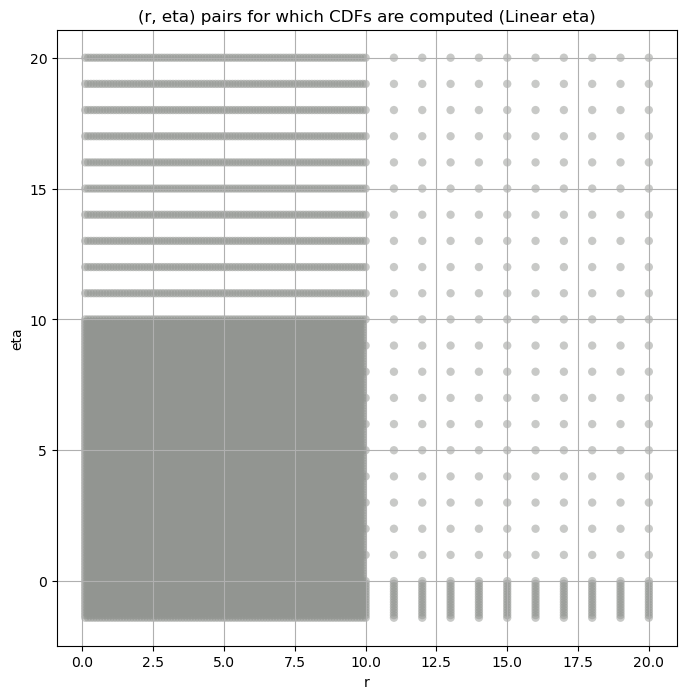

,"(r,eta),cdf",r,eta,cdf,variance,kurtosis
0,"((0.1, -1.4), <scipy.interpolate._fitpack2.Int...",0.1,-1.4,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.628800e+06,554265.000000
1,"((0.1, -1.3), <scipy.interpolate._fitpack2.Int...",0.1,-1.3,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.991680e+07,96192.272727
2,"((0.1, -1.2), <scipy.interpolate._fitpack2.Int...",0.1,-1.2,<scipy.interpolate._fitpack2.InterpolatedUniva...,2.395008e+08,29390.000000
3,"((0.1, -1.1), <scipy.interpolate._fitpack2.Int...",0.1,-1.1,<scipy.interpolate._fitpack2.InterpolatedUniva...,1.037837e+09,11997.692308
4,"((0.1, -1.0), <scipy.interpolate._fitpack2.Int...",0.1,-1.0,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.632429e+09,5874.890110


In [22]:
warnings.filterwarnings('ignore', category=RuntimeWarning)

all_cdfs_df = create_kurt_var_ksstat_df(all_cdfs)
fine_cdfs_df = all_cdfs_df.copy()
all_cdfs_df = all_cdfs_df[(np.round(all_cdfs_df['r'], 1) == all_cdfs_df['r']) & (np.round(all_cdfs_df['eta'], 1) == all_cdfs_df['eta'])]
all_cdfs_df = all_cdfs_df.reset_index(drop=True)
all_cdfs = {x[0] : x[1] for x in all_cdfs_df["(r,eta),cdf"]}
                                             
var_values_dict = dict()
kurt_values_dict = dict()
master_df = pd.DataFrame(columns=[GROUP]).set_index(GROUP)
temp_cdf = all_cdfs_df
print(f"Running {all_cdfs_df.shape[0]} CDFs")
create_scatter_plot(all_cdfs_df);
all_cdfs_df.head()

## Bootstrapping the Variance and Kurtosis

In [23]:
n_bootstrap = int(1e3) # TODO For quick testing purposes
bootstrap_size = int(1e3) # TODO For quick testing purposes
ci = 0.99

In [24]:
bootstrap_path = Path(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))
master_df_var_kurt_path = Path(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))

if True or not master_df_var_kurt_path.exists(): # TODO For quick testing purposes
    for group in GROUPS:
        print(f'{GROUP.capitalize()} {group}: {str(filter_group_map[group])}')
        obs_var, var_lower, var_upper, var_values_dict[group] = bootstrap_metric(group_data_map[group], 
                                                                                n_bootstrap=n_bootstrap, 
                                                                                bootstrap_size=min(group_data_map[group].size, bootstrap_size), 
                                                                                metric= np.var, 
                                                                                ci=ci)
        obs_kurt, kurt_lower, kurt_upper, kurt_values_dict[group] = bootstrap_metric(group_data_map[group], 
                                                                                    n_bootstrap=n_bootstrap, 
                                                                                    bootstrap_size=min(group_data_map[group].size, bootstrap_size), 
                                                                                    metric= stats.kurtosis, ci=ci)  
        master_df.loc[group, 'obs_var'], master_df.loc[group, 'var_lower'], master_df.loc[group, 'var_upper'] = obs_var, var_lower, var_upper
        master_df.loc[group, 'obs_kurt'], master_df.loc[group, 'kurt_lower'], master_df.loc[group, 'kurt_upper'] = obs_kurt, kurt_lower, kurt_upper
        master_df.loc[group, 'total_samples'] = group_total_samples[group]
        master_df.loc[group, 'filter_group'] = str(filter_group_map[group])

    master_df.to_csv(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))

master_df = pd.read_csv(master_df_var_kurt_path, index_col=GROUP)
var_kurt_df = pd.read_csv(bootstrap_path, index_col=GROUP)
master_df

Filter_idx 0: (2.0, 0.5, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 1: (2.0, 0.5, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 2: (2.0, 0.5, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 3: (2.0, 0.5, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 4: (2.0, 0.5, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 5: (2.0, 0.5, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 6: (2.0, 0.5, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 7: (2.0, 1.0, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 8: (2.0, 1.0, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 9: (2.0, 1.0, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 10: (2.0, 1.0, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 11: (2.0, 1.0, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 12: (2.0, 1.0, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 13: (2.0, 1.0, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 14: (3.0, 0.5, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 15: (3.0, 0.5, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 16: (3.0, 0.5, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 17: (3.0, 0.5, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 18: (3.0, 0.5, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 19: (3.0, 0.5, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 20: (3.0, 0.5, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 21: (3.0, 1.0, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 22: (3.0, 1.0, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 23: (3.0, 1.0, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 24: (3.0, 1.0, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 25: (3.0, 1.0, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 26: (3.0, 1.0, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 27: (3.0, 1.0, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 28: (4.0, 0.5, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 29: (4.0, 0.5, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 30: (4.0, 0.5, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 31: (4.0, 0.5, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 32: (4.0, 0.5, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 33: (4.0, 0.5, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 34: (4.0, 0.5, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 35: (4.0, 1.0, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 36: (4.0, 1.0, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 37: (4.0, 1.0, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 38: (4.0, 1.0, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 39: (4.0, 1.0, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 40: (4.0, 1.0, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 41: (4.0, 1.0, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group
filter_idx,,,,,,,,
0,24111.888294,19052.401645,30447.957447,5.579921,2.075283,14.192461,136161000.0,"(2.0, 0.5, 0.044)"
1,11877.167756,8706.483888,16085.379803,10.964418,5.169127,17.980163,136161000.0,"(2.0, 0.5, 0.065)"
2,4272.713551,3134.622665,5762.139707,12.807588,6.852190,22.106602,136161000.0,"(2.0, 0.5, 0.096)"
3,1078.932665,776.505441,1487.405395,14.176789,6.576698,46.788592,136161000.0,"(2.0, 0.5, 0.141)"
4,218.209237,150.523220,373.627688,26.427271,6.846993,183.210028,136161000.0,"(2.0, 0.5, 0.208)"
5,39.820943,25.610523,77.371432,48.922184,6.457623,273.277159,136161000.0,"(2.0, 0.5, 0.306)"
6,19.318296,12.843038,45.810489,58.404167,6.968506,329.241909,136161000.0,"(2.0, 0.5, 0.45)"
7,29661.968209,24103.130769,37590.664964,5.471542,1.646046,19.096018,136161000.0,"(2.0, 1.0, 0.044)"
8,14517.113438,10519.183070,19456.750483,12.431846,4.327867,26.223462,136161000.0,"(2.0, 1.0, 0.065)"


## Initial Grid Search and Hypothesis Test Plots

In [25]:
EXCLUDE_CUTOFFS = [0, 50, 100, 200] # TODO For quick testing purposes
SCALE_CAP = 1e5

In [26]:
augmented_var_df_path = Path(os.path.join(CWD, "CSVs", "augmented_var_df.csv"))
augmented_var_df = var_kurt_df[['obs_var']].copy()
augmented_var_df
for val in EXCLUDE_CUTOFFS:
    temp_arr = []
    for group in GROUPS:
        if val != 0:
            temp_arr.append(np.var(group_data_map[group][val:-val]))
        else:
            temp_arr.append(np.var(group_data_map[group]))

    augmented_var_df[f"var_exclude_{val}"] = temp_arr
augmented_var_df

,obs_var,var_exclude_0,var_exclude_50,var_exclude_100,var_exclude_200
filter_idx,,,,,
0,24111.888294,24111.888294,22979.584490,22301.170469,21277.435527
1,11877.167756,11877.167756,11185.563128,10684.442326,9922.915132
2,4272.713551,4272.713551,4017.847779,3831.611039,3536.984505
3,1078.932665,1078.932665,1005.991668,959.362085,887.193644
4,218.209237,218.209237,196.803998,187.451144,173.511792
5,39.820943,39.820943,34.373336,32.495347,29.853806
6,19.318296,19.318296,16.692907,15.823714,14.569178
7,29661.968209,29661.968209,28201.286850,27345.715854,26090.879979
8,14517.113438,14517.113438,13462.238317,12826.620414,11894.810946


####
Filter_idx, 0: (2.0, 0.5, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 0 0.004601266761216083 24111.88829402033


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 50 0.003963296540623107 22979.584490411948


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 100 0.003896211825428736 22301.1704686491


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 200 0.0035499701906055448 21277.435526621284
Number of samples: 100000, Without approximation : 136161000.0


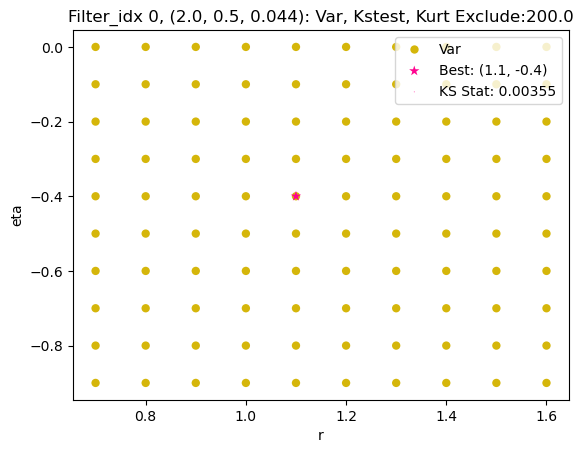

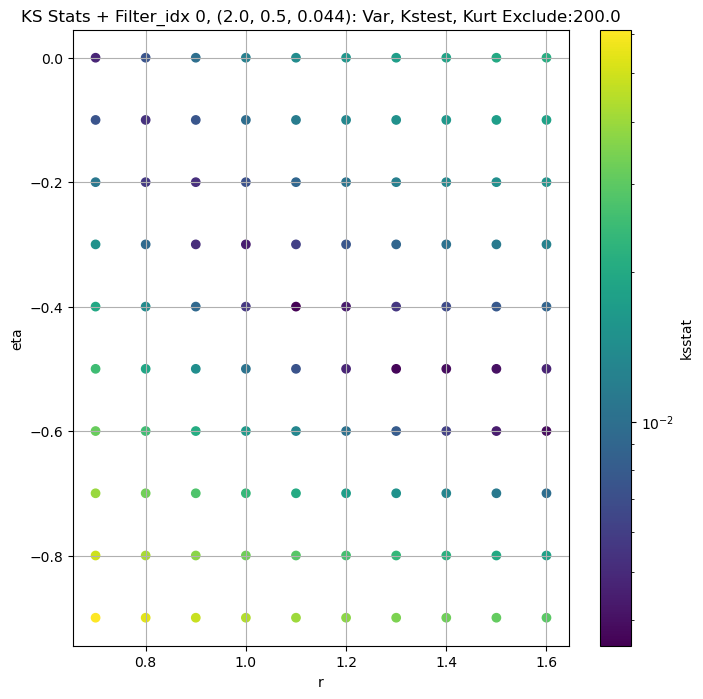

####
Filter_idx, 1: (2.0, 0.5, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 0 0.0065721740175489485 11877.167756236777


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 50 0.006748087733389196 11185.56312795882


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 100 0.006535176972282675 10684.442325994956


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 200 0.005937753640650856 9922.915131540687
Number of samples: 100000, Without approximation : 136161000.0


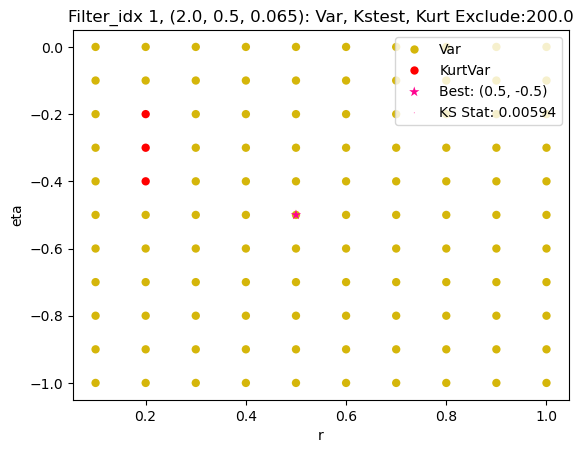

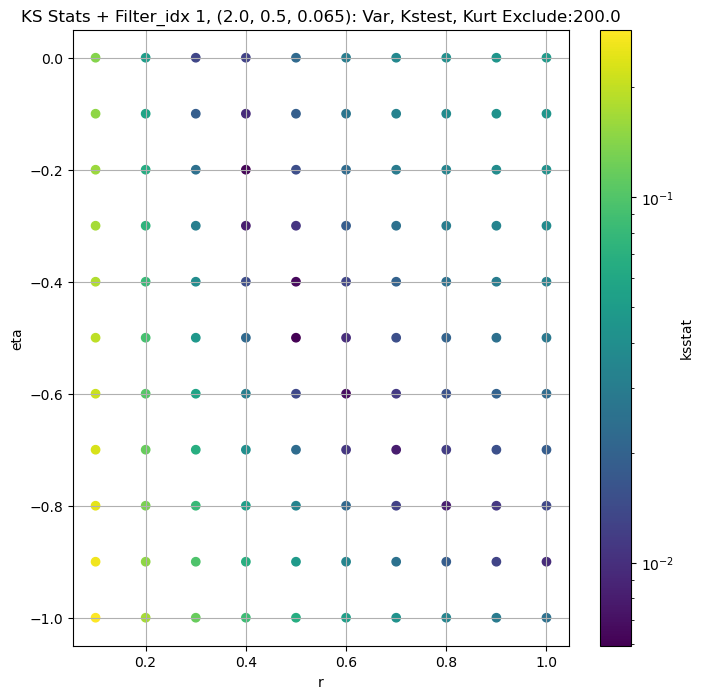

####
Filter_idx, 2: (2.0, 0.5, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 0 0.0063485585610146555 4272.713551058823


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 50 0.005220180899122906 4017.84777914347


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 100 0.00581160270365344 3831.6110389950013


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 200 0.004212738145676676 3536.9845046889614
Number of samples: 100000, Without approximation : 136161000.0


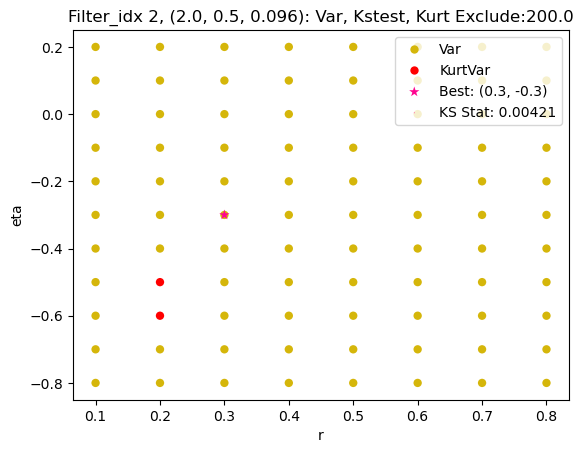

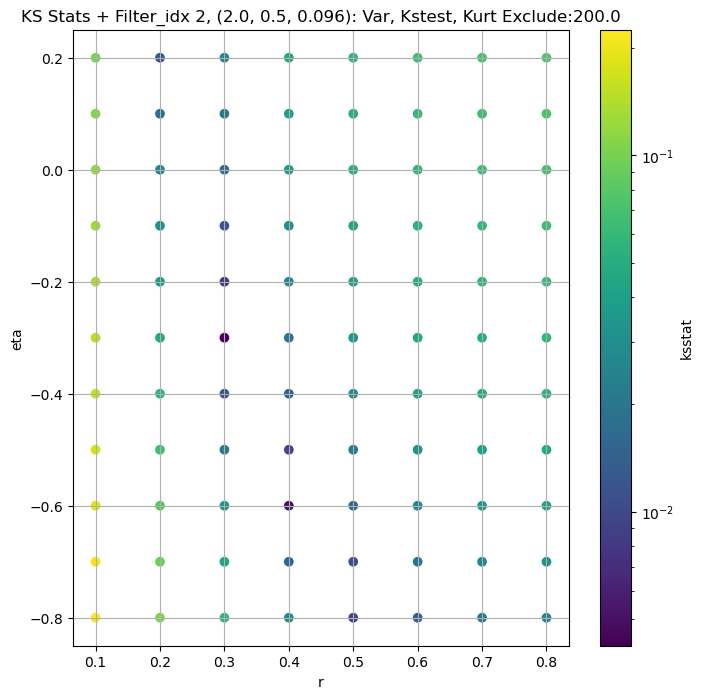

####
Filter_idx, 3: (2.0, 0.5, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 0 0.005197929256775979 1078.9326645583983


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 50 0.004013817154302435 1005.9916682214986


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 100 0.004646702404018654 959.3620845259892


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 200 0.004315343199452978 887.193643850949
Number of samples: 100000, Without approximation : 136161000.0


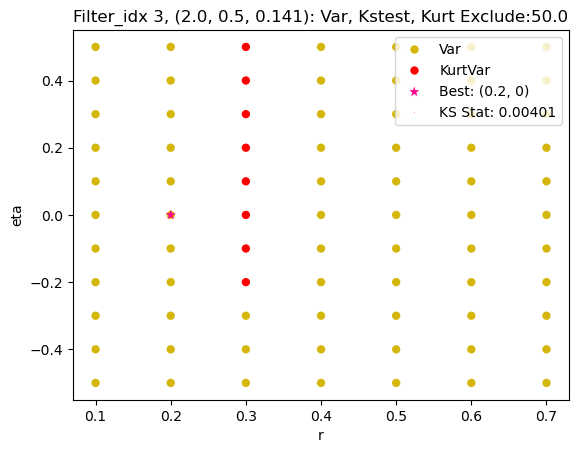

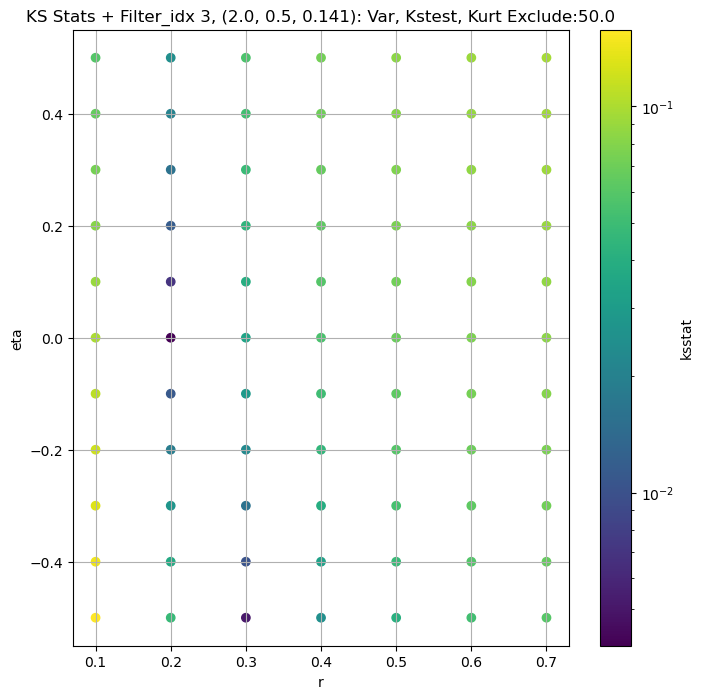

####
Filter_idx, 4: (2.0, 0.5, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 0 0.0030095085572773295 218.2092374296753


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 50 0.0032274777942069566 196.80399833051038


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 100 0.0035043411777002653 187.4511438558966


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 200 0.004709220876793707 173.5117920303951
Number of samples: 100000, Without approximation : 136161000.0


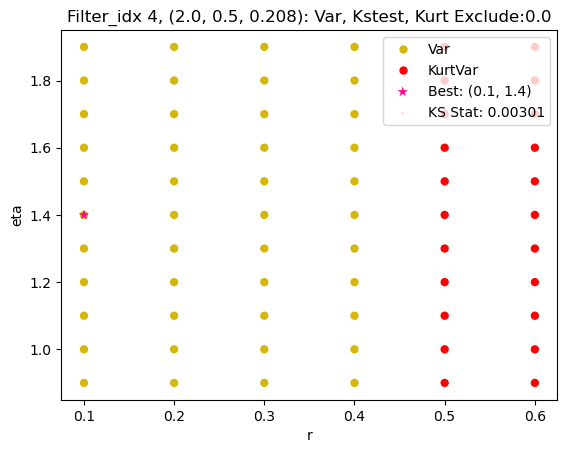

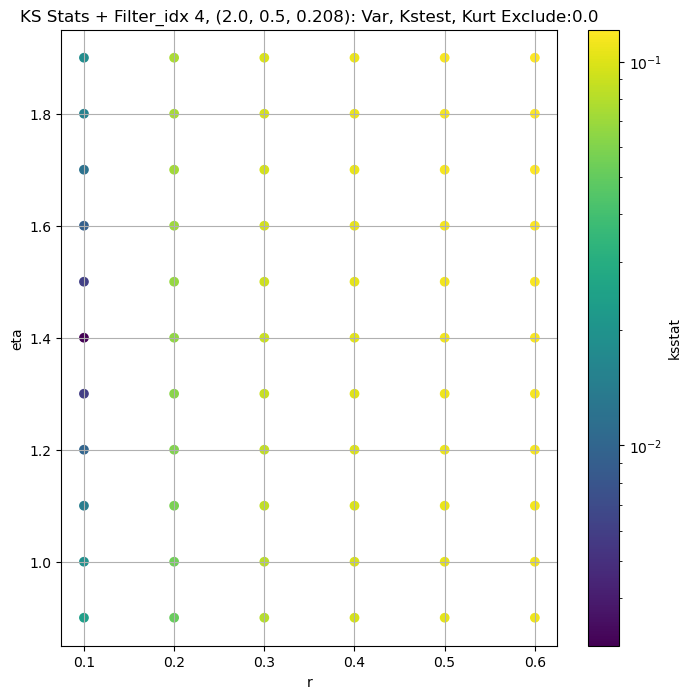

####
Filter_idx, 5: (2.0, 0.5, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 0 0.0035062367263845318 39.82094326182208


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 50 0.004471547360804906 34.37333602024878


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 100 0.004082540759877795 32.49534692832357


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 200 0.006203227812440704 29.85380629825488
Number of samples: 100000, Without approximation : 136161000.0


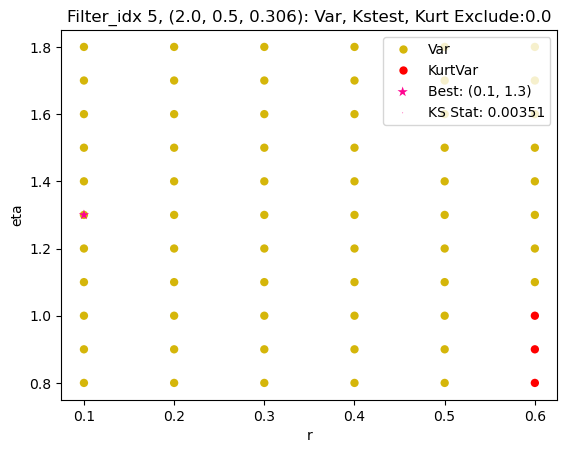

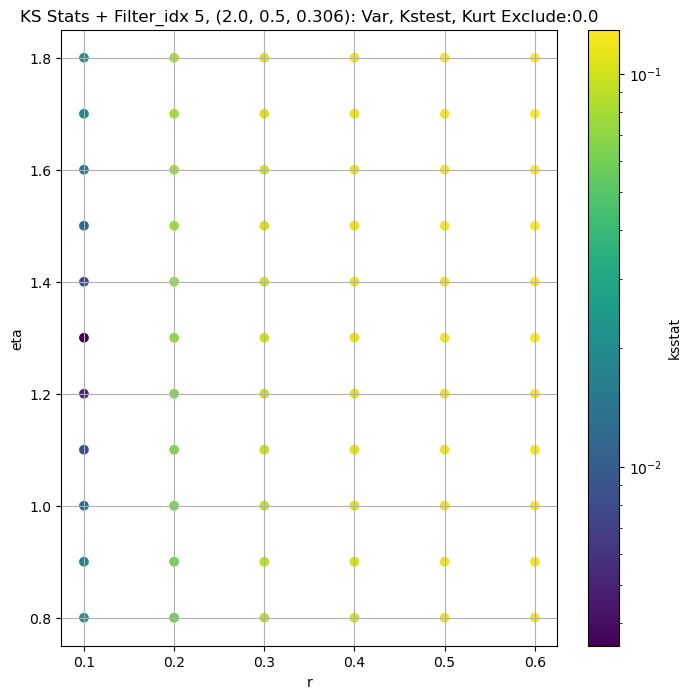

####
Filter_idx, 6: (2.0, 0.5, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 0 0.005433290370587929 19.318296415708957


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 50 0.0039770711013839 16.692907301983734


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 100 0.005414436332367378 15.823713626211138


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 200 0.005796565489850525 14.569177739532941
Number of samples: 100000, Without approximation : 136161000.0


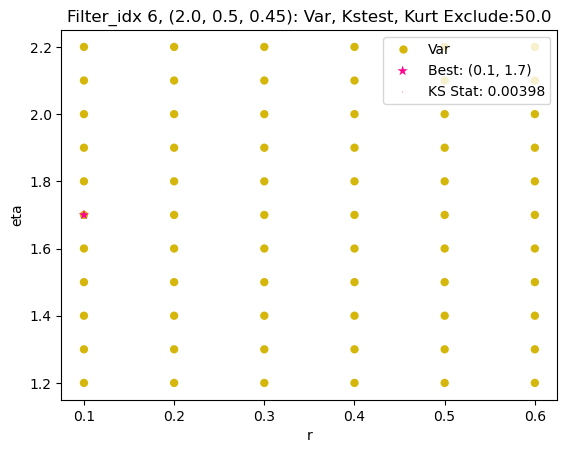

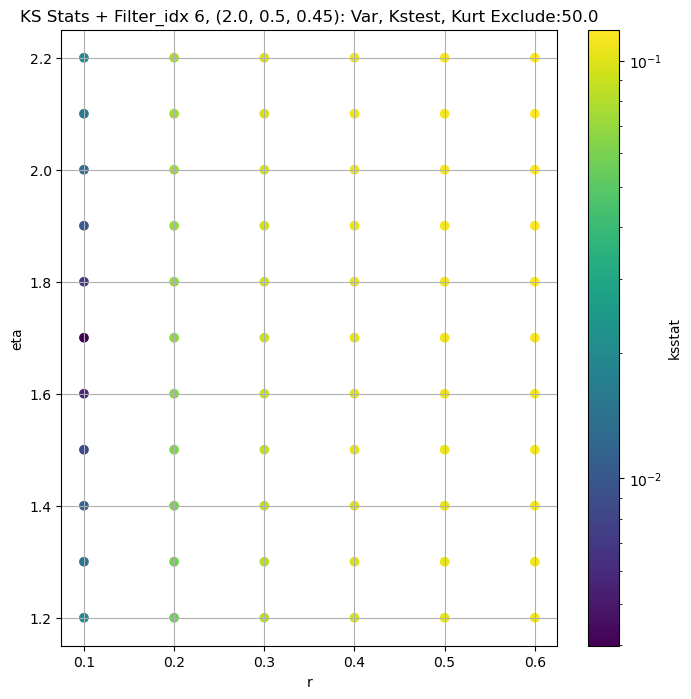

####
Filter_idx, 7: (2.0, 1.0, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 0 0.0024712327601031925 29661.968208881182


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 50 0.0014707491806146278 28201.286849816883


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 100 0.0016776874510827655 27345.715854064678


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 200 0.0024731525464785215 26090.879979185906
Number of samples: 100000, Without approximation : 136161000.0


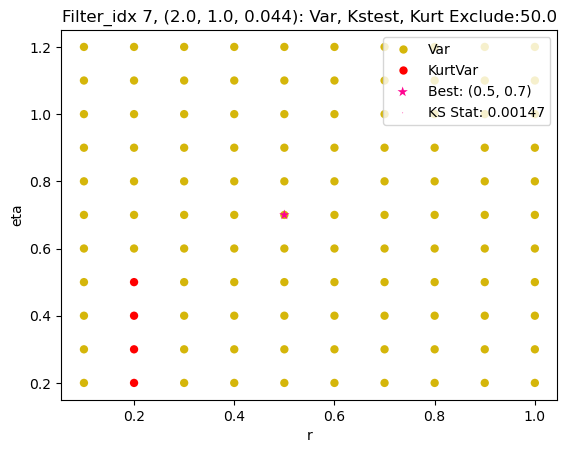

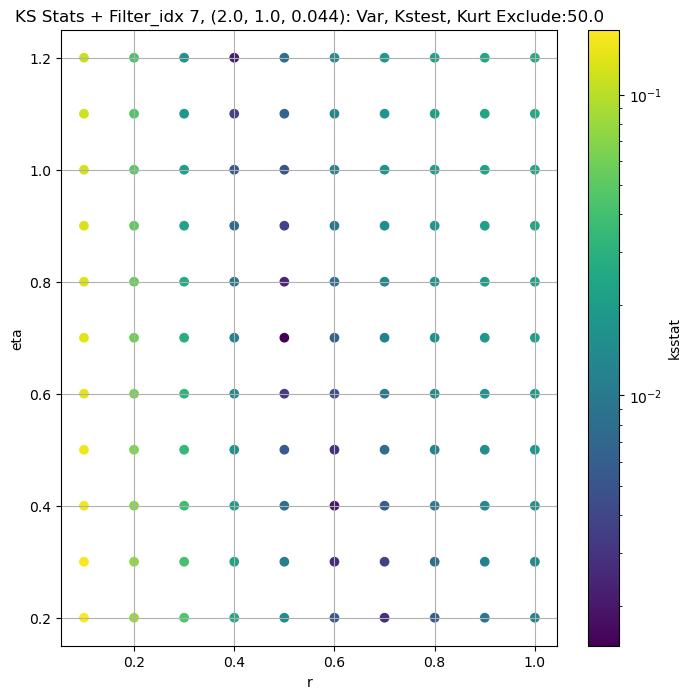

####
Filter_idx, 8: (2.0, 1.0, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 0 0.005814660358799961 14517.113437863081


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 50 0.00464117186328139 13462.238317086138


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 100 0.004172299341816066 12826.620413533665


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 200 0.0041056434746392645 11894.810946325702
Number of samples: 100000, Without approximation : 136161000.0


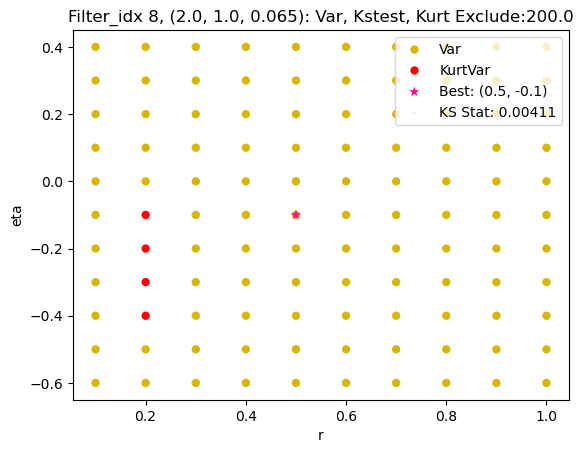

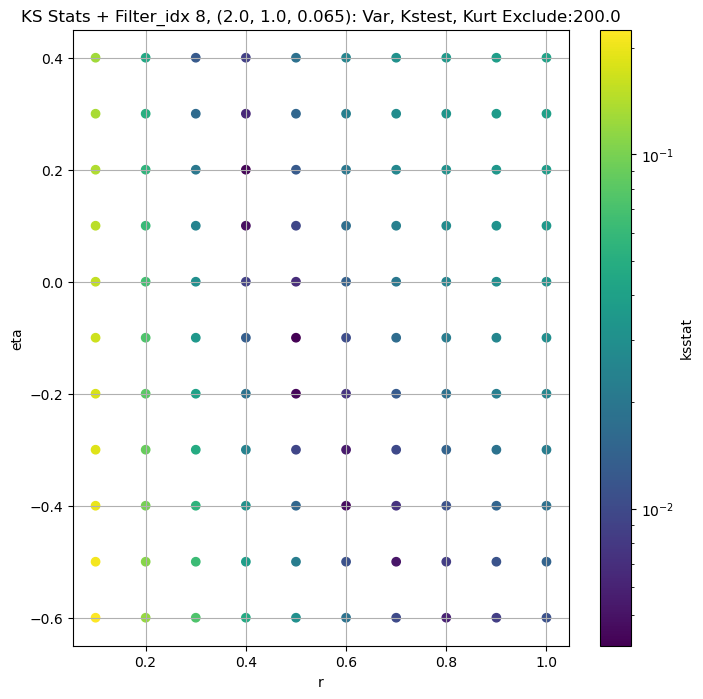

####
Filter_idx, 9: (2.0, 1.0, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 0 0.0065023225543816565 6166.702256197297


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 50 0.004573215566679889 5725.245989341669


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 100 0.004608242163235521 5415.532029640232


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 200 0.004728152387111995 4943.313083038407
Number of samples: 100000, Without approximation : 136161000.0


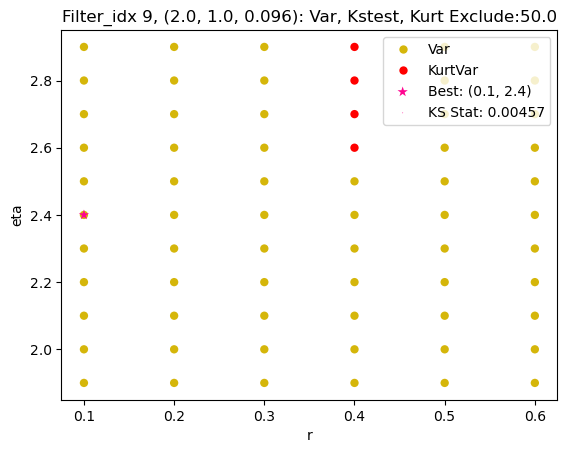

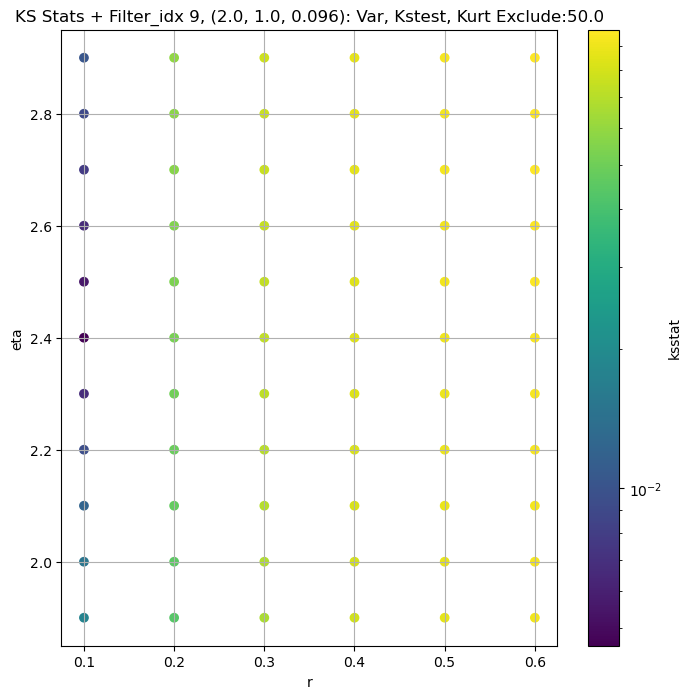

####
Filter_idx, 10: (2.0, 1.0, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 0 0.004235982782035963 1821.148368404074


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 50 0.004138557241165297 1693.9628229071375


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 100 0.003083099099323583 1610.58341246199


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 200 0.004242853659319423 1482.9278623803611
Number of samples: 100000, Without approximation : 136161000.0


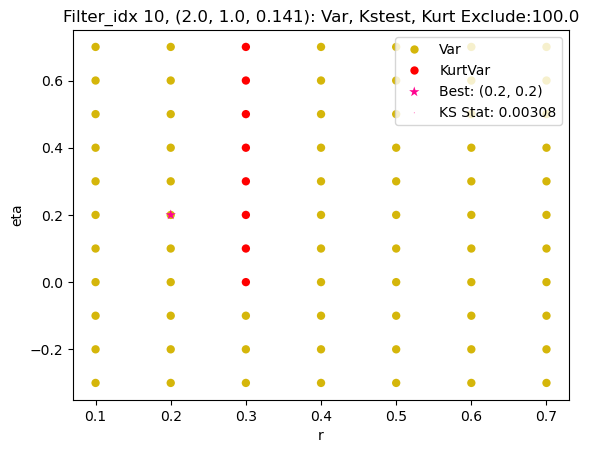

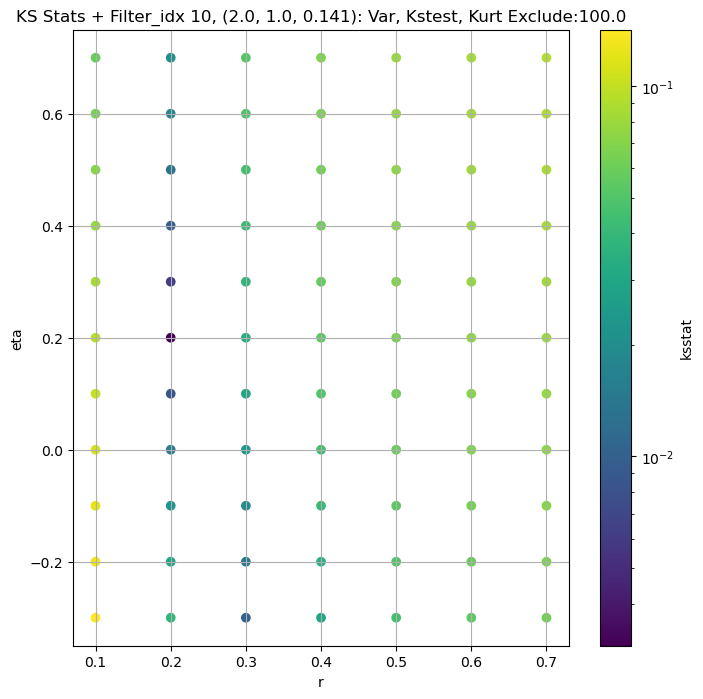

####
Filter_idx, 11: (2.0, 1.0, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 0 0.004324941920021863 408.8180671324572


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 50 0.0042048219035731305 374.0598165425166


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 100 0.0038960846333245813 356.4639091990768


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 200 0.004929999391042106 329.9343158963047
Number of samples: 100000, Without approximation : 136161000.0


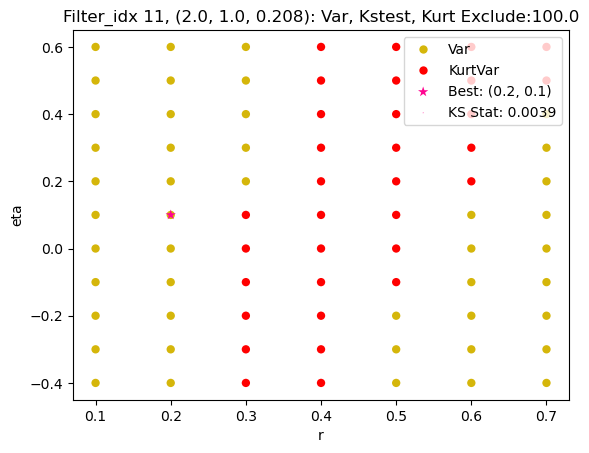

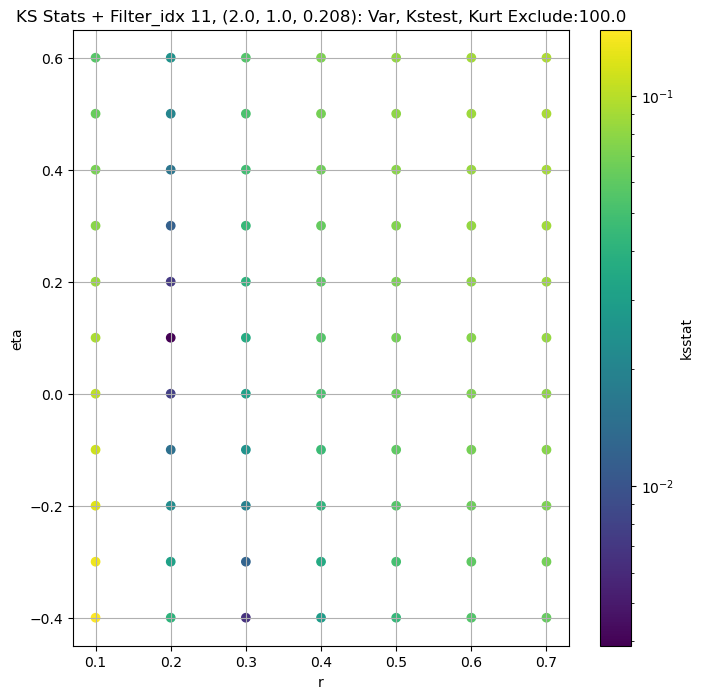

####
Filter_idx, 12: (2.0, 1.0, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 0 0.0020298122464896817 79.91926652878242


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 50 0.003416582647808364 70.26270115449789


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 100 0.004261441466024696 66.62526927443895


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 200 0.005332703368997212 61.43915476228759
Number of samples: 100000, Without approximation : 136161000.0


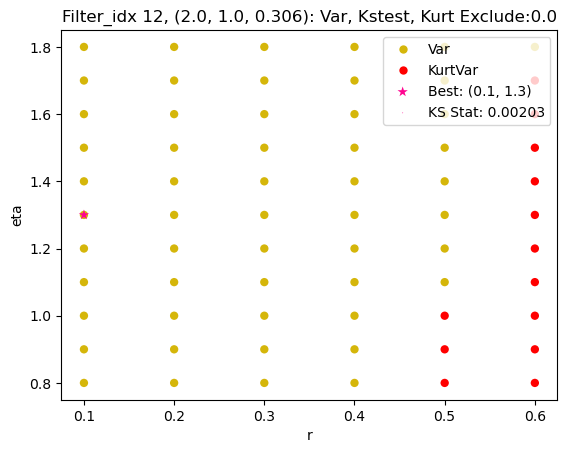

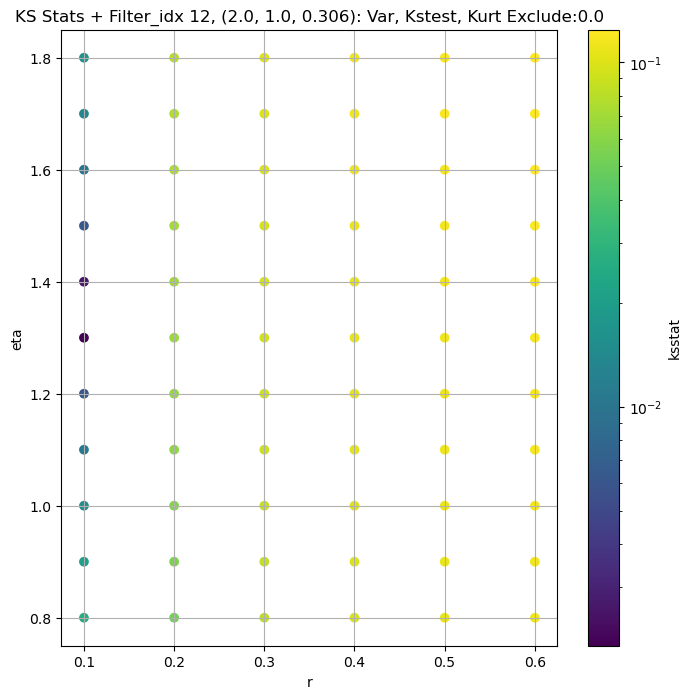

####
Filter_idx, 13: (2.0, 1.0, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 0 0.005986804895327991 22.026033928677723


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 50 0.004562468686889809 18.930491524216023


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 100 0.005009664726687846 17.824720639325516


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 200 0.005789163170354161 16.294427170798862
Number of samples: 100000, Without approximation : 136161000.0


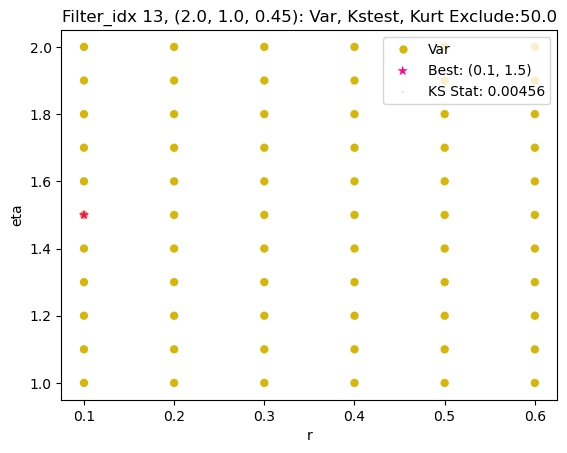

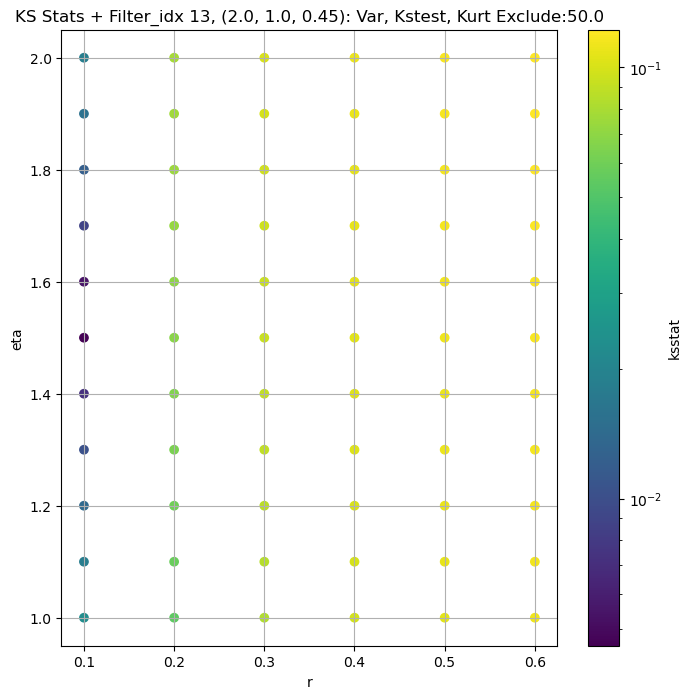

####
Filter_idx, 14: (3.0, 0.5, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 0 0.004320890090221963 20334.26163310914


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 50 0.0029168240565747294 19144.89529313029


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 100 0.0019269723187865608 18464.37280702396


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 200 0.002683955009398442 17504.77820910147
Number of samples: 100000, Without approximation : 136161000.0


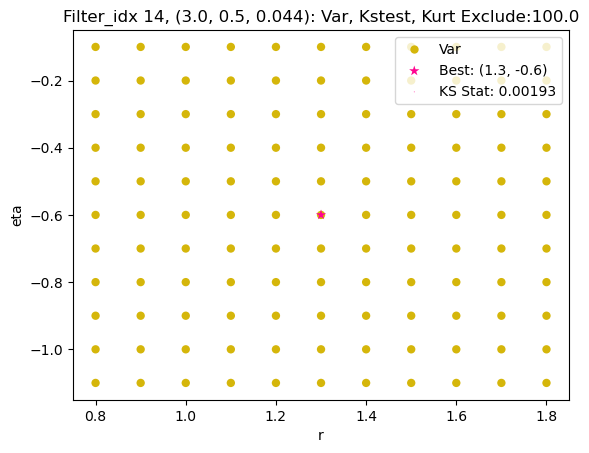

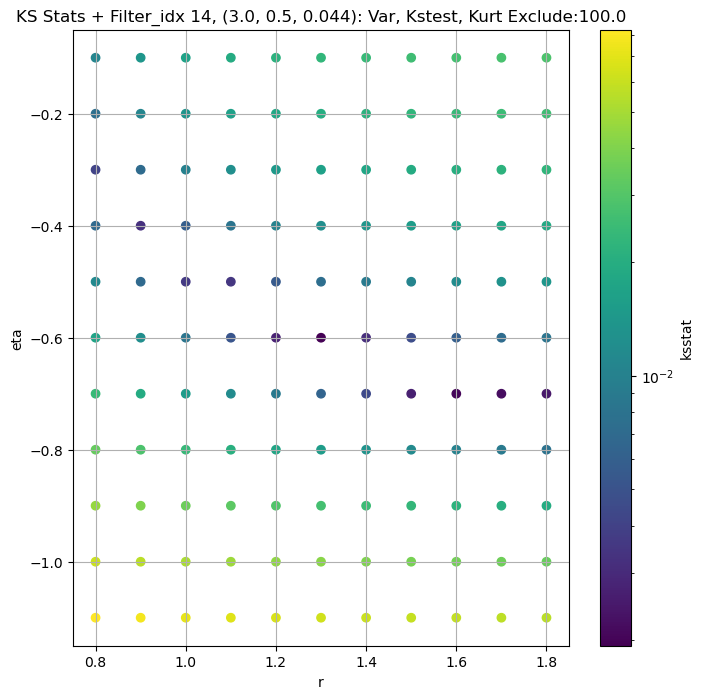

####
Filter_idx, 15: (3.0, 0.5, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 0 0.00467498837186401 8481.16852651321


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 50 0.003359203074705386 7901.017375133123


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 100 0.0030692954670990535 7511.109168575927


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 200 0.002916745836563095 6932.202863339326
Number of samples: 100000, Without approximation : 136161000.0


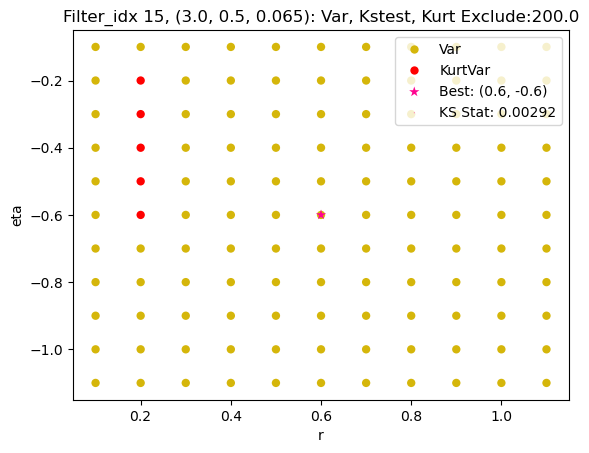

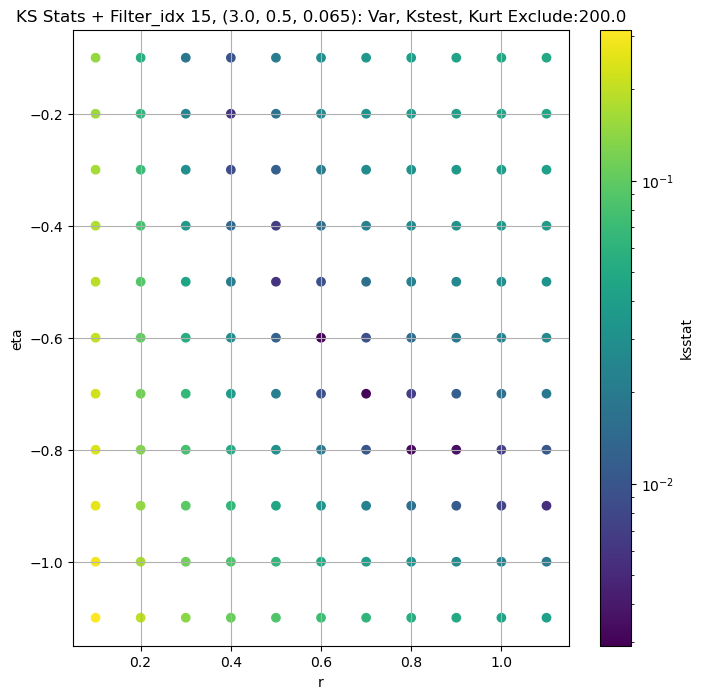

####
Filter_idx, 16: (3.0, 0.5, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 0 0.003886142505025475 3215.5339280661833


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 50 0.0026137695125413307 2945.4864806008886


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 100 0.002291891099686749 2764.5595039048144


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 200 0.003378476555841904 2490.764231309979
Number of samples: 100000, Without approximation : 136161000.0


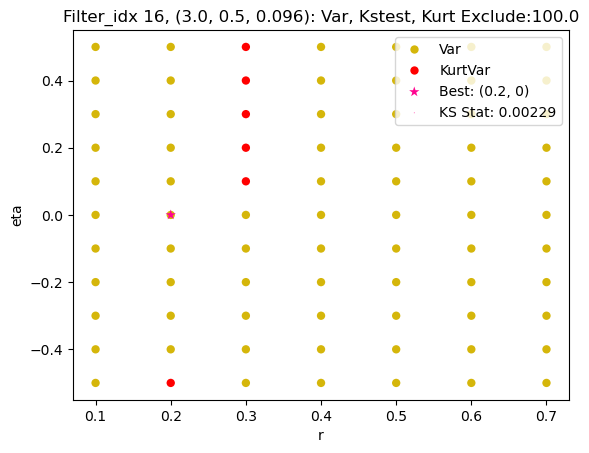

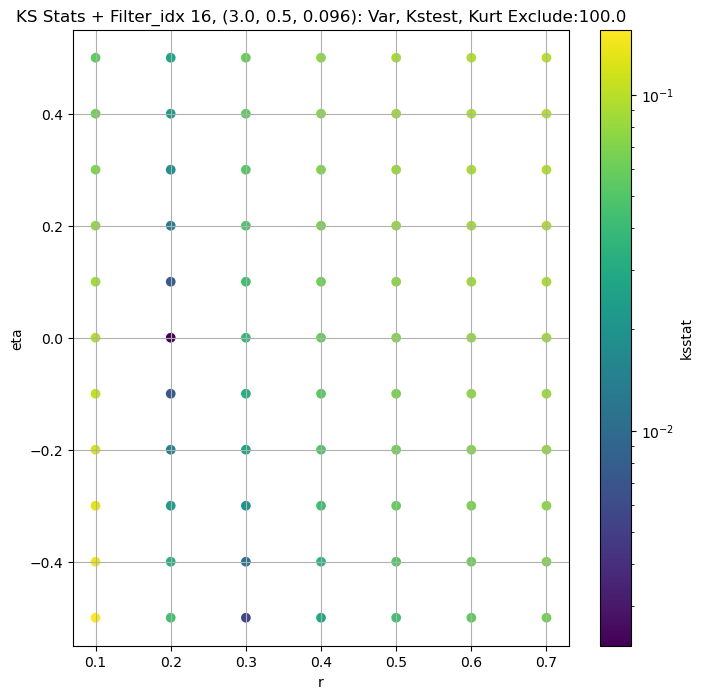

####
Filter_idx, 17: (3.0, 0.5, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 0 0.0011438637360090542 685.4049185011345


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 50 0.003262460245553156 614.685619361966


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 100 0.002876944373029433 576.6785632486433


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 200 0.004440025621512508 520.2358568245071
Number of samples: 100000, Without approximation : 136161000.0


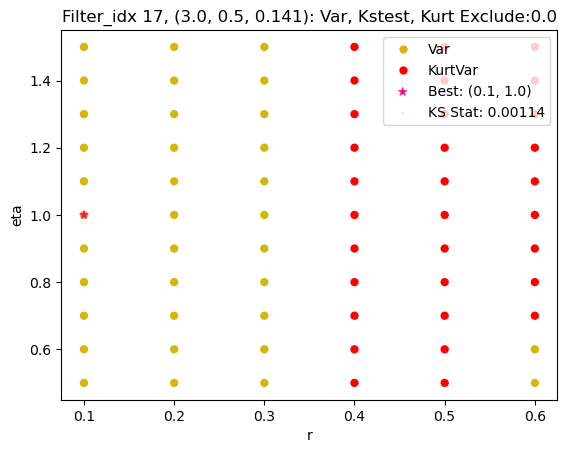

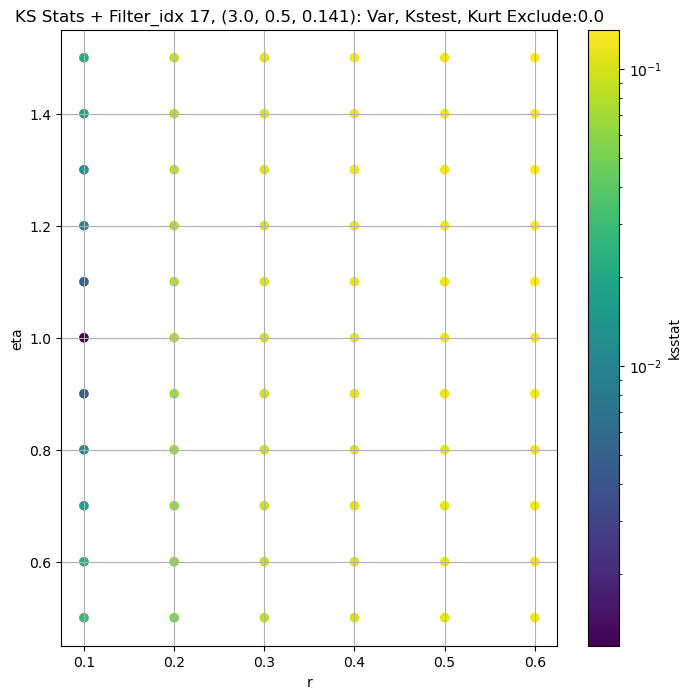

####
Filter_idx, 18: (3.0, 0.5, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 0 0.005572227730859636 99.86562679041884


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 50 0.003772299308281213 79.3219674582591


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 100 0.0043615118729100205 74.04986870230479


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 200 0.006026749690091204 66.87321002526589
Number of samples: 100000, Without approximation : 136161000.0


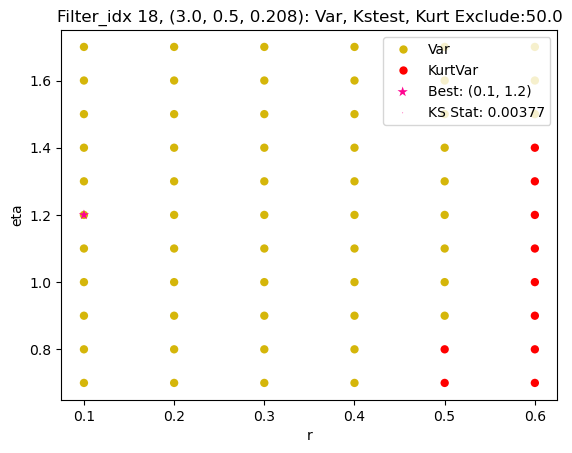

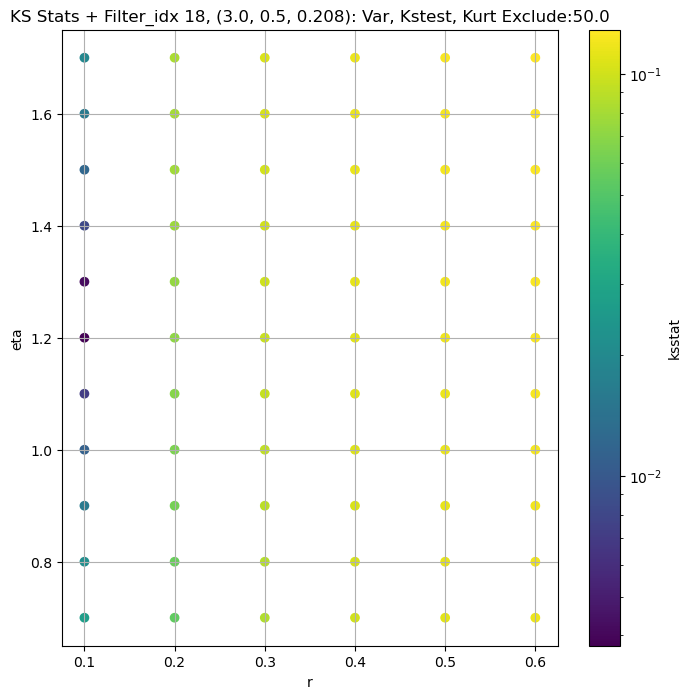

####
Filter_idx, 19: (3.0, 0.5, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 0 0.008675890089730354 23.55986258743369


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 50 0.006467000603890605 18.54577669860327


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 100 0.005055225776297939 17.348652898787048


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 200 0.006921943694321142 15.719435591758238
Number of samples: 100000, Without approximation : 136161000.0


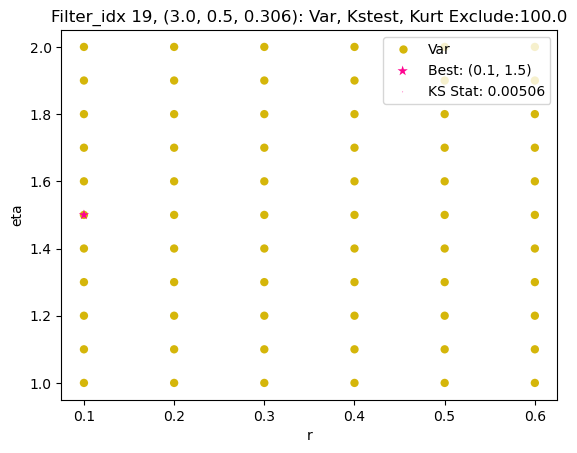

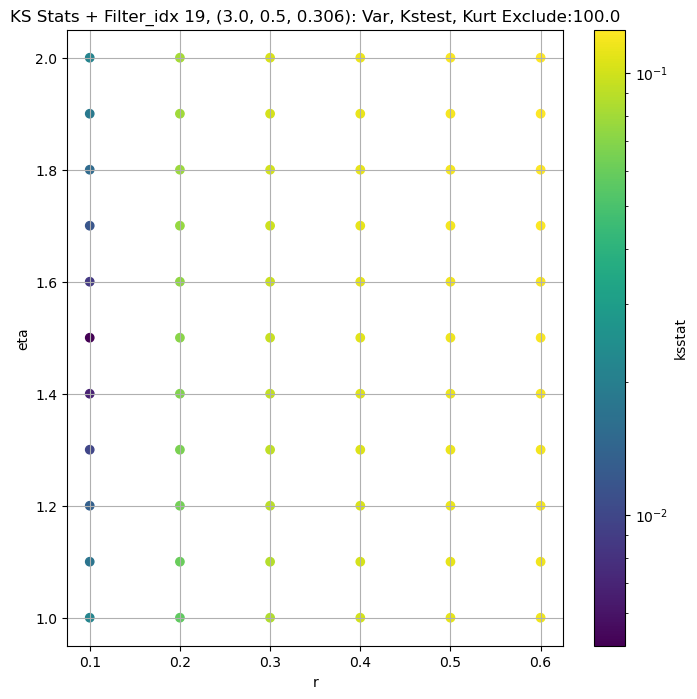

####
Filter_idx, 20: (3.0, 0.5, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 0 0.006753264855407198 9.30091777009618


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 50 0.005213786196135717 8.327385754740419


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 100 0.005174509829960705 7.899778091104452


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 200 0.005811748500564595 7.267921859679271
Number of samples: 100000, Without approximation : 136161000.0


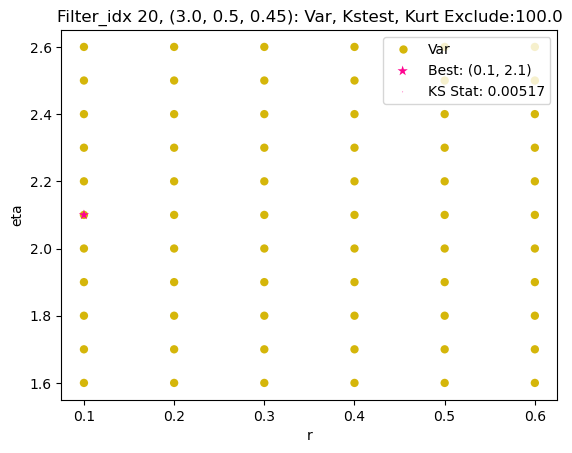

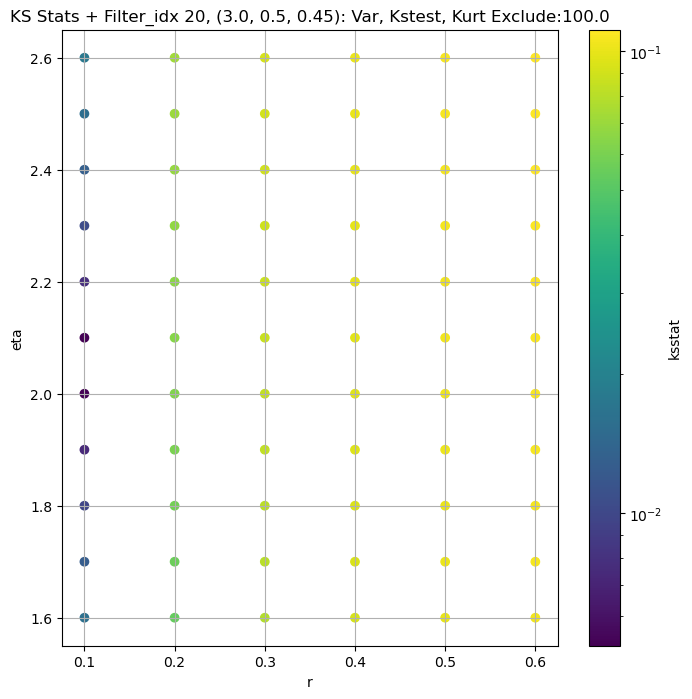

####
Filter_idx, 21: (3.0, 1.0, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 0 0.002696088515721916 24402.94069481798


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 50 0.001907791240426615 23090.125027728925


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 100 0.0016651937980281255 22339.029038266406


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 200 0.002485092330526406 21262.767777242752
Number of samples: 100000, Without approximation : 136161000.0


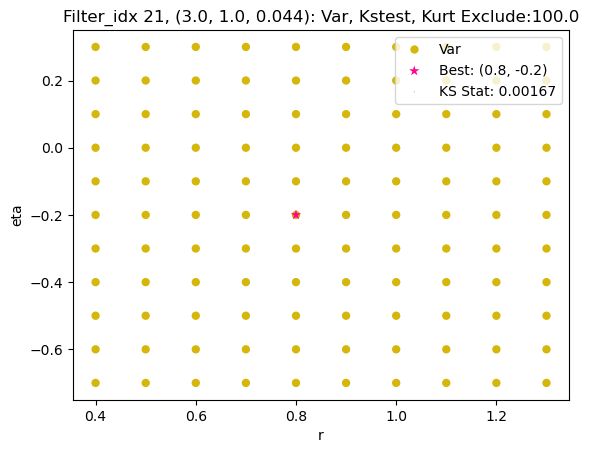

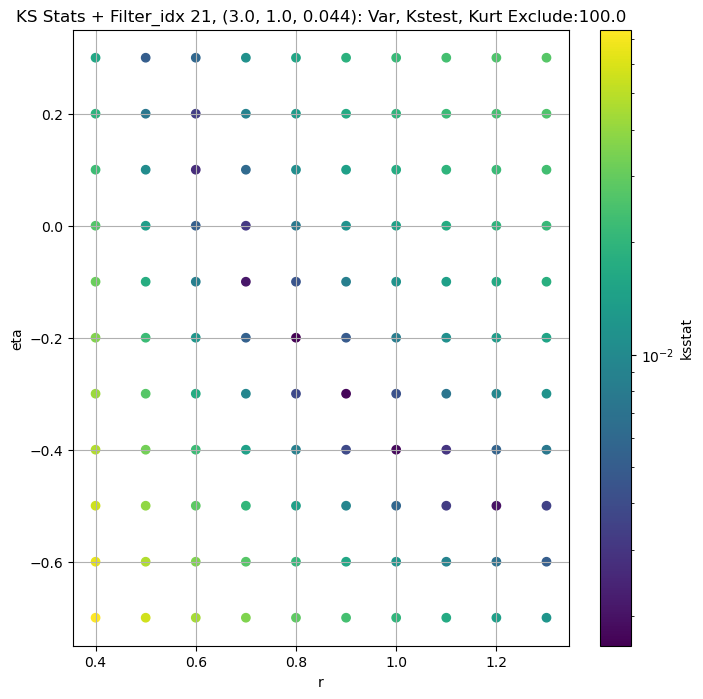

####
Filter_idx, 22: (3.0, 1.0, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 0 0.0030603693910866703 8900.258528887729


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 50 0.002110170409480916 8169.214356649814


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 100 0.0016771815012389486 7784.91086859165


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 200 0.0027207588999790255 7274.537302450895
Number of samples: 100000, Without approximation : 136161000.0


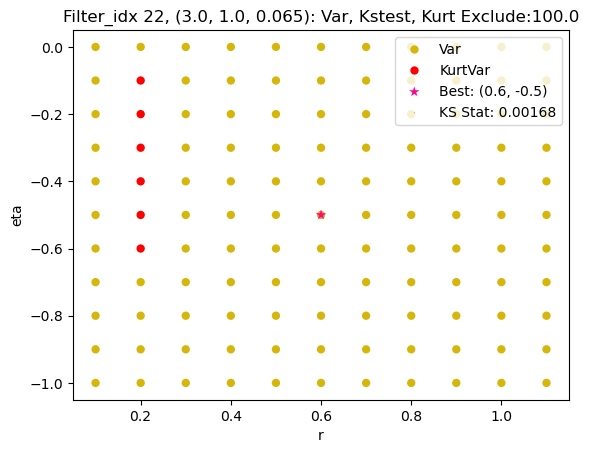

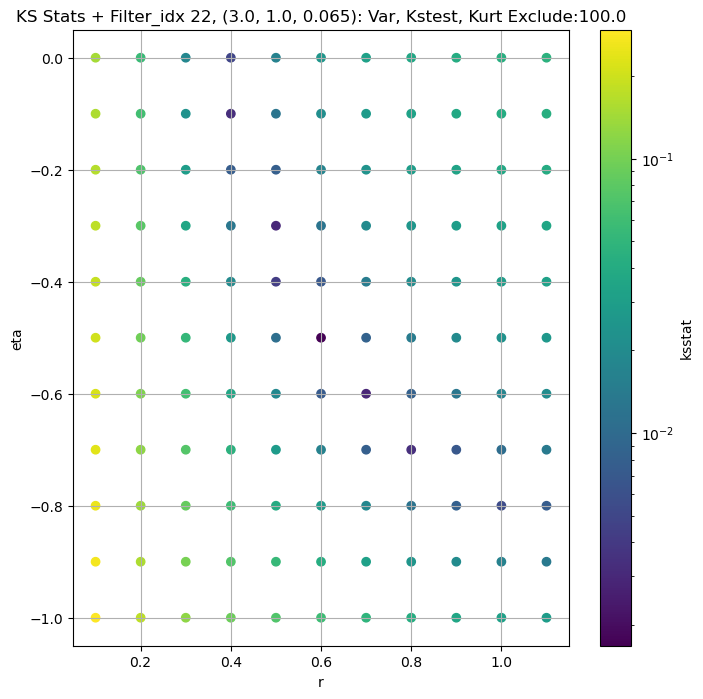

####
Filter_idx, 23: (3.0, 1.0, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 0 0.003738382477116664 3508.70525172296


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 50 0.002678845407468572 3114.9827503677816


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 100 0.0018543128010126697 2880.891760441422


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 200 0.0030779495041017846 2569.0273636188067
Number of samples: 100000, Without approximation : 136161000.0


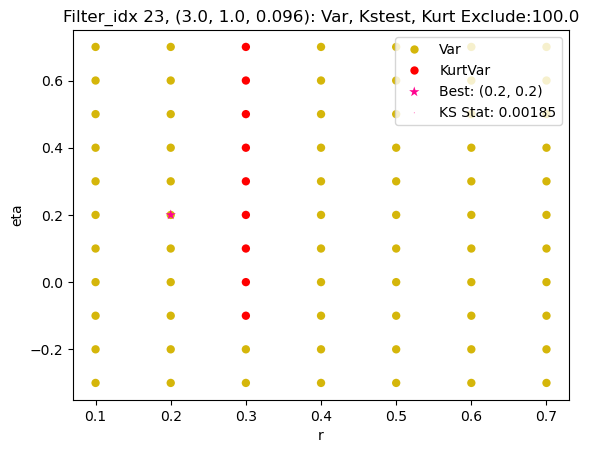

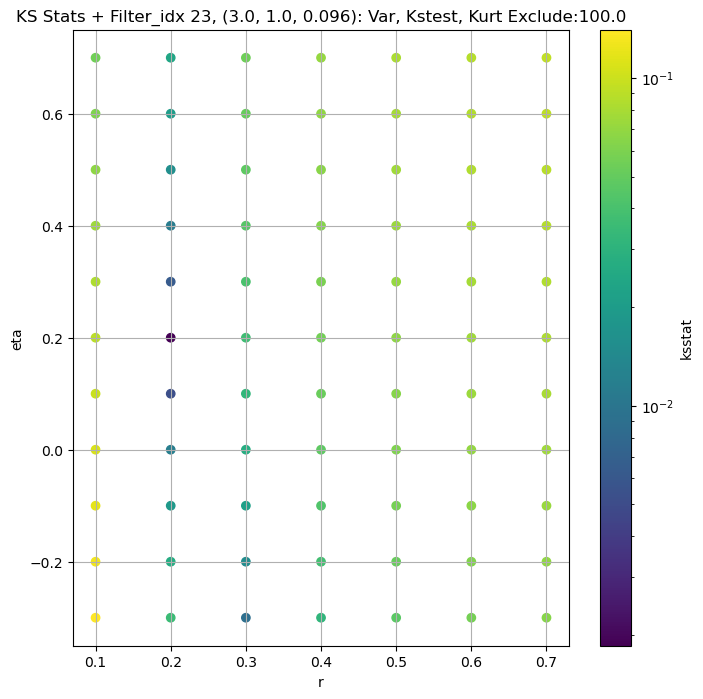

####
Filter_idx, 24: (3.0, 1.0, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 0 0.0032218777831267698 893.056330892022


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 50 0.0015307923673350404 787.1885352100794


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 100 0.002686838646657315 728.8584353625754


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 200 0.0038943368860504535 645.8292012725178
Number of samples: 100000, Without approximation : 136161000.0


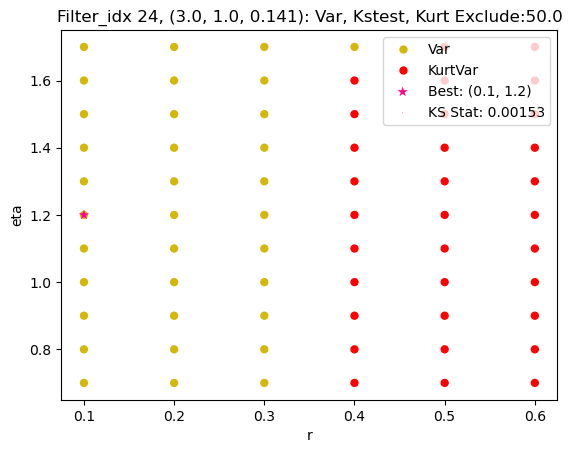

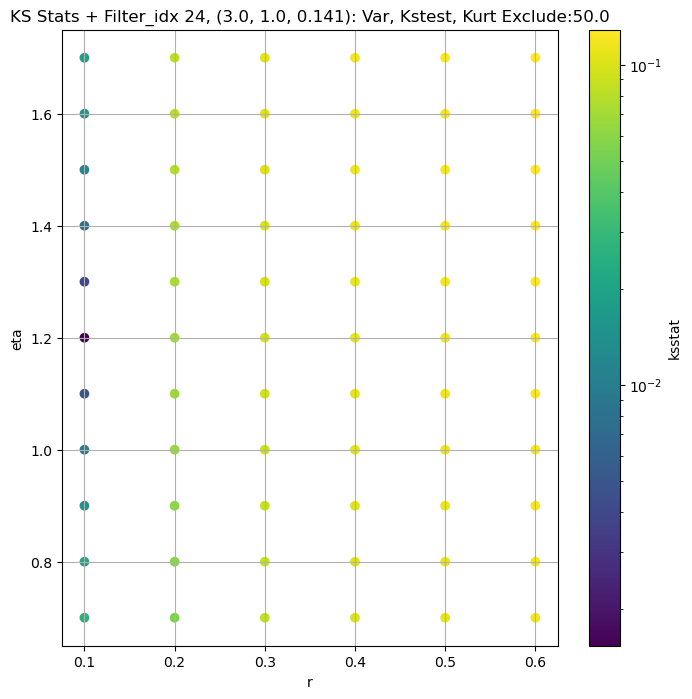

####
Filter_idx, 25: (3.0, 1.0, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 0 0.006438859423793908 145.8257812444831


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 50 0.002907451234683167 117.88972183831996


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 100 0.003376683157651883 109.21089840272519


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 200 0.005699317977187257 97.40313330075814
Number of samples: 100000, Without approximation : 136161000.0


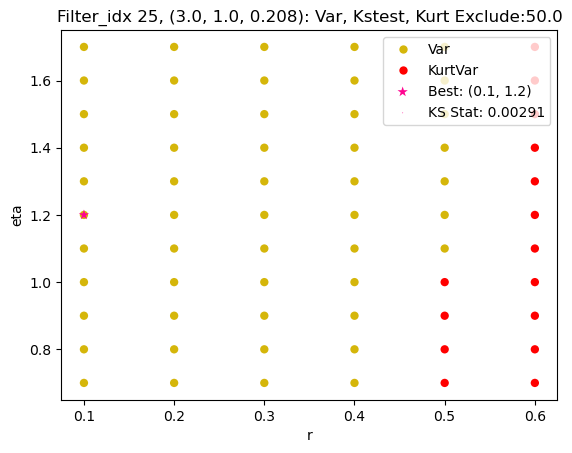

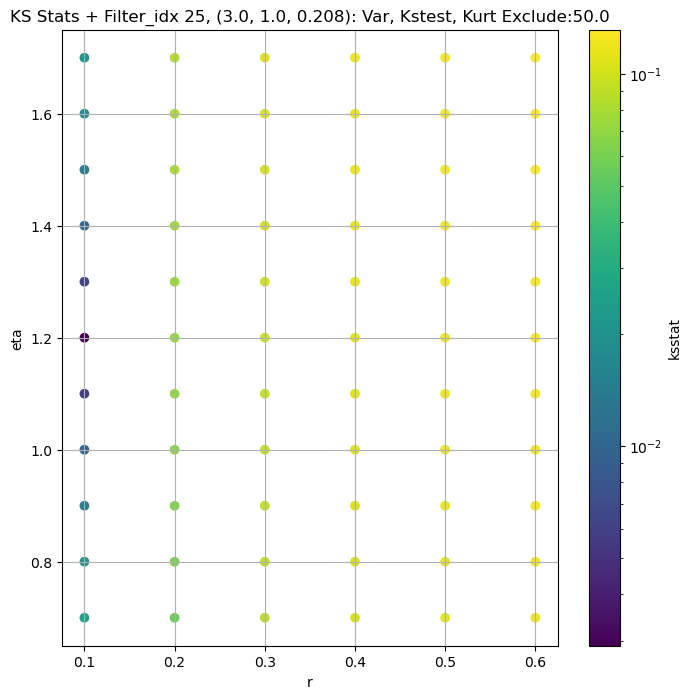

####
Filter_idx, 26: (3.0, 1.0, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 0 0.010792546250773416 30.76690778400487


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 50 0.006288226810958697 23.435893215598


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 100 0.005576120998055711 21.698167067351193


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 200 0.006318721355438622 19.53439786968151
Number of samples: 100000, Without approximation : 136161000.0


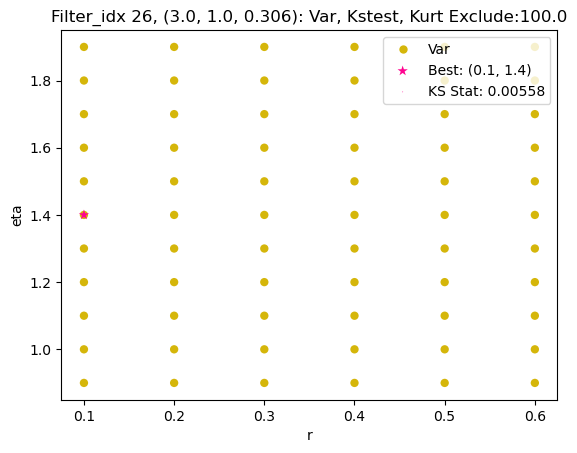

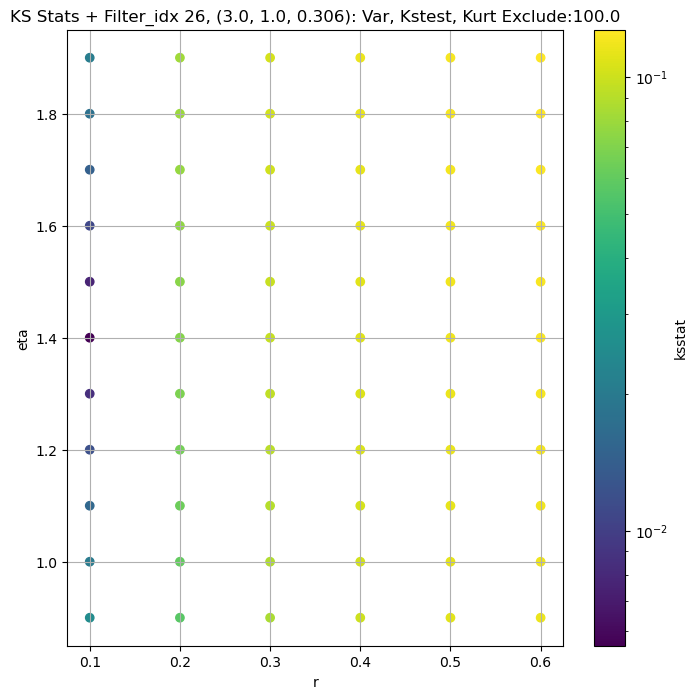

####
Filter_idx, 27: (3.0, 1.0, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 0 0.010125767199597457 9.845392137767352


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 50 0.008007647051877592 8.520731672756835


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 100 0.007865816542462767 7.920732239672799


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 200 0.0053603612635909625 7.121911576749765
Number of samples: 100000, Without approximation : 136161000.0


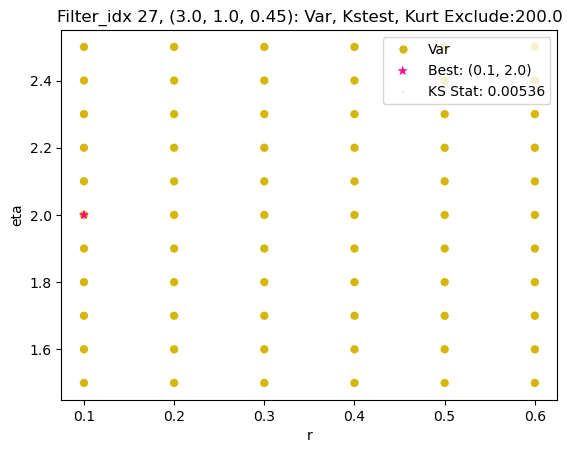

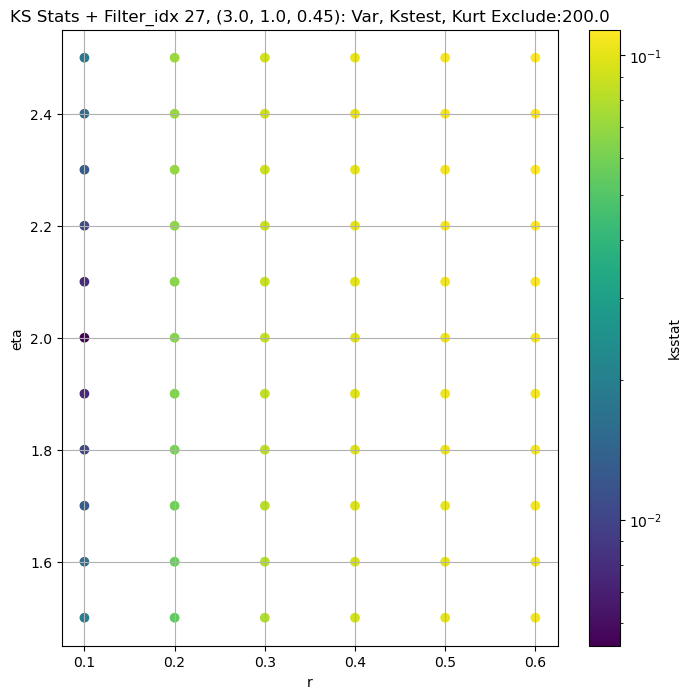

####
Filter_idx, 28: (4.0, 0.5, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 0 0.003615034935368855 20059.093307146166


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 50 0.0026367383201111386 18933.955153392704


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 100 0.001892442162550865 18279.126745343543


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 200 0.0025815706431830503 17345.725960100885
Number of samples: 100000, Without approximation : 136161000.0


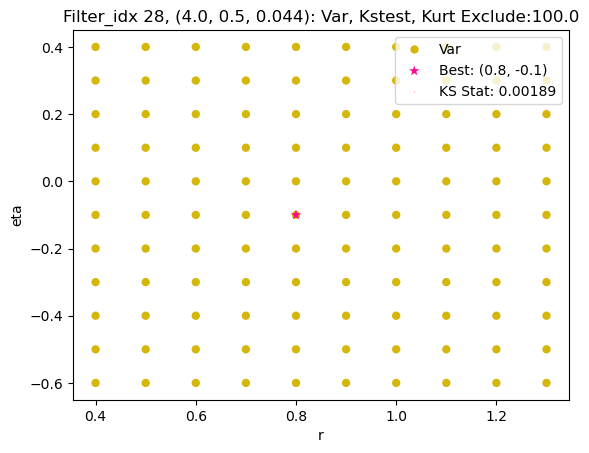

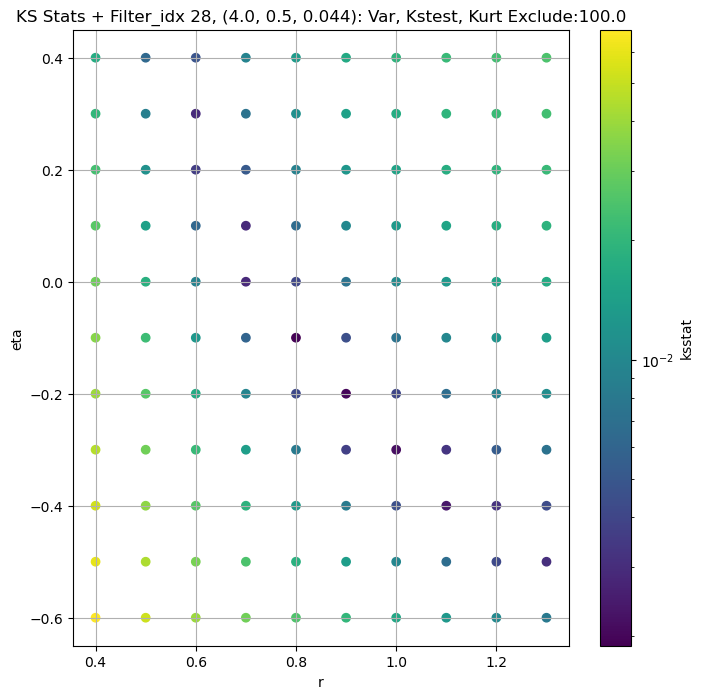

####
Filter_idx, 29: (4.0, 0.5, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 0 0.003077842230036709 6728.662667856983


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 50 0.0022241349845074643 6268.8327786850305


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 100 0.0019775636195172863 6014.935116677389


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 200 0.003106388165937557 5654.527726388245
Number of samples: 100000, Without approximation : 136161000.0


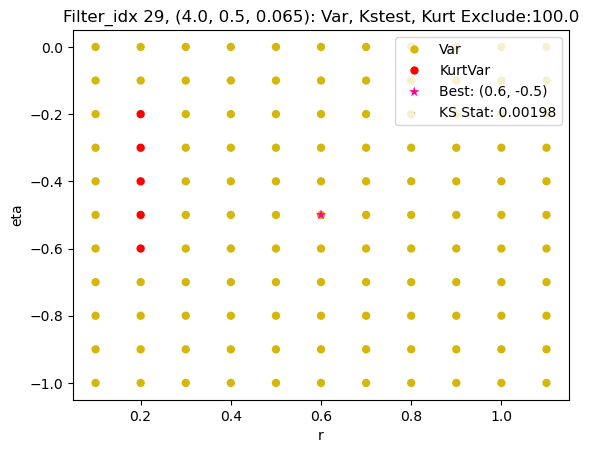

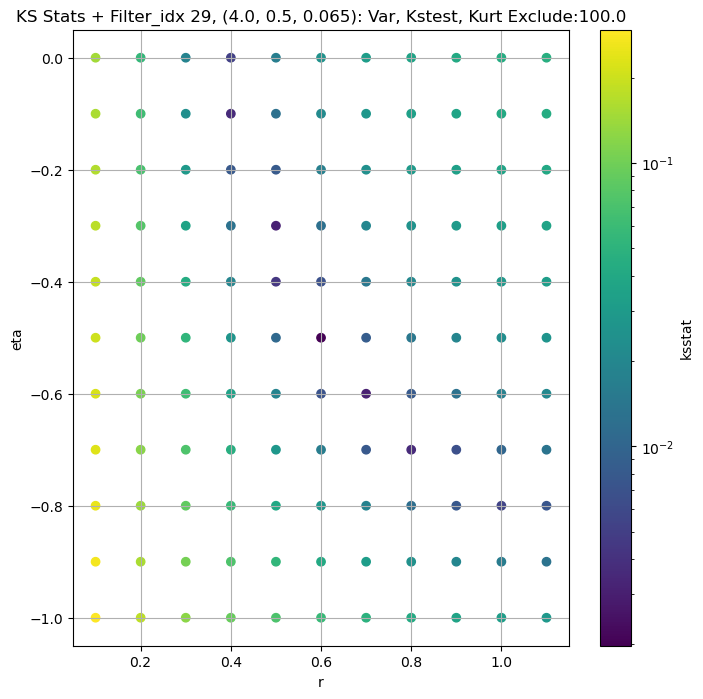

####
Filter_idx, 30: (4.0, 0.5, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 0 0.0021578318477368796 2174.2950657251185


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 50 0.002214613441293145 1962.9626100081314


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 100 0.0027708208404006174 1843.9887726024197


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 200 0.0038422284986281523 1683.0027287789976
Number of samples: 100000, Without approximation : 136161000.0


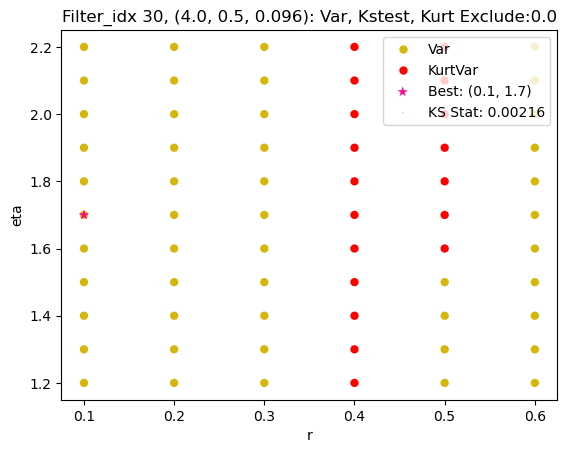

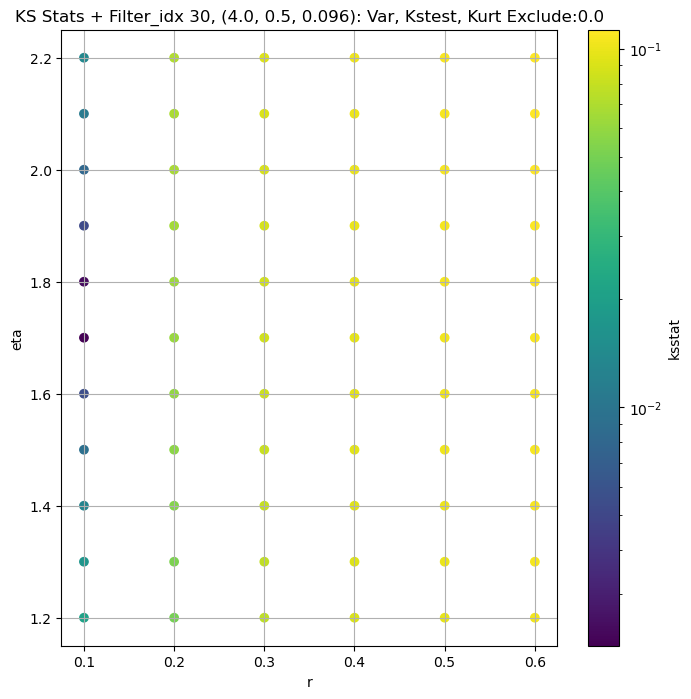

####
Filter_idx, 31: (4.0, 0.5, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 0 0.002759491058292679 440.2984572847581


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 50 0.0024308446475395235 380.0858256257585


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 100 0.0034691675784130904 353.7276937156897


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 200 0.004698617854215548 317.1630357467554
Number of samples: 100000, Without approximation : 136161000.0


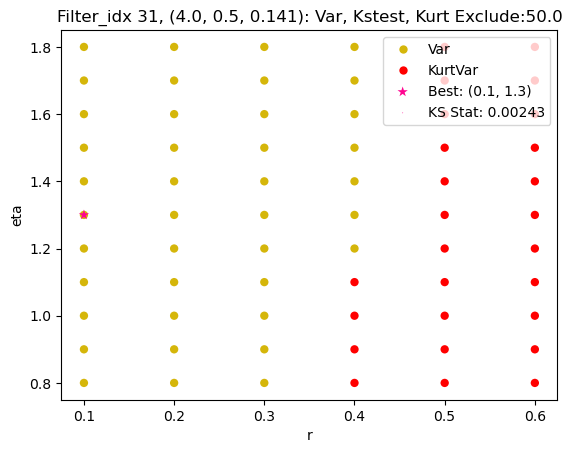

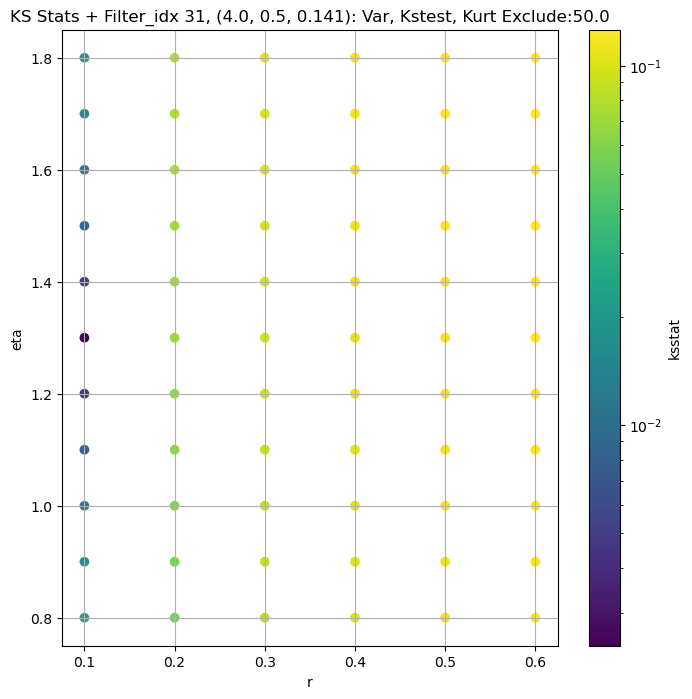

####
Filter_idx, 32: (4.0, 0.5, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 0 0.013542441812830874 53.90030877449569


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 50 0.006996537590373997 34.62221337648779


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 100 0.006352483322607183 31.509890171118233


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 200 0.005387810845288339 27.894820252588136
Number of samples: 100000, Without approximation : 136161000.0


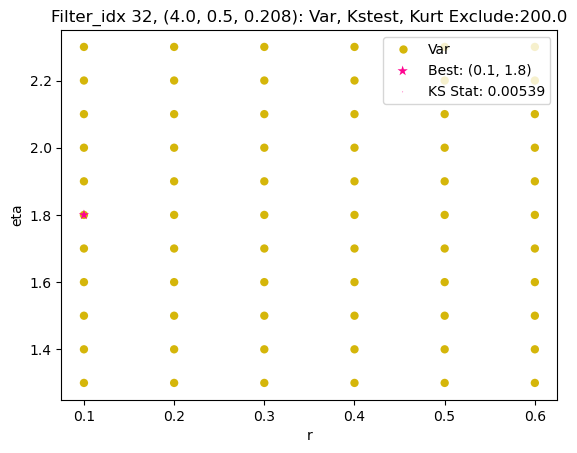

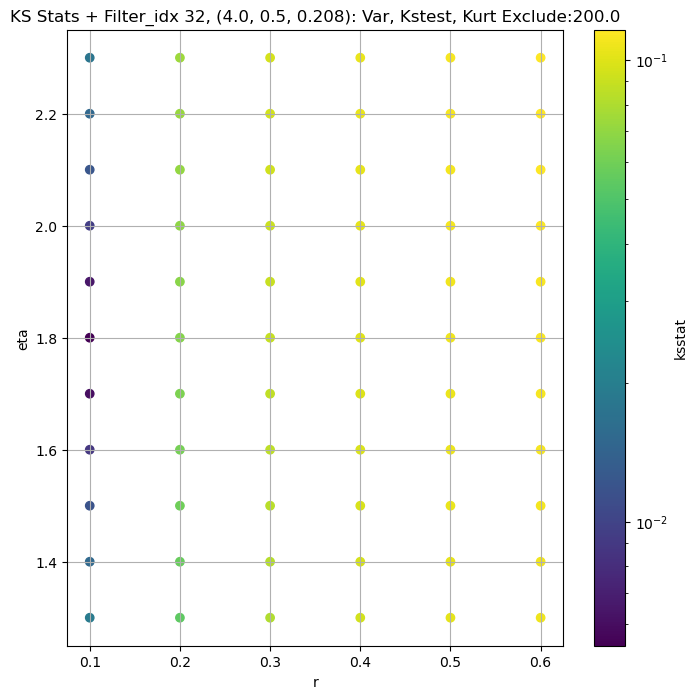

####
Filter_idx, 33: (4.0, 0.5, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 0 0.012162481292300242 18.555640428998874


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 50 0.007723072523009189 14.161260333859627


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 100 0.007107415413948992 13.187443044488834


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 200 0.00624631213531715 11.911849865569206
Number of samples: 100000, Without approximation : 136161000.0


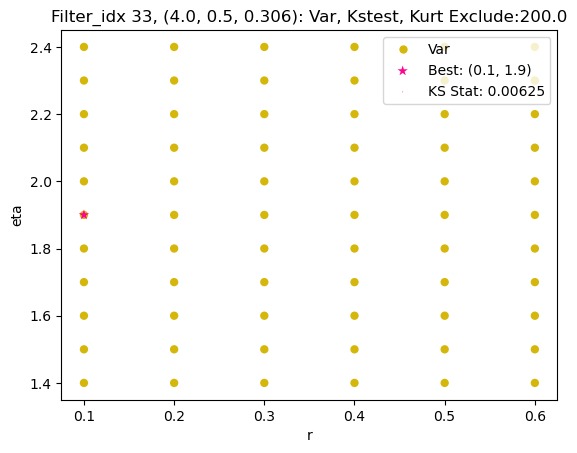

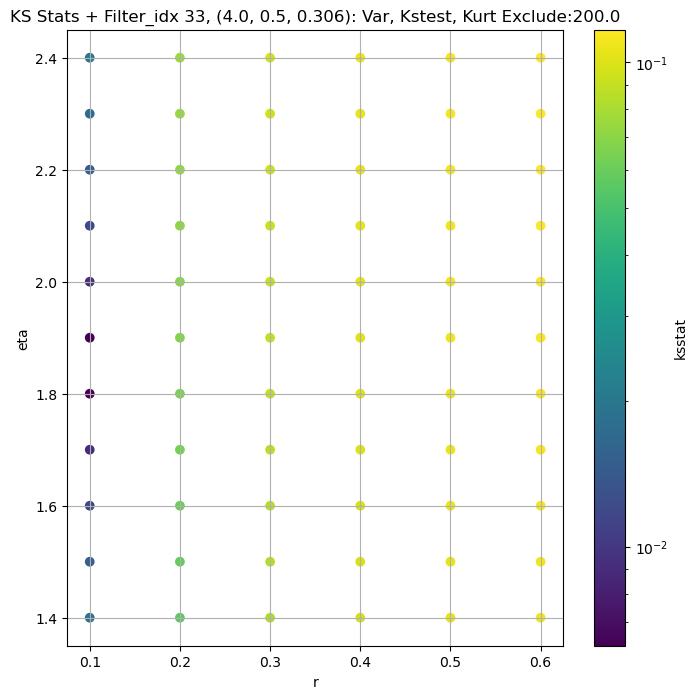

####
Filter_idx, 34: (4.0, 0.5, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 0 0.0075308922730099315 7.267771028444105


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 50 0.005689304376189974 6.643567308227021


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 100 0.005886229269378651 6.287698761238738


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 200 0.005121136399549208 5.7661535753618125
Number of samples: 100000, Without approximation : 136161000.0


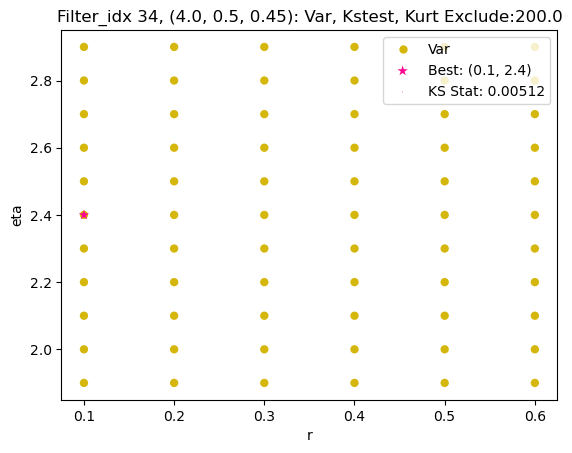

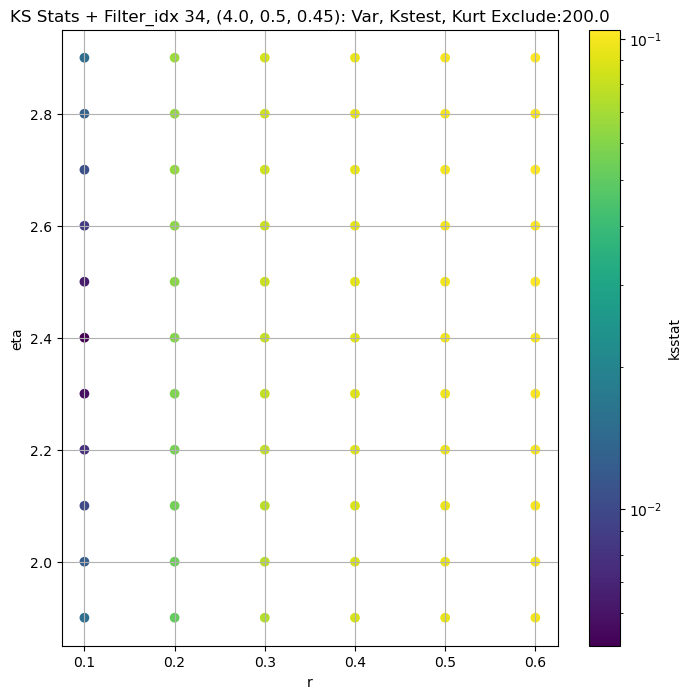

####
Filter_idx, 35: (4.0, 1.0, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 0 0.0029991285020034564 23481.683202374305


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 50 0.0011800033384401134 22327.32167794589


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 100 0.0017361383683936887 21629.303227488537


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 200 0.002739414163365983 20600.492824491823
Number of samples: 100000, Without approximation : 136161000.0


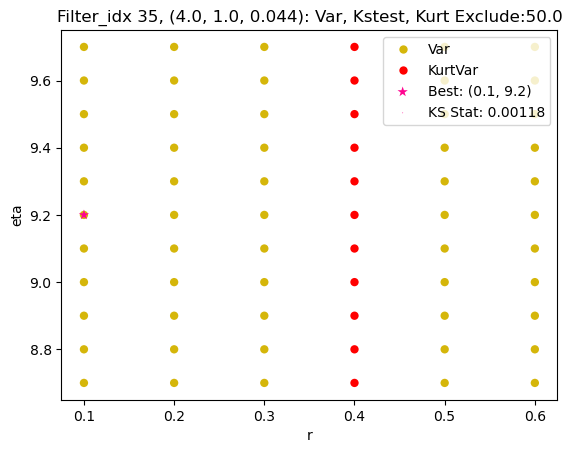

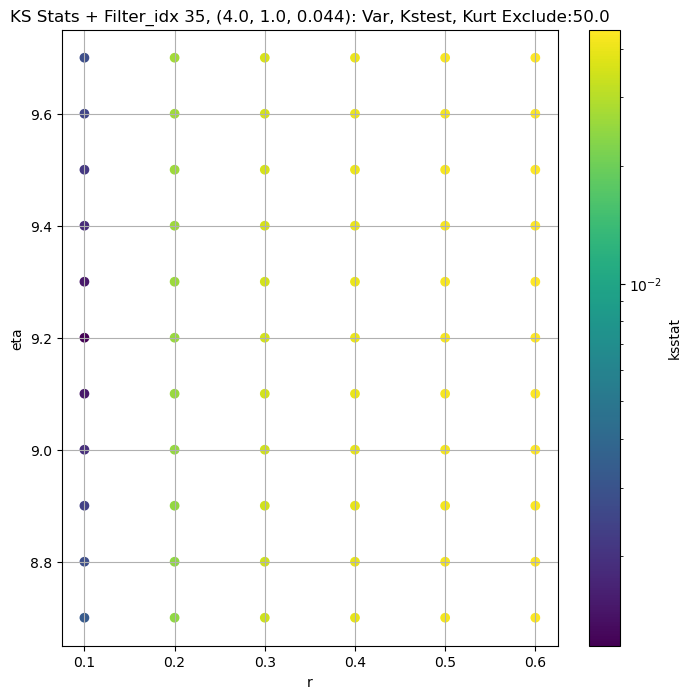

####
Filter_idx, 36: (4.0, 1.0, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 0 0.0020200257196622343 7210.980530068478


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 50 0.001252429157015289 6709.078412905789


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 100 0.002088449374189949 6447.449415991868


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 200 0.0029422079534755508 6080.4076162491765
Number of samples: 100000, Without approximation : 136161000.0


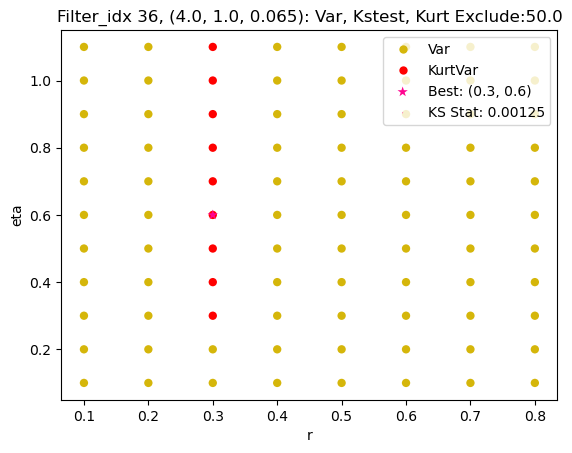

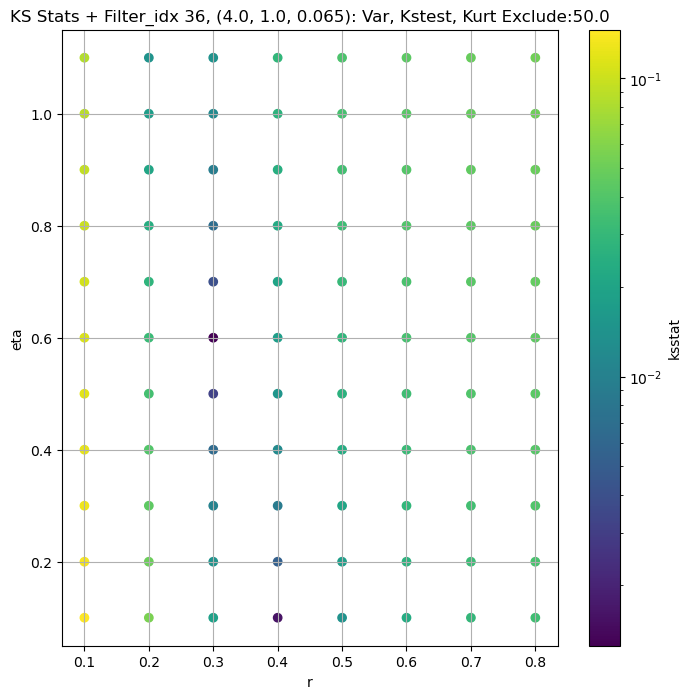

####
Filter_idx, 37: (4.0, 1.0, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 0 0.0017591333453639557 2145.196983360842


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 50 0.0016279891092130794 1909.8994342976696


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 100 0.0027126150531151527 1806.4077409944566


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 200 0.003861302465545391 1667.997772161081
Number of samples: 100000, Without approximation : 136161000.0


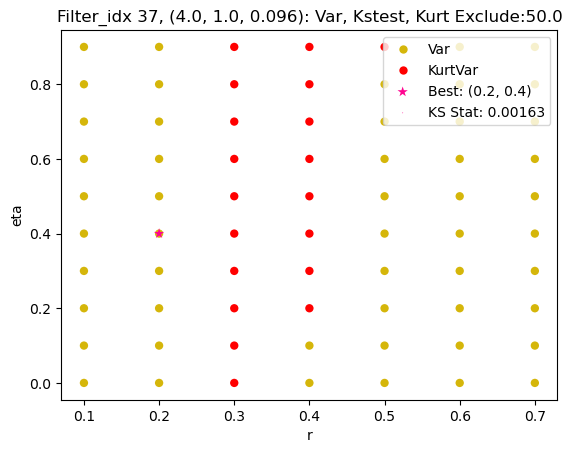

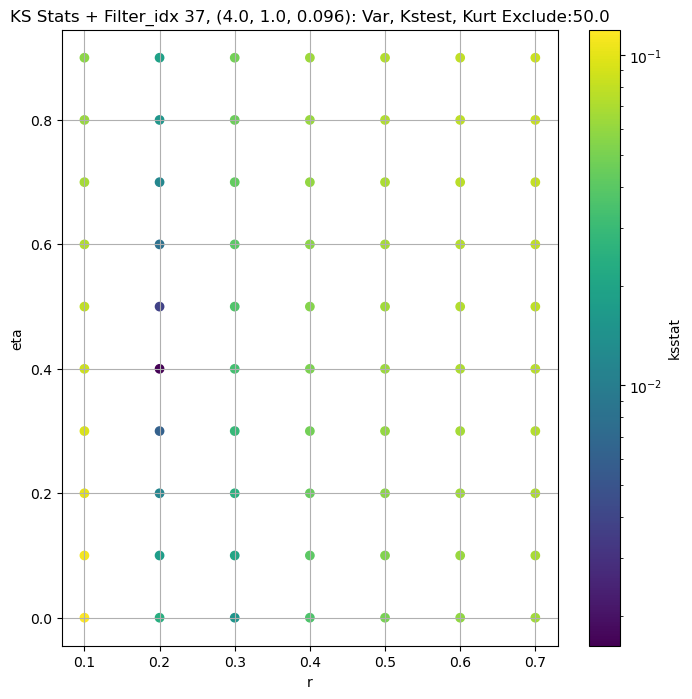

####
Filter_idx, 38: (4.0, 1.0, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 0 0.005741236728024179 497.9098207081813


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 50 0.0030520562812988983 421.48905785742835


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 100 0.002815134936297925 387.93697947406883


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 200 0.0041310929704374555 344.82599538036783
Number of samples: 100000, Without approximation : 136161000.0


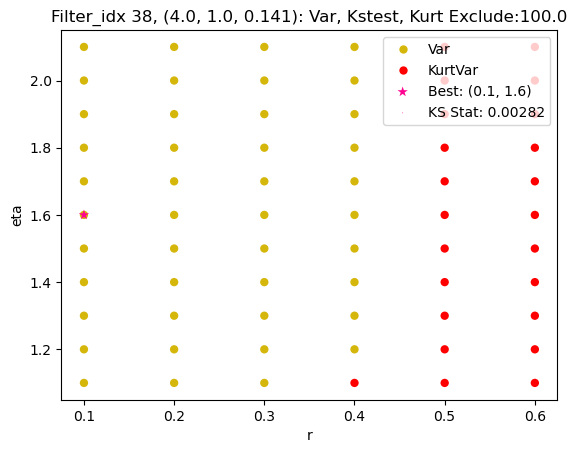

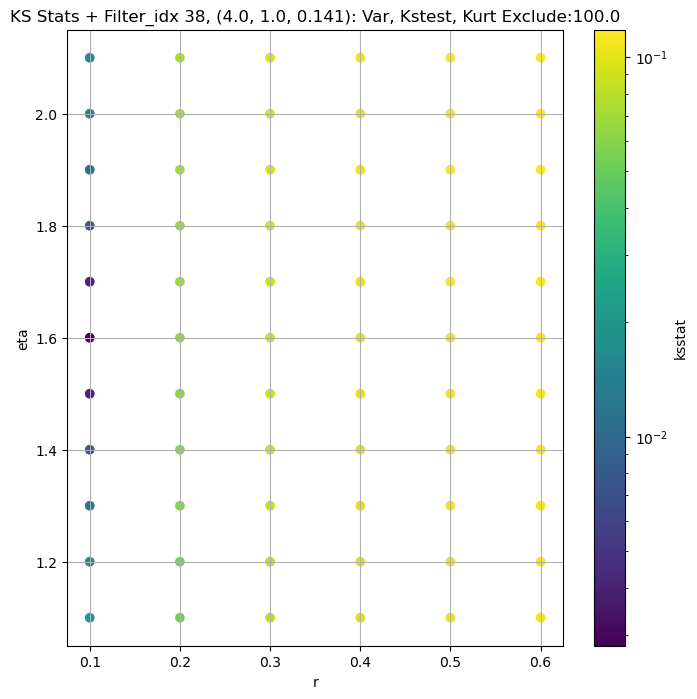

####
Filter_idx, 39: (4.0, 1.0, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 0 0.013881039205540124 64.54988828385838


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 50 0.007037793105362344 43.27256871704831


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 100 0.005388734443532328 39.03789091667893


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 200 0.004645276724031561 34.119987986094436
Number of samples: 100000, Without approximation : 136161000.0


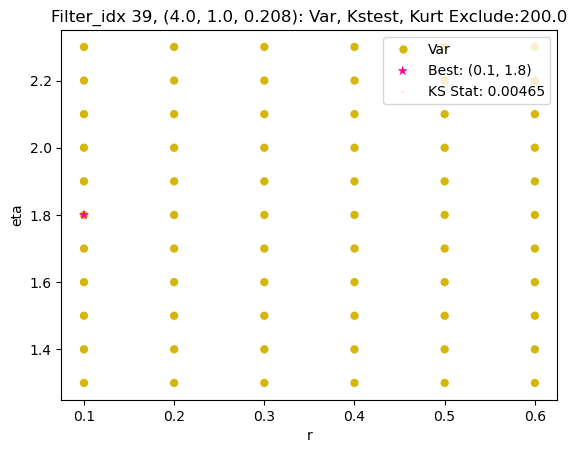

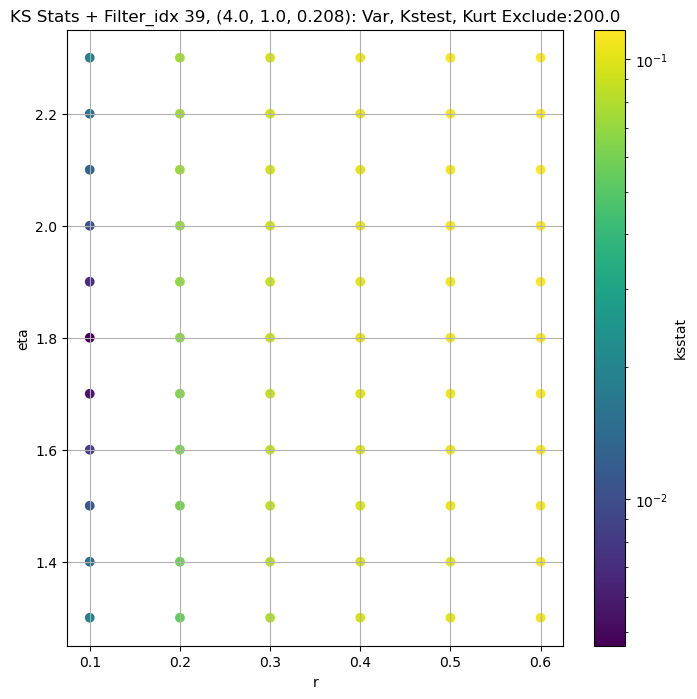

####
Filter_idx, 40: (4.0, 1.0, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 0 0.020724242746034294 20.590749797957255


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 50 0.013839341053535459 14.556407129320249


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 100 0.013400281415188314 13.103297868830493


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 200 0.010447474252082811 11.381341138066013
Number of samples: 100000, Without approximation : 136161000.0


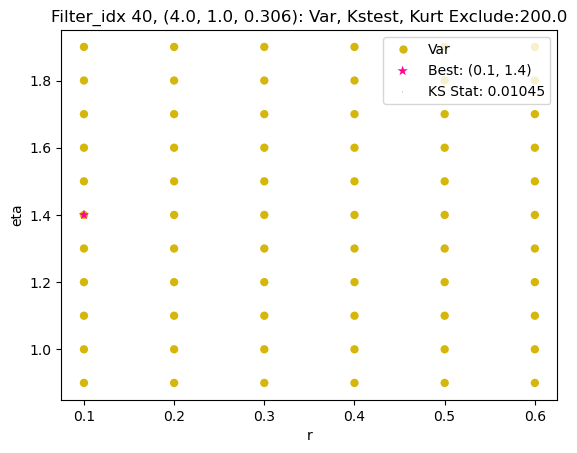

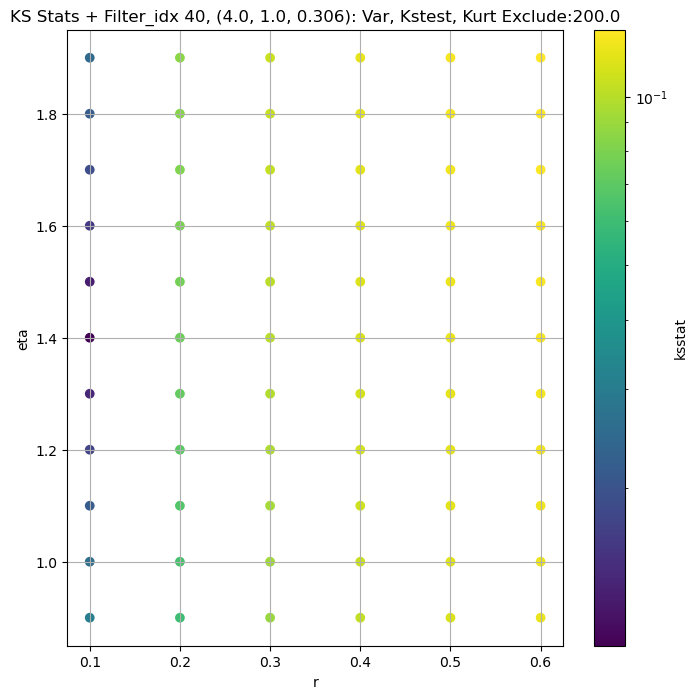

####
Filter_idx, 41: (4.0, 1.0, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 0 0.020126948230909936 7.511645771305659


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 50 0.01804923462365232 6.476932268721826


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 100 0.016522048867594674 5.897408554747421


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 200 0.014575116942923017 5.113788967259275
Number of samples: 100000, Without approximation : 136161000.0


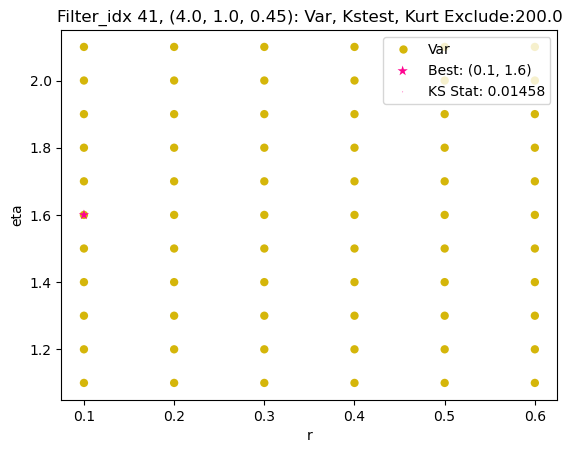

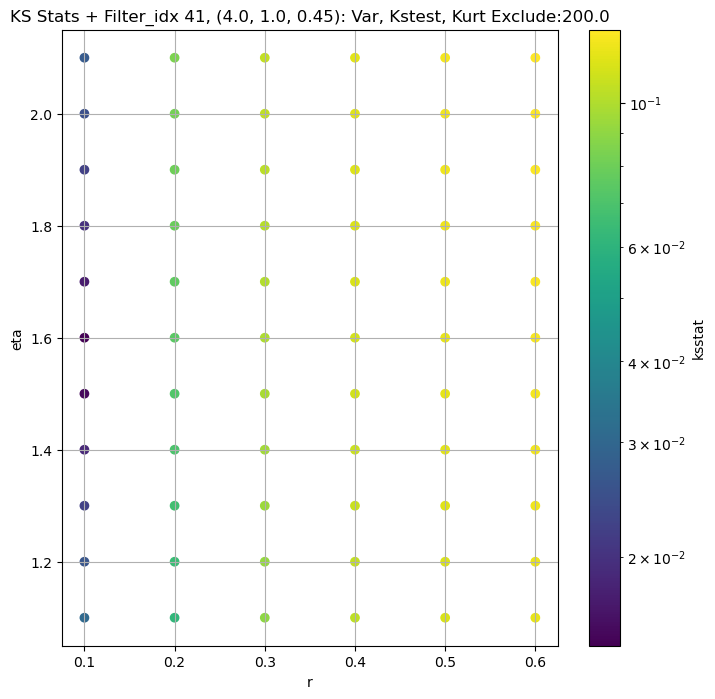

,params,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,initial_r,initial_eta,initial_scale,initial_exclude_cutoff,best_augmented_var,kstest_stat_cutoff_0.05
filter_idx,,,,,,,,,,,,,,,,
0,"(2.0, 0.5, 0.044)",24111.888294,19052.401645,30447.957447,5.579921,2.075283,14.192461,136161000.0,"(2.0, 0.5, 0.044)",0.003550,1.1,-0.4,2.205116e+04,200.0,21277.435527,0.000116
1,"(2.0, 0.5, 0.065)",11877.167756,8706.483888,16085.379803,10.964418,5.169127,17.980163,136161000.0,"(2.0, 0.5, 0.065)",0.005938,0.5,-0.5,1.653819e+03,200.0,9922.915132,0.000116
2,"(2.0, 0.5, 0.096)",4272.713551,3134.622665,5762.139707,12.807588,6.852190,22.106602,136161000.0,"(2.0, 0.5, 0.096)",0.004213,0.3,-0.3,1.565653e+01,200.0,3536.984505,0.000116
3,"(2.0, 0.5, 0.141)",1078.932665,776.505441,1487.405395,14.176789,6.576698,46.788592,136161000.0,"(2.0, 0.5, 0.141)",0.004014,0.2,0.0,1.375636e-02,50.0,1005.991668,0.000116
4,"(2.0, 0.5, 0.208)",218.209237,150.523220,373.627688,26.427271,6.846993,183.210028,136161000.0,"(2.0, 0.5, 0.208)",0.003010,0.1,1.4,1.272019e-13,0.0,218.209237,0.000116
5,"(2.0, 0.5, 0.306)",39.820943,25.610523,77.371432,48.922184,6.457623,273.277159,136161000.0,"(2.0, 0.5, 0.306)",0.003506,0.1,1.3,3.150340e-14,0.0,39.820943,0.000116
6,"(2.0, 0.5, 0.45)",19.318296,12.843038,45.810489,58.404167,6.968506,329.241909,136161000.0,"(2.0, 0.5, 0.45)",0.003977,0.1,1.7,4.103220e-15,50.0,16.692907,0.000116
7,"(2.0, 1.0, 0.044)",29661.968209,24103.130769,37590.664964,5.471542,1.646046,19.096018,136161000.0,"(2.0, 1.0, 0.044)",0.001471,0.5,0.7,1.186923e+03,50.0,28201.286850,0.000116
8,"(2.0, 1.0, 0.065)",14517.113438,10519.183070,19456.750483,12.431846,4.327867,26.223462,136161000.0,"(2.0, 1.0, 0.065)",0.004106,0.5,-0.1,1.117933e+03,200.0,11894.810946,0.000116


In [27]:
master_df_combo_path = Path(os.path.join(CWD, "CSVs", "master_df_combo.csv"))
rEtaKsstats_dict_path = Path(os.path.join(CWD, "cache", "rEtaKsstats_dict.pickle"))

rEtaKsstats_dict = dict()

if RERUN or not master_df_combo_path.exists():
    sorted_params = sorted(all_cdfs)
    ksstats_dict = dict()

    for i, group in enumerate(GROUPS): # TODO For quick testing purposes
        print(f"####\n{GROUP.capitalize()}, {group}: {str(filter_group_map[group])}")
        sample = group_data_map[group]
        if len(sample) == 0:
            continue
        group_cdfs_df = all_cdfs_df.copy()
        master_df.loc[group, 'kstest_stat_initial'] = 1

        for j in range(len(EXCLUDE_CUTOFFS)):

            exclude_cutoff = EXCLUDE_CUTOFFS[j]
            exclude_cutoff = int(exclude_cutoff)

            if exclude_cutoff == 0:
                augmented_var = np.var(group_data_map[group]) 
            else:
                augmented_var = np.var(group_data_map[group][exclude_cutoff:-exclude_cutoff])
                if augmented_var == np.var(group_data_map[group]):
                    continue 
                
            group_cdfs_df['scale'] = np.clip((augmented_var / group_cdfs_df['variance']), 0,  SCALE_CAP)
            ksstats, initial_param, min_stat = gridsearch(sample, all_cdfs, debug=True, scales=group_cdfs_df['scale'])
            augmented_var_df.loc[group, f"kstest_stat_{exclude_cutoff}"] = min_stat
            group_cdfs_df[f'ksstat_exclude_{exclude_cutoff}'] = ksstats
            
            print(group, exclude_cutoff, min_stat, augmented_var)
            
            if (min_stat < master_df.loc[group, 'kstest_stat_initial']) and not np.isclose(min_stat, master_df.loc[group, 'kstest_stat_initial'], 1e-6):
                inital_min_stat = min_stat
                inital_best_param = initial_param
                master_df.loc[group, 'kstest_stat_initial'] = min_stat
                initial_scale = group_cdfs_df.loc[(group_cdfs_df["r"] ==  initial_param[0]) & (group_cdfs_df["eta"] ==  initial_param[1])]["scale"].iloc[0]
                master_df.loc[group, 'initial_r'], master_df.loc[group, 'initial_eta'] = initial_param
                master_df.loc[group, 'initial_scale'] = initial_scale
                master_df.loc[group, 'initial_exclude_cutoff'] = exclude_cutoff
                master_df.loc[group, 'best_augmented_var'] = augmented_var
        
        ksstats = group_cdfs_df[f"ksstat_exclude_{int(master_df.loc[group, 'initial_exclude_cutoff'])}"]
            
        print(f"Number of samples: {sample.size}, Without approximation : {master_df.loc[group, 'total_samples']}")
        
        cutoff = stats.kstwo(n=master_df.loc[group, 'total_samples']).isf(0.05)
        master_df.loc[group, 'kstest_stat_cutoff_0.05'] = cutoff

        best_scales = np.clip((master_df.loc[group, 'best_augmented_var'] / group_cdfs_df['variance']), 0,  SCALE_CAP)

        group_cdfs_df['variance'] = group_cdfs_df['variance'] * best_scales
        group_cdfs_df['kurtosis'] = group_cdfs_df['kurtosis'] * best_scales

        group_cdfs_df = add_tests_to_df(cdfs_df = group_cdfs_df, group = group, var_kurt_df = master_df, ksstats = ksstats).sort_values(['r', 'eta'])

        group_dict = {'r' : group_cdfs_df['r'], 'eta' : group_cdfs_df['eta']}
        group_dict.update({f'ksstat_exclude_{exclude_cutoff}' : group_cdfs_df[f'ksstat_exclude_{exclude_cutoff}'] for exclude_cutoff in EXCLUDE_CUTOFFS[:j+1]})
        rEtaKsstats_dict[group] = group_dict

        cols = ['pass_var', 'pass_kstest', 'pass_kurt']

        fig = combo_test_plot(group_cdfs_df, cols, 
                            plot_name=f"{GROUP.capitalize()} {group}, {str(filter_group_map[group])}: {', '.join([col[5:].capitalize() for col in cols])} Exclude:{master_df.loc[group, 'initial_exclude_cutoff']}", 
                            target_var = None,
                            best_param = inital_best_param,
                            best_ksstat=inital_min_stat
                            )
        
        fig.figure.savefig(os.path.join(CWD, "plots", f"full_grid_search_combo_plot_layer{group}.jpg"), bbox_inches = 'tight', dpi=100)

        # Optional: 
        # Create plots of bootstrapped variance and kurtosis for varying confidence intervals
        # fig_var = create_ci_scatter_plot(group_cdfs_df, var_values_dict, metric='variance', group=group)
        # fig_kurt = create_ci_scatter_plot(group_cdfs_df, kurt_values_dict, metric='kurtosis', group=group)

        # fig_var.savefig(os.path.join(CWD, "plots", f"ci_scatter_variance_{GROUP}_{group}_bootstrap{n_bootstrap}.jpg"), bbox_inches='tight')
        # plt.close(fig_var)
        # fig_kurt.savefig(os.path.join(CWD, "plots", f"ci_scatter_variance_{GROUP}_{group}_bootstrap{n_bootstrap}.jpg"), bbox_inches='tight')
        # plt.close(fig_kurt)

    # new: add parameter information
    master_df.insert(0, 'params', master_df.index.map(filter_group_map))

    master_df.to_csv(master_df_combo_path)
    pd.to_pickle(rEtaKsstats_dict, rEtaKsstats_dict_path)
    augmented_var_df.to_csv(augmented_var_df_path)

augmented_var_df = pd.read_csv(augmented_var_df_path, index_col=GROUP)
master_df = pd.read_csv(master_df_combo_path, index_col=GROUP)
rEtaKsstats_dict = pd.read_pickle(rEtaKsstats_dict_path)
master_df

## Optimization

In [28]:
master_df['kstest_stat_best'] = master_df['kstest_stat_initial']
master_df[f'best_r'] = master_df['initial_r']
master_df[f'best_eta'] = master_df['initial_eta']
master_df[f'best_scale'] = master_df['initial_scale']
master_df[f'best_exclude_cutoff'] = master_df['initial_exclude_cutoff']

Filter_idx 0, (2.0, 0.5, 0.044):


  0%|          | 0/1620 [00:00<?, ?it/s]

Finding Minimum after computing 1620 CDFs
filter_idx 0, 200.0 + 100 = 300, ksstat: 0.004205025563956077, var: 20459.373260968056


  0%|          | 0/1620 [00:00<?, ?it/s]

Finding Minimum after computing 1620 CDFs
filter_idx 0, 200.0 + 75 = 275, ksstat: 0.004020027565354356, var: 20650.608402947702


  0%|          | 0/1620 [00:00<?, ?it/s]

Finding Minimum after computing 1620 CDFs
filter_idx 0, 200.0 + 50 = 250, ksstat: 0.003831763666439447, var: 20850.042105087807


  0%|          | 0/1620 [00:00<?, ?it/s]

Finding Minimum after computing 1620 CDFs
filter_idx 0, 200.0 + 25 = 225, ksstat: 0.0036187108985277217, var: 21058.553618313756


  0%|          | 0/1620 [00:00<?, ?it/s]

Finding Minimum after computing 1620 CDFs
filter_idx 0, 200.0 + 0 = 200, ksstat: 0.003456595819099256, var: 21277.435526621284


  0%|          | 0/1620 [00:00<?, ?it/s]

Finding Minimum after computing 1620 CDFs
filter_idx 0, 200.0 + -25 = 175, ksstat: 0.0032671851923303883, var: 21508.377456333496


  0%|          | 0/1620 [00:00<?, ?it/s]

Finding Minimum after computing 1620 CDFs
filter_idx 0, 200.0 + -50 = 150, ksstat: 0.003074737445495558, var: 21753.624591245698


  0%|          | 0/1620 [00:00<?, ?it/s]

Finding Minimum after computing 1620 CDFs
filter_idx 0, 200.0 + -75 = 125, ksstat: 0.0029448825036880732, var: 22016.318735981517


  0%|          | 0/1620 [00:00<?, ?it/s]

Finding Minimum after computing 1620 CDFs
filter_idx 0, 200.0 + -100 = 100, ksstat: 0.003137495870852103, var: 22301.1704686491
Number of samples: 100000, Without approximation : 136161000.0


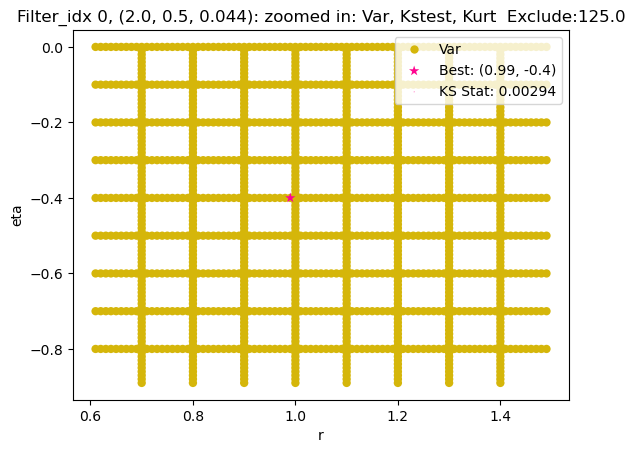

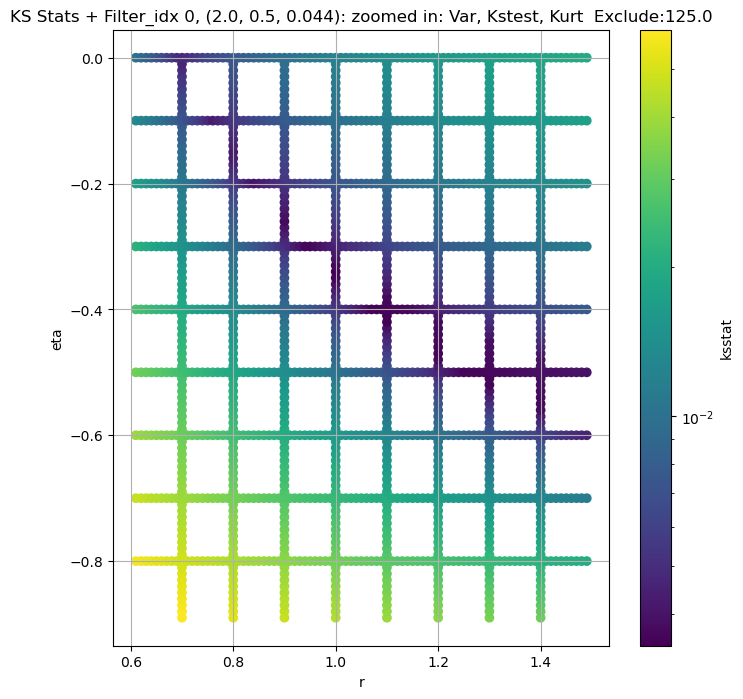

Filter_idx 1, (2.0, 0.5, 0.065):


  0%|          | 0/1692 [00:00<?, ?it/s]

Finding Minimum after computing 1692 CDFs
filter_idx 1, 200.0 + 100 = 300, ksstat: 0.005066662902893243, var: 9336.01177178132


  0%|          | 0/1692 [00:00<?, ?it/s]

Finding Minimum after computing 1692 CDFs
filter_idx 1, 200.0 + 75 = 275, ksstat: 0.004859772943422765, var: 9471.708196131312


  0%|          | 0/1692 [00:00<?, ?it/s]

Finding Minimum after computing 1692 CDFs
filter_idx 1, 200.0 + 50 = 250, ksstat: 0.0046209750508275915, var: 9614.094248288593


  0%|          | 0/1692 [00:00<?, ?it/s]

Finding Minimum after computing 1692 CDFs
filter_idx 1, 200.0 + 25 = 225, ksstat: 0.004414104444471323, var: 9764.085897328547


  0%|          | 0/1692 [00:00<?, ?it/s]

Finding Minimum after computing 1692 CDFs
filter_idx 1, 200.0 + 0 = 200, ksstat: 0.004640802996705551, var: 9922.915131540687


  0%|          | 0/1692 [00:00<?, ?it/s]

Finding Minimum after computing 1692 CDFs
filter_idx 1, 200.0 + -25 = 175, ksstat: 0.00459558417513839, var: 10092.157247983867


  0%|          | 0/1692 [00:00<?, ?it/s]

Finding Minimum after computing 1692 CDFs
filter_idx 1, 200.0 + -50 = 150, ksstat: 0.004760212317339141, var: 10273.719569528344


  0%|          | 0/1692 [00:00<?, ?it/s]

Finding Minimum after computing 1692 CDFs
filter_idx 1, 200.0 + -75 = 125, ksstat: 0.004973086405000049, var: 10470.046846940668


  0%|          | 0/1692 [00:00<?, ?it/s]

Finding Minimum after computing 1692 CDFs
filter_idx 1, 200.0 + -100 = 100, ksstat: 0.005201980492521852, var: 10684.442325994956
Number of samples: 100000, Without approximation : 136161000.0


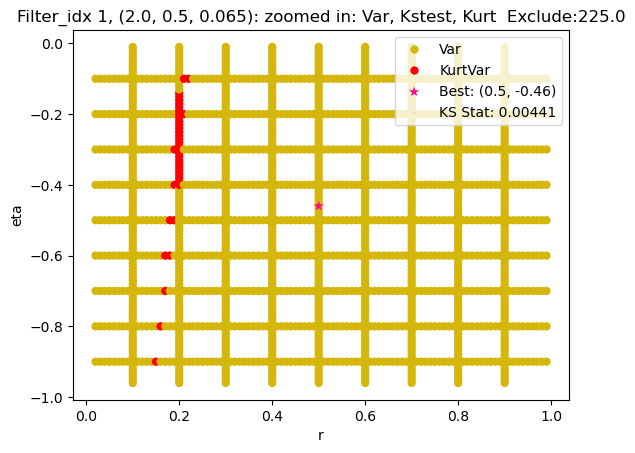

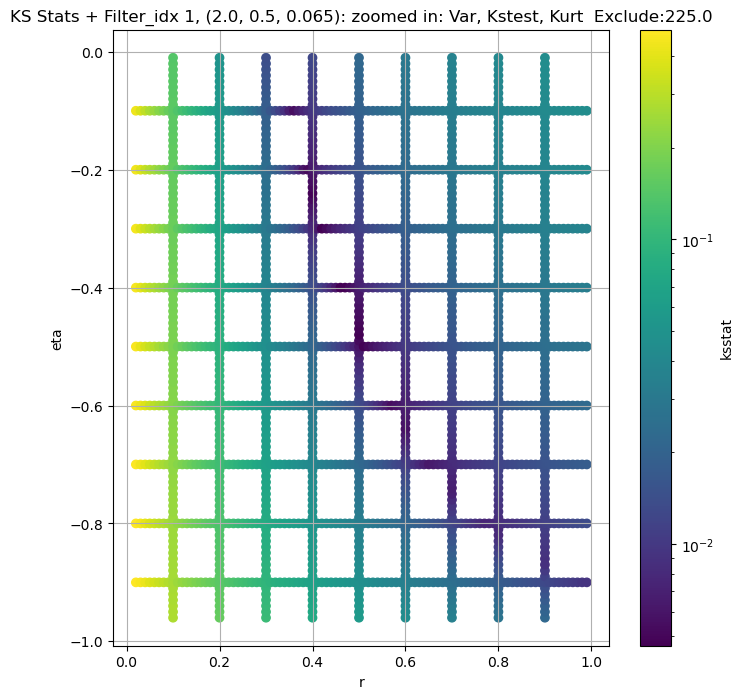

Filter_idx 2, (2.0, 0.5, 0.096):


  0%|          | 0/1206 [00:00<?, ?it/s]

Finding Minimum after computing 1206 CDFs
filter_idx 2, 200.0 + 100 = 300, ksstat: 0.00519477455950729, var: 3302.146478537129


  0%|          | 0/1206 [00:00<?, ?it/s]

Finding Minimum after computing 1206 CDFs
filter_idx 2, 200.0 + 75 = 275, ksstat: 0.004963687452332496, var: 3356.7435791759076


  0%|          | 0/1206 [00:00<?, ?it/s]

Finding Minimum after computing 1206 CDFs
filter_idx 2, 200.0 + 50 = 250, ksstat: 0.004709006728684129, var: 3413.8922603544192


  0%|          | 0/1206 [00:00<?, ?it/s]

Finding Minimum after computing 1206 CDFs
filter_idx 2, 200.0 + 25 = 225, ksstat: 0.004475347096012444, var: 3473.865264473441


  0%|          | 0/1206 [00:00<?, ?it/s]

Finding Minimum after computing 1206 CDFs
filter_idx 2, 200.0 + 0 = 200, ksstat: 0.004212738145676676, var: 3536.9845046889614


  0%|          | 0/1206 [00:00<?, ?it/s]

Finding Minimum after computing 1206 CDFs
filter_idx 2, 200.0 + -25 = 175, ksstat: 0.003965931307059398, var: 3603.6772169040287


  0%|          | 0/1206 [00:00<?, ?it/s]

Finding Minimum after computing 1206 CDFs
filter_idx 2, 200.0 + -50 = 150, ksstat: 0.004017369795772829, var: 3674.4917632283928


  0%|          | 0/1206 [00:00<?, ?it/s]

Finding Minimum after computing 1206 CDFs
filter_idx 2, 200.0 + -75 = 125, ksstat: 0.004242218205021575, var: 3750.1522313102196


  0%|          | 0/1206 [00:00<?, ?it/s]

Finding Minimum after computing 1206 CDFs
filter_idx 2, 200.0 + -100 = 100, ksstat: 0.004336222619808483, var: 3831.6110389950013
Number of samples: 100000, Without approximation : 136161000.0


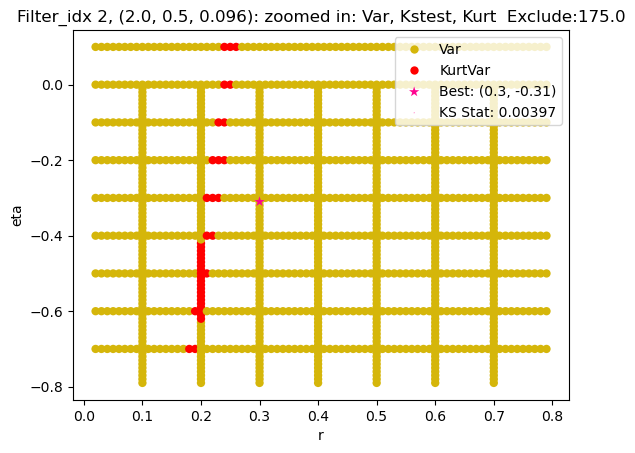

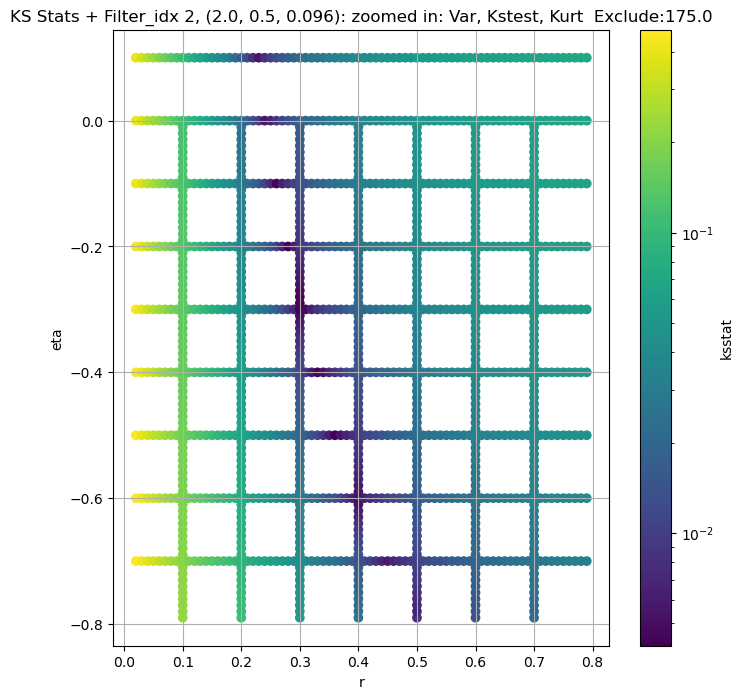

Filter_idx 3, (2.0, 0.5, 0.141):


  0%|          | 0/936 [00:00<?, ?it/s]

Finding Minimum after computing 936 CDFs
filter_idx 3, 50.0 + 100 = 150, ksstat: 0.0038847414422254565, var: 920.7470804886823


  0%|          | 0/936 [00:00<?, ?it/s]

Finding Minimum after computing 936 CDFs
filter_idx 3, 50.0 + 75 = 125, ksstat: 0.003526960223863859, var: 939.2907432551765


  0%|          | 0/936 [00:00<?, ?it/s]

Finding Minimum after computing 936 CDFs
filter_idx 3, 50.0 + 50 = 100, ksstat: 0.0031666670286820617, var: 959.3620845259892


  0%|          | 0/936 [00:00<?, ?it/s]

Finding Minimum after computing 936 CDFs
filter_idx 3, 50.0 + 25 = 75, ksstat: 0.003105802741383168, var: 981.365348244843


  0%|          | 0/936 [00:00<?, ?it/s]

Finding Minimum after computing 936 CDFs
filter_idx 3, 50.0 + 0 = 50, ksstat: 0.0030711275293058282, var: 1005.9916682214986


  0%|          | 0/936 [00:00<?, ?it/s]

Finding Minimum after computing 936 CDFs
filter_idx 3, 50.0 + -25 = 25, ksstat: 0.002769737353469859, var: 1034.6410041726742


  0%|          | 0/936 [00:00<?, ?it/s]

Finding Minimum after computing 936 CDFs
filter_idx 3, 50.0 + -50 = 0, ksstat: 0.003108323044699879, var: 1078.9326645583983
Number of samples: 100000, Without approximation : 136161000.0


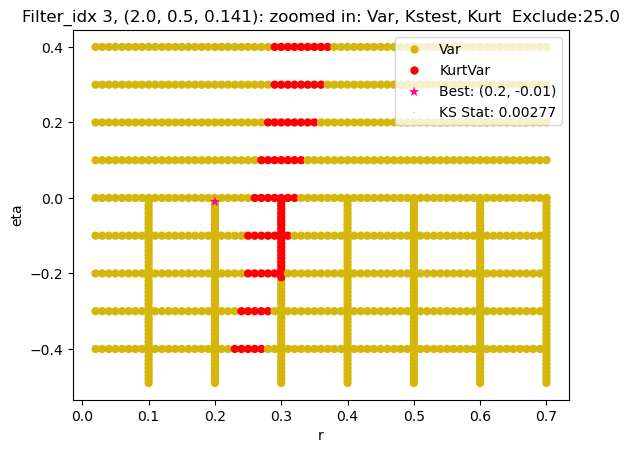

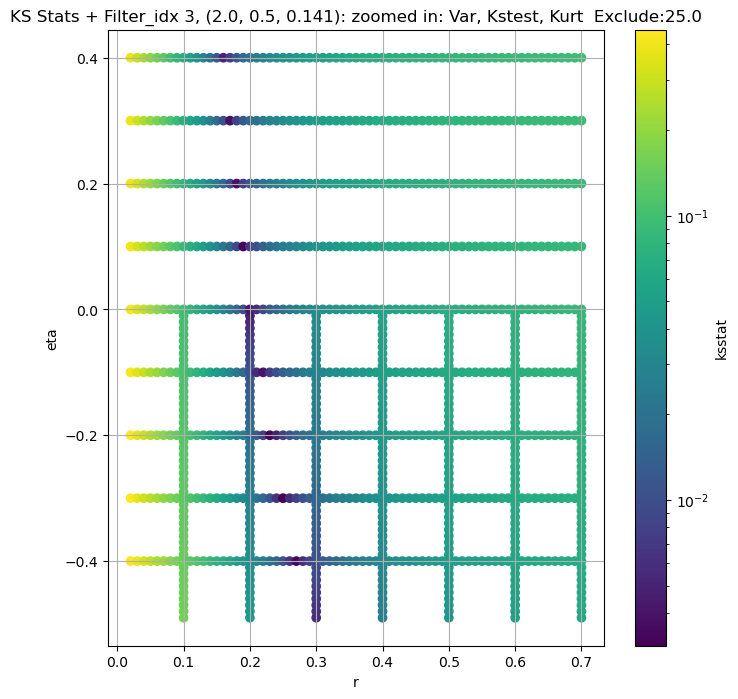

Filter_idx 4, (2.0, 0.5, 0.208):


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 4, 0.0 + 100 = 100, ksstat: 0.005837122424355634, var: 187.4511438558966


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 4, 0.0 + 75 = 75, ksstat: 0.004926630426760031, var: 191.80494162325218


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 4, 0.0 + 50 = 50, ksstat: 0.00485845263119275, var: 196.80399833051038


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 4, 0.0 + 25 = 25, ksstat: 0.0037777822602063083, var: 202.96388736305278


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 4, 0.0 + 0 = 0, ksstat: 0.002551676352976179, var: 218.2092374296753
Number of samples: 100000, Without approximation : 136161000.0


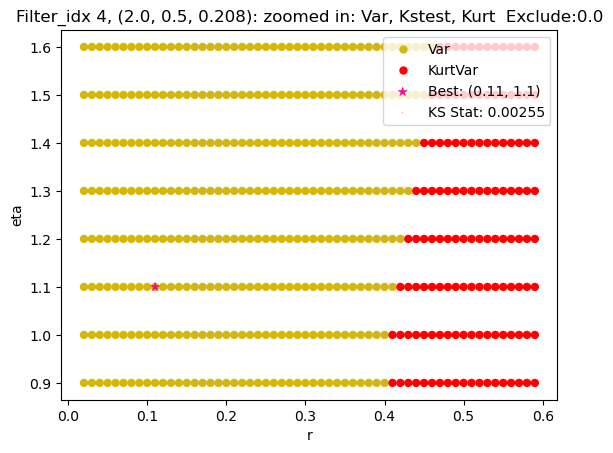

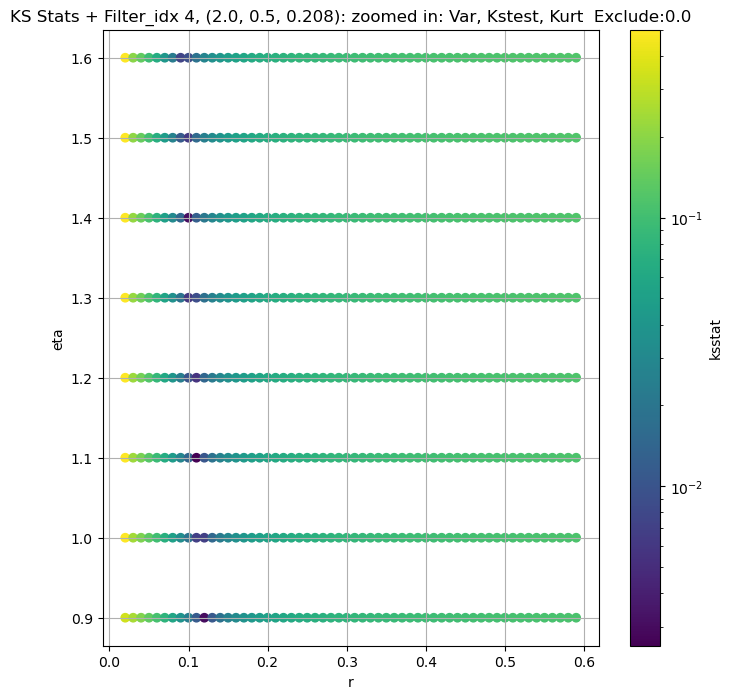

Filter_idx 5, (2.0, 0.5, 0.306):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 5, 0.0 + 100 = 100, ksstat: 0.005148852782534408, var: 32.49534692832357


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 5, 0.0 + 75 = 75, ksstat: 0.004541888827173844, var: 33.354323433680094


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 5, 0.0 + 50 = 50, ksstat: 0.0040306617418230314, var: 34.37333602024878


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 5, 0.0 + 25 = 25, ksstat: 0.003202378062988738, var: 35.7230583674437


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 5, 0.0 + 0 = 0, ksstat: 0.002876085805678774, var: 39.82094326182208
Number of samples: 100000, Without approximation : 136161000.0


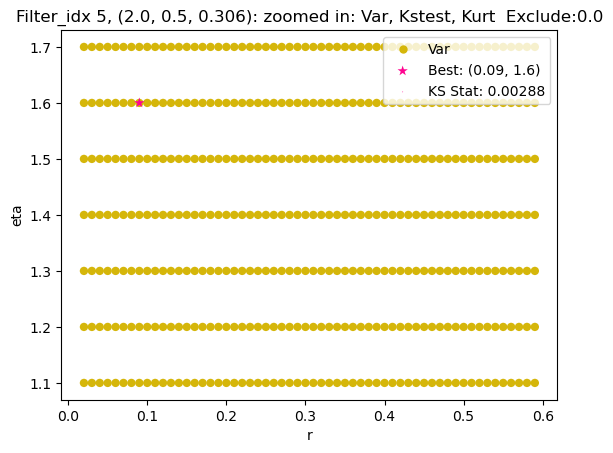

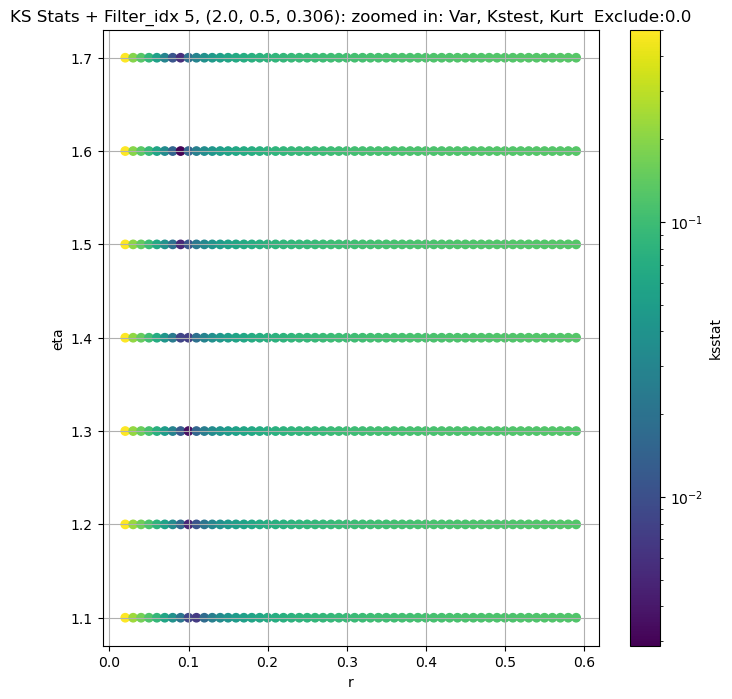

Filter_idx 6, (2.0, 0.5, 0.45):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 6, 50.0 + 100 = 150, ksstat: 0.006184981614515084, var: 15.143894626180494


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 6, 50.0 + 75 = 125, ksstat: 0.005443847643338384, var: 15.467403287079511


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 6, 50.0 + 50 = 100, ksstat: 0.005130871473064014, var: 15.823713626211138


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 6, 50.0 + 25 = 75, ksstat: 0.004704216790950386, var: 16.224346768465676


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 6, 50.0 + 0 = 50, ksstat: 0.0039770711013839, var: 16.692907301983734


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 6, 50.0 + -25 = 25, ksstat: 0.003890000611464328, var: 17.29808580838844


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 6, 50.0 + -50 = 0, ksstat: 0.005433290370587929, var: 19.318296415708957
Number of samples: 100000, Without approximation : 136161000.0


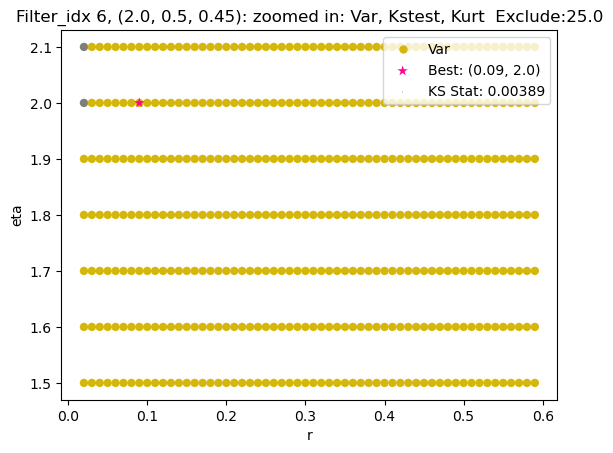

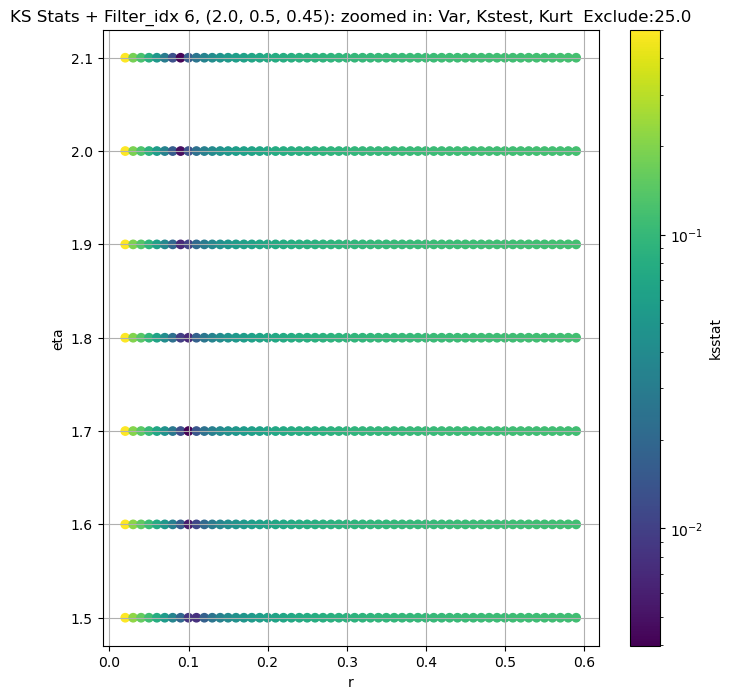

Filter_idx 7, (2.0, 1.0, 0.044):


  0%|          | 0/980 [00:00<?, ?it/s]

Finding Minimum after computing 980 CDFs
filter_idx 7, 50.0 + 100 = 150, ksstat: 0.0019994434580188347, var: 26665.578172323974


  0%|          | 0/980 [00:00<?, ?it/s]

Finding Minimum after computing 980 CDFs
filter_idx 7, 50.0 + 75 = 125, ksstat: 0.001863154972747051, var: 26989.67687918178


  0%|          | 0/980 [00:00<?, ?it/s]

Finding Minimum after computing 980 CDFs
filter_idx 7, 50.0 + 50 = 100, ksstat: 0.0016755725479107308, var: 27345.715854064678


  0%|          | 0/980 [00:00<?, ?it/s]

Finding Minimum after computing 980 CDFs
filter_idx 7, 50.0 + 25 = 75, ksstat: 0.0014522884964148775, var: 27743.68433398721


  0%|          | 0/980 [00:00<?, ?it/s]

Finding Minimum after computing 980 CDFs
filter_idx 7, 50.0 + 0 = 50, ksstat: 0.001436022403336068, var: 28201.286849816883


  0%|          | 0/980 [00:00<?, ?it/s]

Finding Minimum after computing 980 CDFs
filter_idx 7, 50.0 + -25 = 25, ksstat: 0.002123411246737761, var: 28761.581187858716


  0%|          | 0/980 [00:00<?, ?it/s]

Finding Minimum after computing 980 CDFs
filter_idx 7, 50.0 + -50 = 0, ksstat: 0.0034628288167146692, var: 29661.968208881182
Number of samples: 100000, Without approximation : 136161000.0


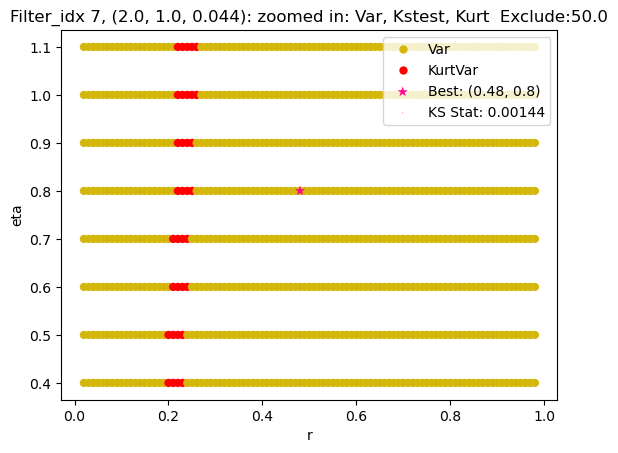

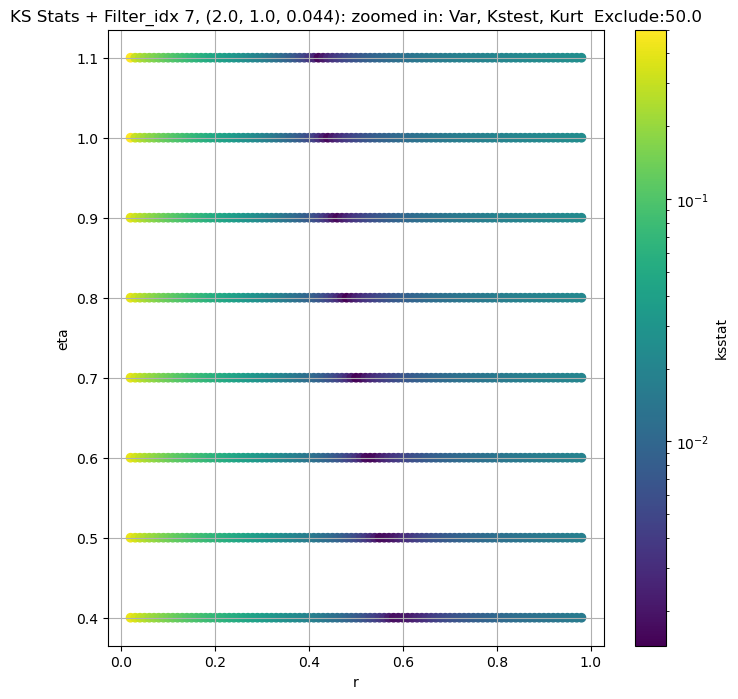

Filter_idx 8, (2.0, 1.0, 0.065):


  0%|          | 0/1368 [00:00<?, ?it/s]

Finding Minimum after computing 1368 CDFs
filter_idx 8, 200.0 + 100 = 300, ksstat: 0.004187817971876782, var: 11189.501310425023


  0%|          | 0/1368 [00:00<?, ?it/s]

Finding Minimum after computing 1368 CDFs
filter_idx 8, 200.0 + 75 = 275, ksstat: 0.00397102888219465, var: 11350.728283719807


  0%|          | 0/1368 [00:00<?, ?it/s]

Finding Minimum after computing 1368 CDFs
filter_idx 8, 200.0 + 50 = 250, ksstat: 0.0037528762538038647, var: 11521.249295759808


  0%|          | 0/1368 [00:00<?, ?it/s]

Finding Minimum after computing 1368 CDFs
filter_idx 8, 200.0 + 25 = 225, ksstat: 0.003608749767527698, var: 11702.134746720529


  0%|          | 0/1368 [00:00<?, ?it/s]

Finding Minimum after computing 1368 CDFs
filter_idx 8, 200.0 + 0 = 200, ksstat: 0.003399552121019611, var: 11894.810946325702


  0%|          | 0/1368 [00:00<?, ?it/s]

Finding Minimum after computing 1368 CDFs
filter_idx 8, 200.0 + -25 = 175, ksstat: 0.003226491019716504, var: 12100.94343125609


  0%|          | 0/1368 [00:00<?, ?it/s]

Finding Minimum after computing 1368 CDFs
filter_idx 8, 200.0 + -50 = 150, ksstat: 0.0032410524264760987, var: 12322.650437066557


  0%|          | 0/1368 [00:00<?, ?it/s]

Finding Minimum after computing 1368 CDFs
filter_idx 8, 200.0 + -75 = 125, ksstat: 0.0037192196507334074, var: 12563.030149035134


  0%|          | 0/1368 [00:00<?, ?it/s]

Finding Minimum after computing 1368 CDFs
filter_idx 8, 200.0 + -100 = 100, ksstat: 0.004442534396864151, var: 12826.620413533665
Number of samples: 100000, Without approximation : 136161000.0


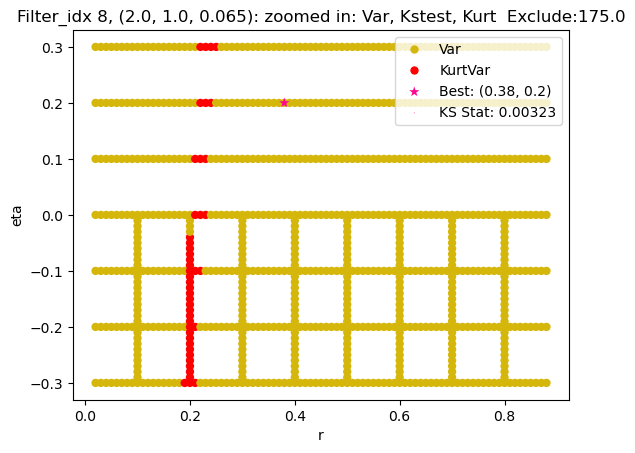

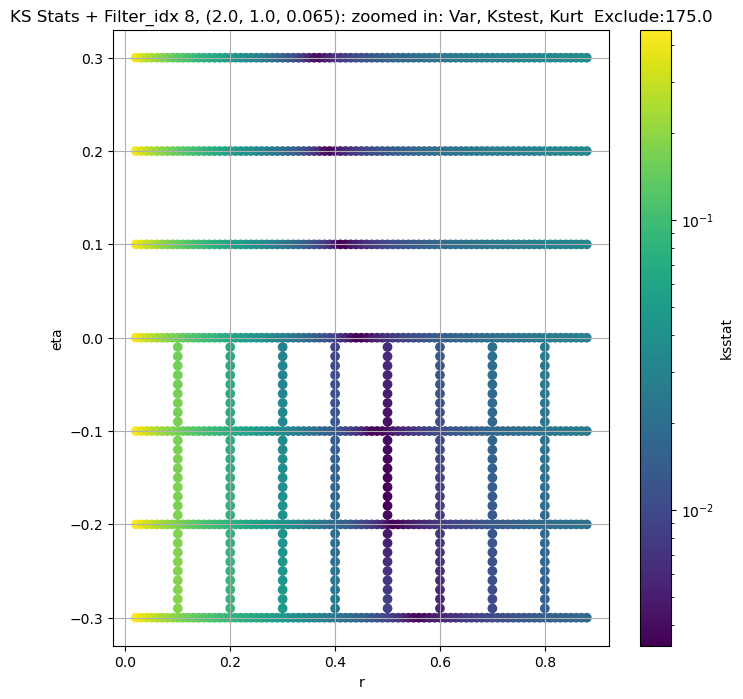

Filter_idx 9, (2.0, 1.0, 0.096):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 9, 50.0 + 100 = 150, ksstat: 0.004480467901047391, var: 5161.496158873295


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 9, 50.0 + 75 = 125, ksstat: 0.004869392624344271, var: 5283.125853474647


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 9, 50.0 + 50 = 100, ksstat: 0.004331386758711642, var: 5415.532029640232


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 9, 50.0 + 25 = 75, ksstat: 0.004194815693506104, var: 5561.438728223642


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 9, 50.0 + 0 = 50, ksstat: 0.004573215566679889, var: 5725.245989341669


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 9, 50.0 + -25 = 25, ksstat: 0.005379186938785474, var: 5915.652823341895


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 9, 50.0 + -50 = 0, ksstat: 0.006399711704382638, var: 6166.702256197297
Number of samples: 100000, Without approximation : 136161000.0


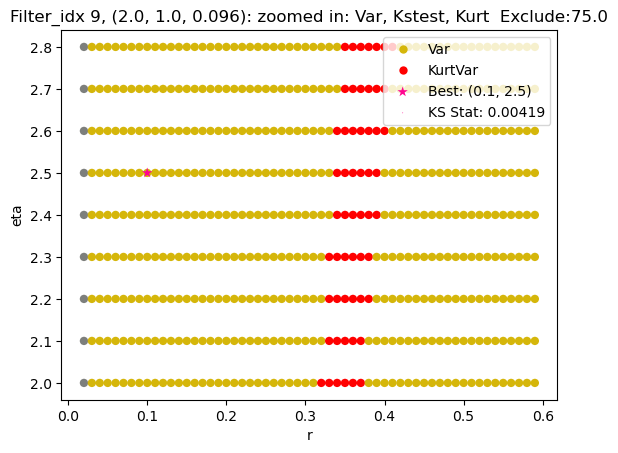

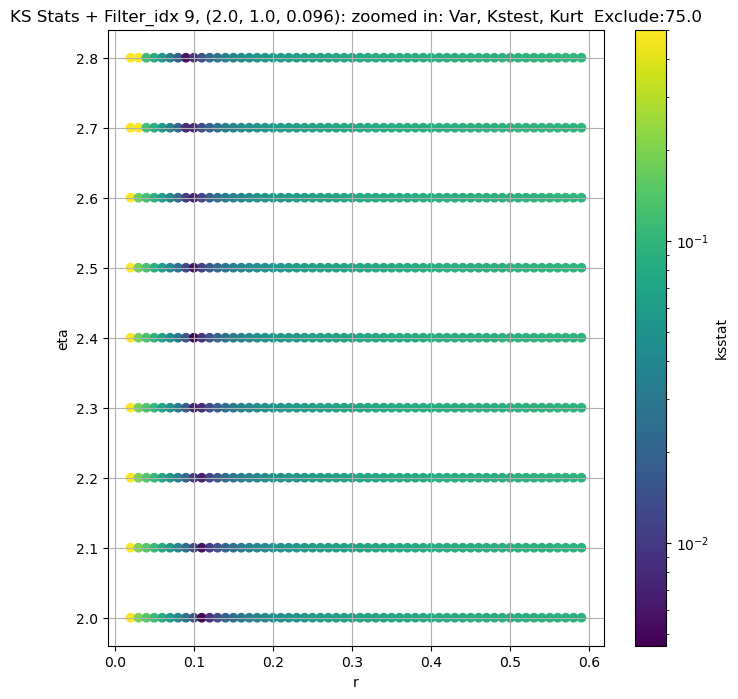

Filter_idx 10, (2.0, 1.0, 0.141):


  0%|          | 0/879 [00:00<?, ?it/s]

Finding Minimum after computing 879 CDFs
filter_idx 10, 100.0 + 100 = 200, ksstat: 0.004236292939868491, var: 1482.9278623803611


  0%|          | 0/879 [00:00<?, ?it/s]

Finding Minimum after computing 879 CDFs
filter_idx 10, 100.0 + 75 = 175, ksstat: 0.003945046306820342, var: 1511.5599584693484


  0%|          | 0/879 [00:00<?, ?it/s]

Finding Minimum after computing 879 CDFs
filter_idx 10, 100.0 + 50 = 150, ksstat: 0.003671232933077473, var: 1542.118071814976


  0%|          | 0/879 [00:00<?, ?it/s]

Finding Minimum after computing 879 CDFs
filter_idx 10, 100.0 + 25 = 125, ksstat: 0.0035773086742552085, var: 1574.9530425544558


  0%|          | 0/879 [00:00<?, ?it/s]

Finding Minimum after computing 879 CDFs
filter_idx 10, 100.0 + 0 = 100, ksstat: 0.003083099099323583, var: 1610.58341246199


  0%|          | 0/879 [00:00<?, ?it/s]

Finding Minimum after computing 879 CDFs
filter_idx 10, 100.0 + -25 = 75, ksstat: 0.003368955698020759, var: 1649.803351924396


  0%|          | 0/879 [00:00<?, ?it/s]

Finding Minimum after computing 879 CDFs
filter_idx 10, 100.0 + -50 = 50, ksstat: 0.0037557348895174564, var: 1693.9628229071375


  0%|          | 0/879 [00:00<?, ?it/s]

Finding Minimum after computing 879 CDFs
filter_idx 10, 100.0 + -75 = 25, ksstat: 0.004235849873901021, var: 1745.5092418405839


  0%|          | 0/879 [00:00<?, ?it/s]

Finding Minimum after computing 879 CDFs
filter_idx 10, 100.0 + -100 = 0, ksstat: 0.0046082196297283495, var: 1821.148368404074
Number of samples: 100000, Without approximation : 136161000.0


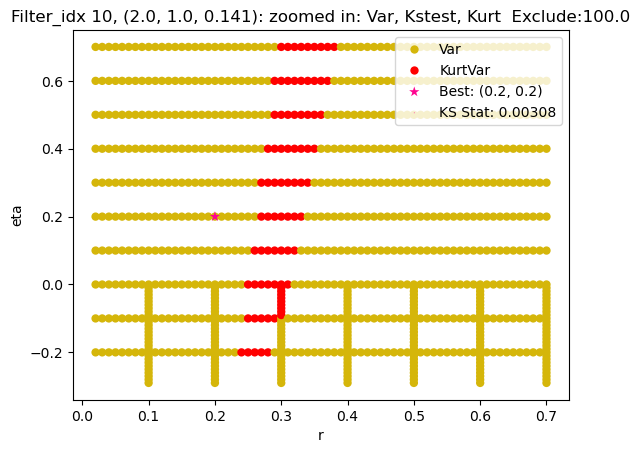

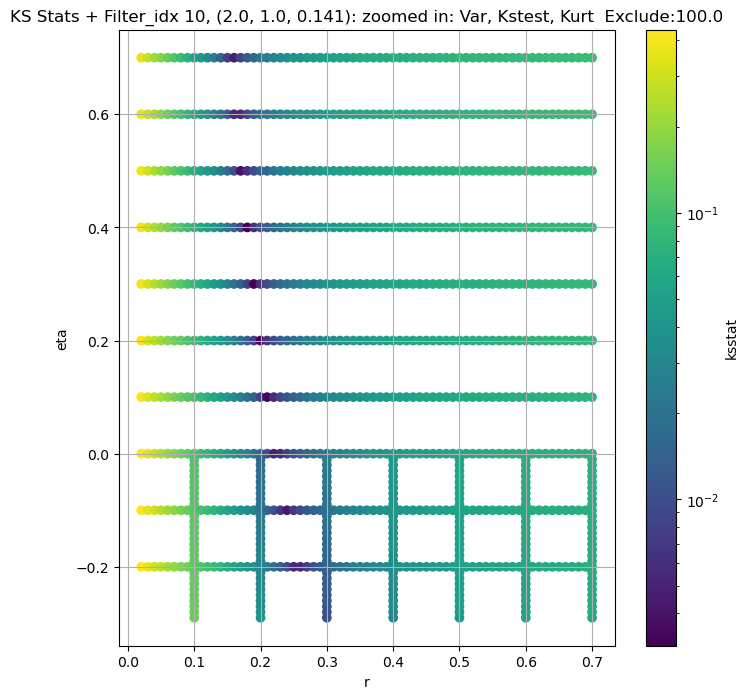

Filter_idx 11, (2.0, 1.0, 0.208):


  0%|          | 0/873 [00:00<?, ?it/s]

Finding Minimum after computing 873 CDFs
filter_idx 11, 100.0 + 100 = 200, ksstat: 0.00492402522659563, var: 329.9343158963047


  0%|          | 0/873 [00:00<?, ?it/s]

Finding Minimum after computing 873 CDFs
filter_idx 11, 100.0 + 75 = 175, ksstat: 0.004531229250650304, var: 335.86222401360544


  0%|          | 0/873 [00:00<?, ?it/s]

Finding Minimum after computing 873 CDFs
filter_idx 11, 100.0 + 50 = 150, ksstat: 0.004139182528654972, var: 342.19992001612655


  0%|          | 0/873 [00:00<?, ?it/s]

Finding Minimum after computing 873 CDFs
filter_idx 11, 100.0 + 25 = 125, ksstat: 0.003863893638364268, var: 349.0280203117371


  0%|          | 0/873 [00:00<?, ?it/s]

Finding Minimum after computing 873 CDFs
filter_idx 11, 100.0 + 0 = 100, ksstat: 0.0034908636690605746, var: 356.4639091990768


  0%|          | 0/873 [00:00<?, ?it/s]

Finding Minimum after computing 873 CDFs
filter_idx 11, 100.0 + -25 = 75, ksstat: 0.003141394949152443, var: 364.6938288683128


  0%|          | 0/873 [00:00<?, ?it/s]

Finding Minimum after computing 873 CDFs
filter_idx 11, 100.0 + -50 = 50, ksstat: 0.002709150821053108, var: 374.0598165425166


  0%|          | 0/873 [00:00<?, ?it/s]

Finding Minimum after computing 873 CDFs
filter_idx 11, 100.0 + -75 = 25, ksstat: 0.002339752461481437, var: 385.2946085195961


  0%|          | 0/873 [00:00<?, ?it/s]

Finding Minimum after computing 873 CDFs
filter_idx 11, 100.0 + -100 = 0, ksstat: 0.002863215311127154, var: 408.8180671324572
Number of samples: 100000, Without approximation : 136161000.0


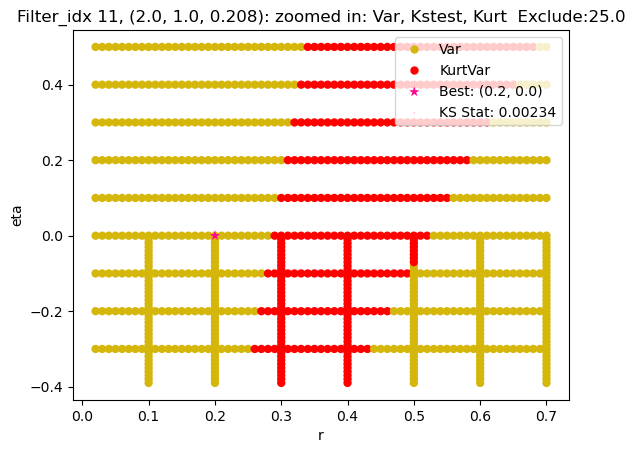

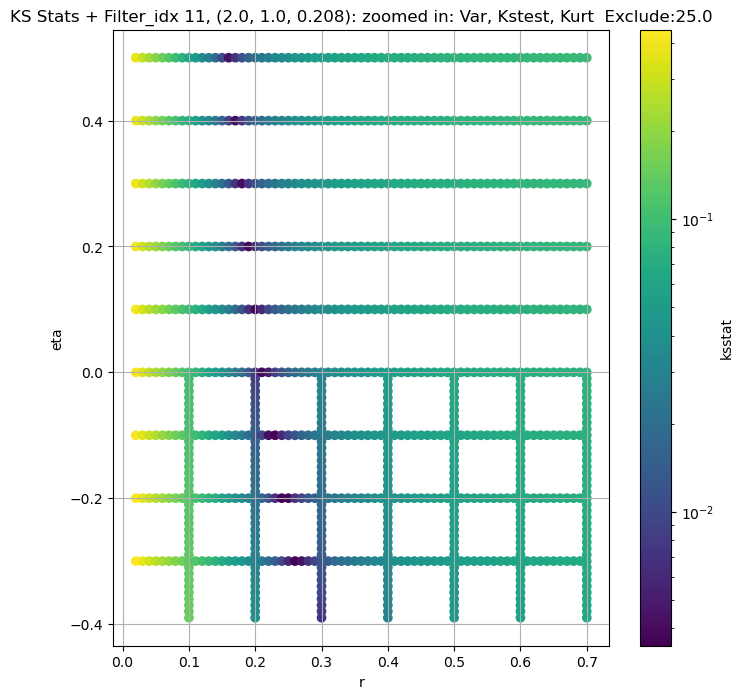

Filter_idx 12, (2.0, 1.0, 0.306):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 12, 0.0 + 100 = 100, ksstat: 0.005212614528873949, var: 66.62526927443895


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 12, 0.0 + 75 = 75, ksstat: 0.0048250435533473, var: 68.29768838249872


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 12, 0.0 + 50 = 50, ksstat: 0.004182230173295887, var: 70.26270115449789


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 12, 0.0 + 25 = 25, ksstat: 0.0034986156148369973, var: 72.80295093595011


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 12, 0.0 + 0 = 0, ksstat: 0.0018802535001574139, var: 79.91926652878242
Number of samples: 100000, Without approximation : 136161000.0


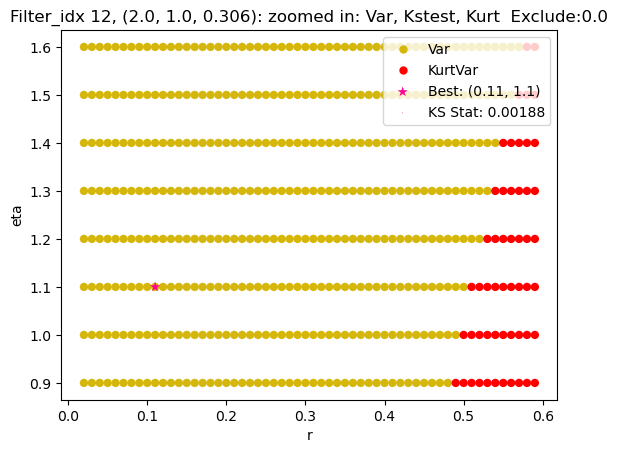

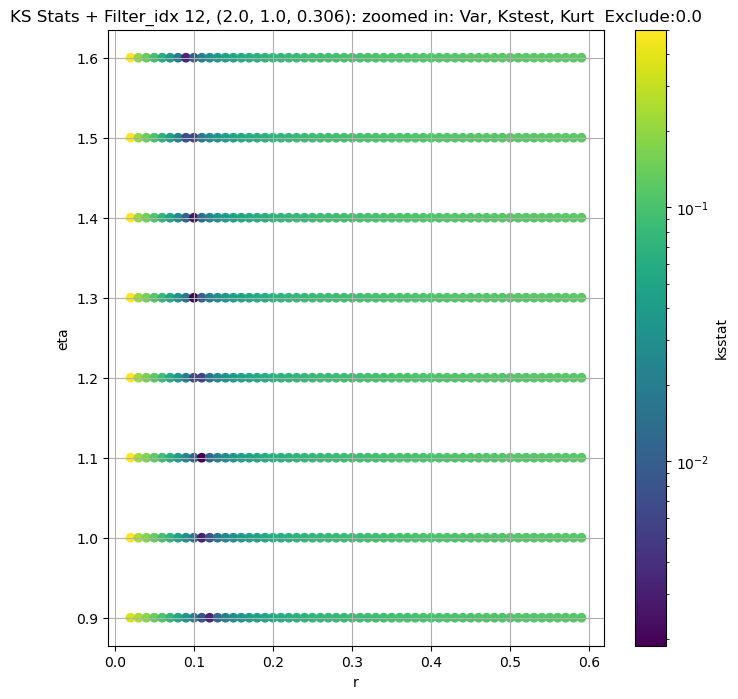

Filter_idx 13, (2.0, 1.0, 0.45):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 50.0 + 100 = 150, ksstat: 0.0059287926564621785, var: 16.98734560123906


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 50.0 + 75 = 125, ksstat: 0.0052907234548139614, var: 17.383204684388463


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 50.0 + 50 = 100, ksstat: 0.004779943272256171, var: 17.824720639325516


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 50.0 + 25 = 75, ksstat: 0.004295676752099124, var: 18.329300269654535


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 50.0 + 0 = 50, ksstat: 0.003913720214582916, var: 18.930491524216023


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 50.0 + -25 = 25, ksstat: 0.00412782758369612, var: 19.718157810602513


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 50.0 + -50 = 0, ksstat: 0.005028376067147344, var: 22.026033928677723
Number of samples: 100000, Without approximation : 136161000.0


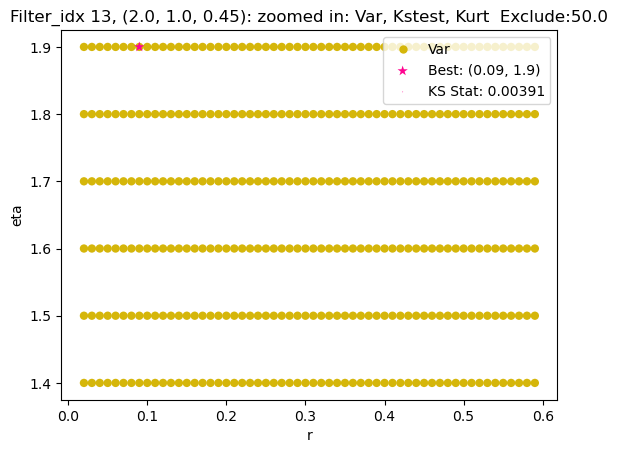

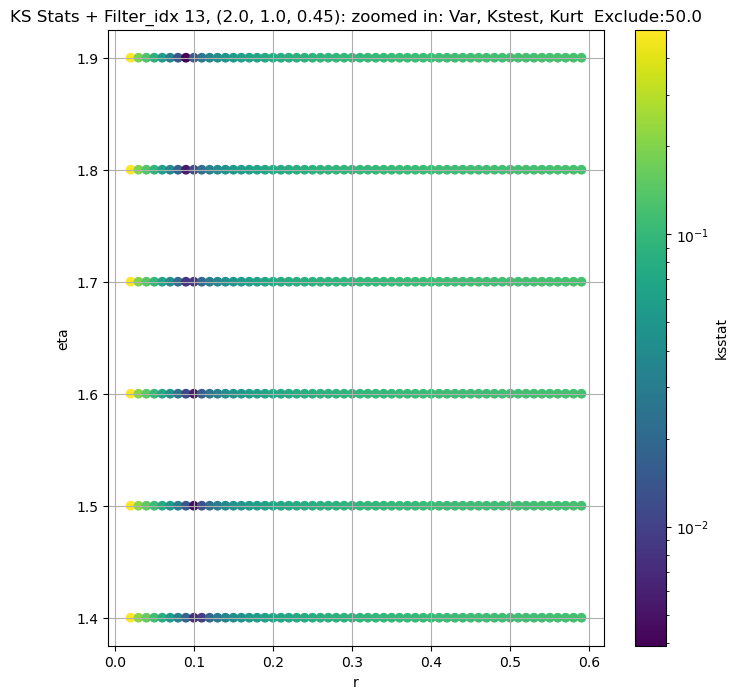

Filter_idx 14, (3.0, 0.5, 0.044):


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 14, 100.0 + 100 = 200, ksstat: 0.002568371243447743, var: 17504.77820910147


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 14, 100.0 + 75 = 175, ksstat: 0.0023758645178777234, var: 17712.49867370005


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 14, 100.0 + 50 = 150, ksstat: 0.0022110748800069358, var: 17938.811981937422


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 14, 100.0 + 25 = 125, ksstat: 0.0020319857416107867, var: 18187.612624584803


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 14, 100.0 + 0 = 100, ksstat: 0.0018553568579228463, var: 18464.37280702396


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 14, 100.0 + -25 = 75, ksstat: 0.0020498944721254256, var: 18778.178554207054


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 14, 100.0 + -50 = 50, ksstat: 0.002640068939844944, var: 19144.89529313029


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 14, 100.0 + -75 = 25, ksstat: 0.0035382835801279003, var: 19600.597034368562


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 14, 100.0 + -100 = 0, ksstat: 0.005318371758461976, var: 20334.26163310914
Number of samples: 100000, Without approximation : 136161000.0


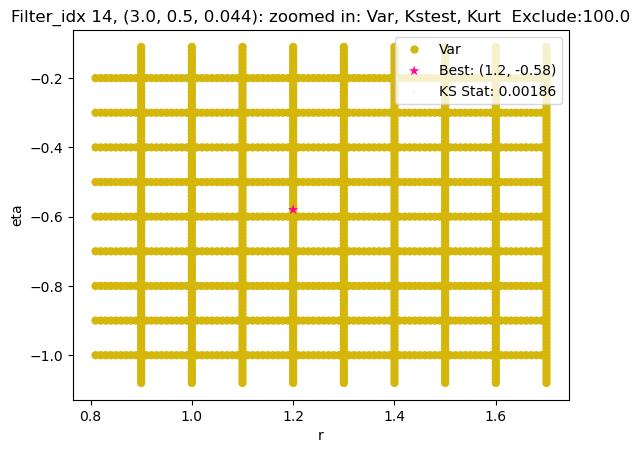

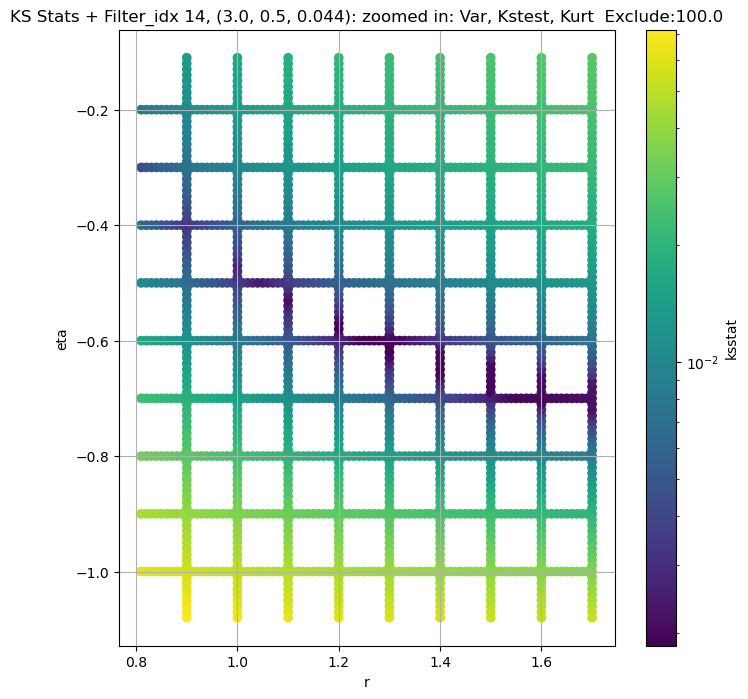

Filter_idx 15, (3.0, 0.5, 0.065):


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 15, 200.0 + 100 = 300, ksstat: 0.0037709781467762625, var: 6508.8401718372825


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 15, 200.0 + 75 = 275, ksstat: 0.003560030503306169, var: 6604.229502580984


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 15, 200.0 + 50 = 250, ksstat: 0.0033088563023502, var: 6706.024203140081


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 15, 200.0 + 25 = 225, ksstat: 0.0030965756864795267, var: 6815.003514215366


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 15, 200.0 + 0 = 200, ksstat: 0.0028684571310373386, var: 6932.202863339326


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 15, 200.0 + -25 = 175, ksstat: 0.0026735266623446655, var: 7058.779360936505


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 15, 200.0 + -50 = 150, ksstat: 0.002467980771375111, var: 7196.176734280085


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 15, 200.0 + -75 = 125, ksstat: 0.002248108604784839, var: 7346.156951307256


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 15, 200.0 + -100 = 100, ksstat: 0.0022643496023160986, var: 7511.109168575927
Number of samples: 100000, Without approximation : 136161000.0


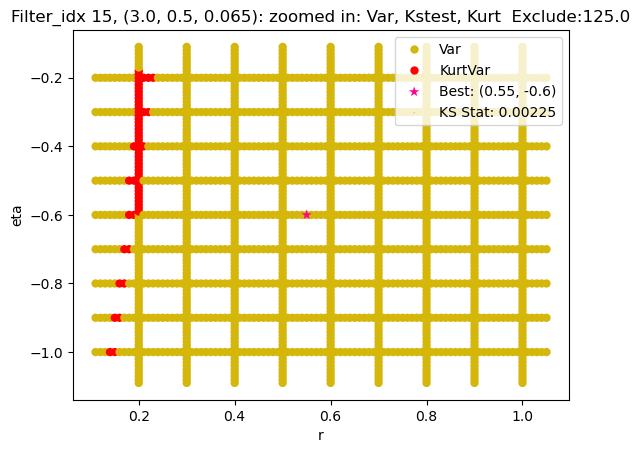

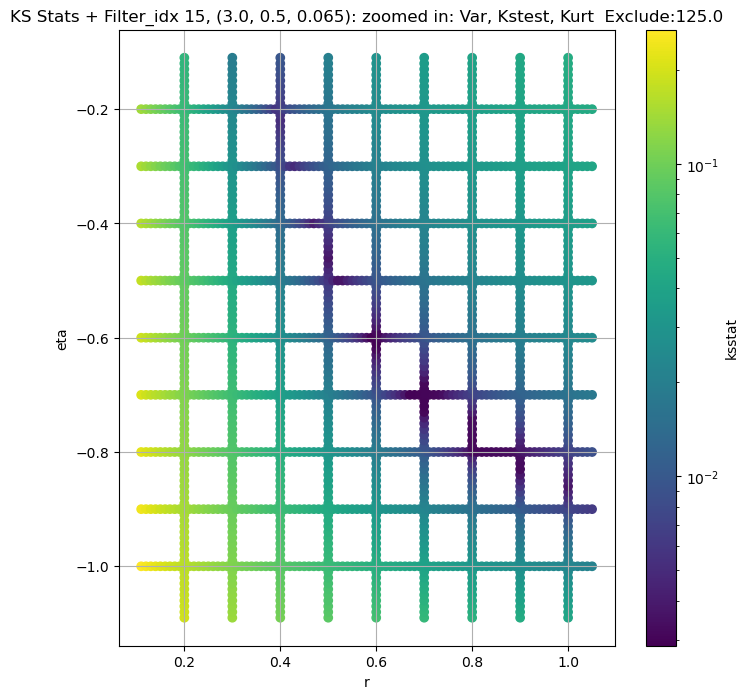

Filter_idx 16, (3.0, 0.5, 0.096):


  0%|          | 0/936 [00:00<?, ?it/s]

Finding Minimum after computing 936 CDFs
filter_idx 16, 100.0 + 100 = 200, ksstat: 0.003293399324228341, var: 2490.764231309979


  0%|          | 0/936 [00:00<?, ?it/s]

Finding Minimum after computing 936 CDFs
filter_idx 16, 100.0 + 75 = 175, ksstat: 0.0030519496302465754, var: 2551.420820371555


  0%|          | 0/936 [00:00<?, ?it/s]

Finding Minimum after computing 936 CDFs
filter_idx 16, 100.0 + 50 = 150, ksstat: 0.0027728839197025262, var: 2616.7429414863395


  0%|          | 0/936 [00:00<?, ?it/s]

Finding Minimum after computing 936 CDFs
filter_idx 16, 100.0 + 25 = 125, ksstat: 0.002534040192889008, var: 2687.4524007998157


  0%|          | 0/936 [00:00<?, ?it/s]

Finding Minimum after computing 936 CDFs
filter_idx 16, 100.0 + 0 = 100, ksstat: 0.002263738997782553, var: 2764.5595039048144


  0%|          | 0/936 [00:00<?, ?it/s]

Finding Minimum after computing 936 CDFs
filter_idx 16, 100.0 + -25 = 75, ksstat: 0.0020086549303116033, var: 2849.681421759352


  0%|          | 0/936 [00:00<?, ?it/s]

Finding Minimum after computing 936 CDFs
filter_idx 16, 100.0 + -50 = 50, ksstat: 0.0018865140393544977, var: 2945.4864806008886


  0%|          | 0/936 [00:00<?, ?it/s]

Finding Minimum after computing 936 CDFs
filter_idx 16, 100.0 + -75 = 25, ksstat: 0.0022903588177393686, var: 3057.1875997529964


  0%|          | 0/936 [00:00<?, ?it/s]

Finding Minimum after computing 936 CDFs
filter_idx 16, 100.0 + -100 = 0, ksstat: 0.0033262549079552395, var: 3215.5339280661833
Number of samples: 100000, Without approximation : 136161000.0


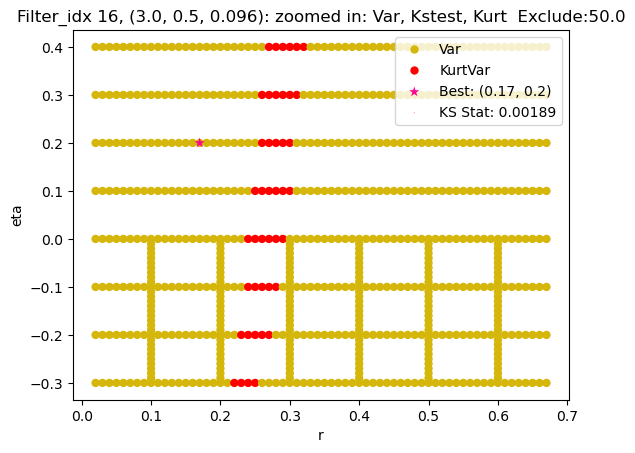

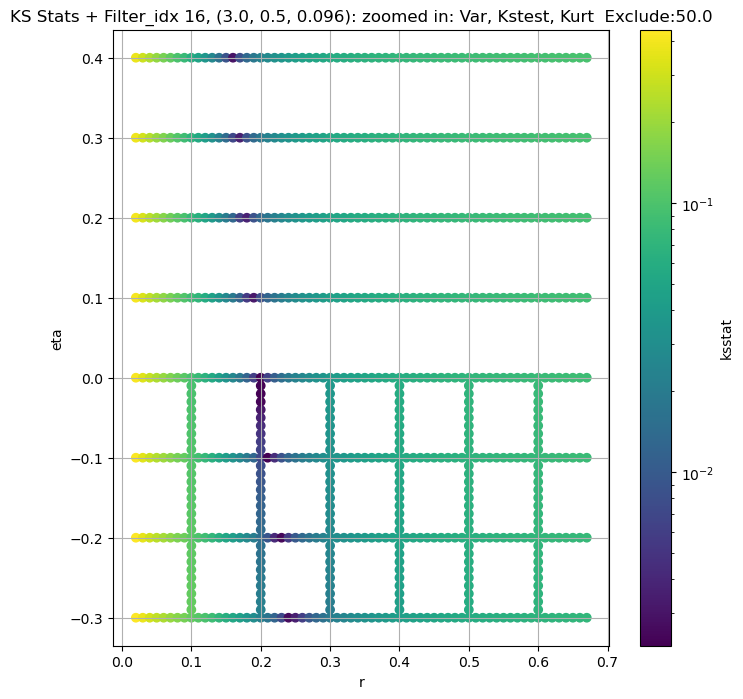

Filter_idx 17, (3.0, 0.5, 0.141):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 17, 0.0 + 100 = 100, ksstat: 0.0032928698303708037, var: 576.6785632486433


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 17, 0.0 + 75 = 75, ksstat: 0.003350978706889718, var: 594.4418121825414


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 17, 0.0 + 50 = 50, ksstat: 0.002159575200207523, var: 614.685619361966


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 17, 0.0 + 25 = 25, ksstat: 0.0018410864690125983, var: 639.0480874780253


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 17, 0.0 + 0 = 0, ksstat: 0.0011245329556370445, var: 685.4049185011345
Number of samples: 100000, Without approximation : 136161000.0


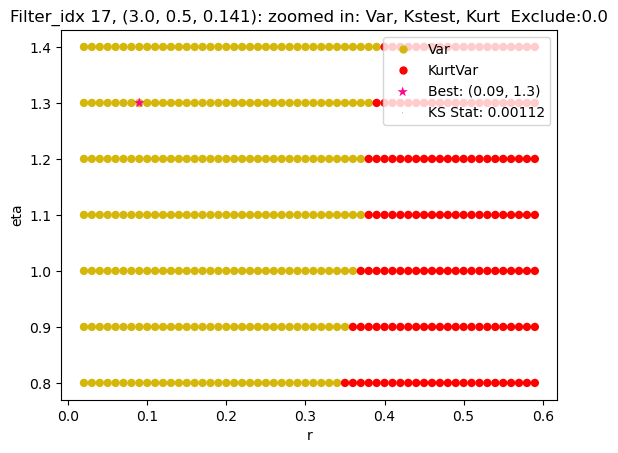

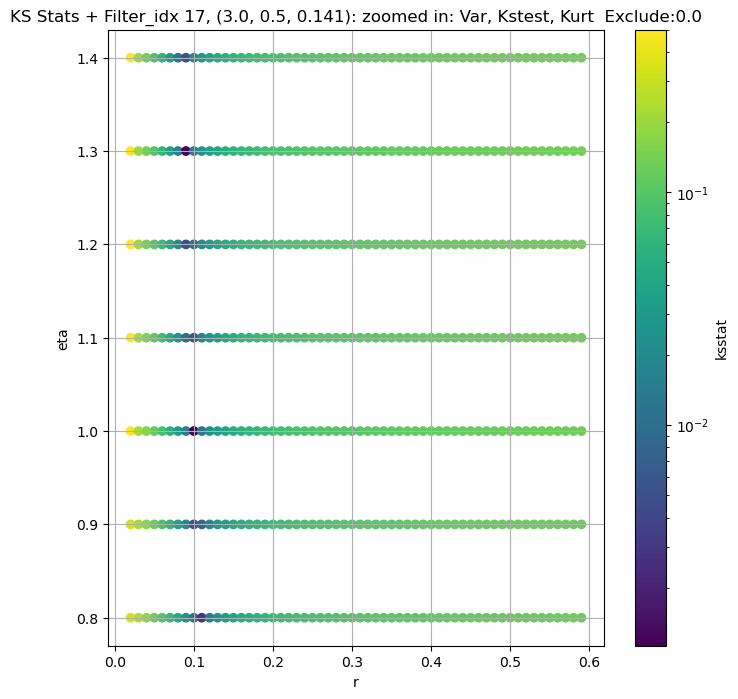

Filter_idx 18, (3.0, 0.5, 0.208):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 18, 50.0 + 100 = 150, ksstat: 0.005077903444817962, var: 70.10797107878503


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 18, 50.0 + 75 = 125, ksstat: 0.004761610776715601, var: 71.96768292737784


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 18, 50.0 + 50 = 100, ksstat: 0.004225202277019391, var: 74.04986870230479


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 18, 50.0 + 25 = 75, ksstat: 0.003368618437683435, var: 76.4414011056728


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 18, 50.0 + 0 = 50, ksstat: 0.003047863750028988, var: 79.3219674582591


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 18, 50.0 + -25 = 25, ksstat: 0.0025147619051660297, var: 83.27193779873956


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 18, 50.0 + -50 = 0, ksstat: 0.004854099589889138, var: 99.86562679041884
Number of samples: 100000, Without approximation : 136161000.0


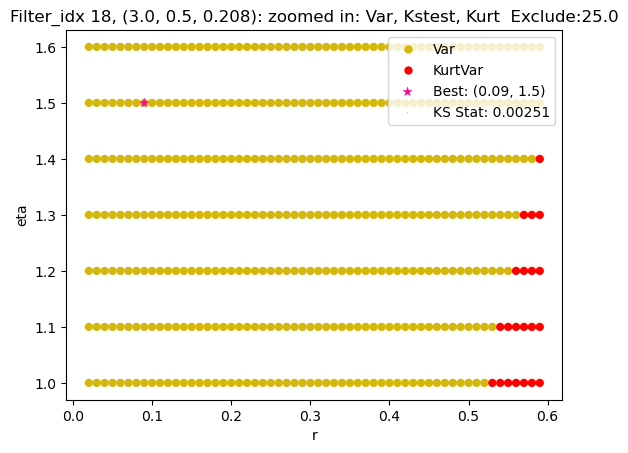

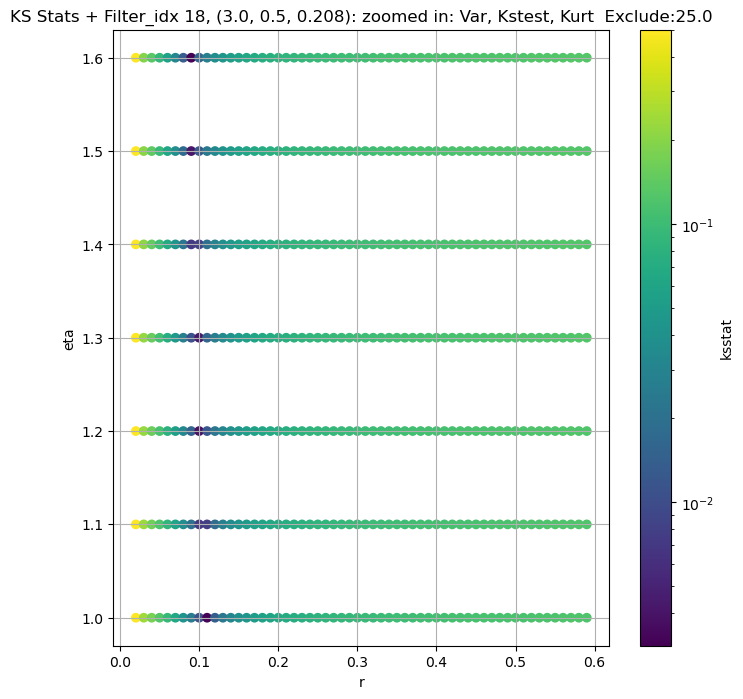

Filter_idx 19, (3.0, 0.5, 0.306):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 19, 100.0 + 100 = 200, ksstat: 0.006854799614542564, var: 15.719435591758238


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 19, 100.0 + 75 = 175, ksstat: 0.006136675542273928, var: 16.071214326768988


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 19, 100.0 + 50 = 150, ksstat: 0.0057901227944675004, var: 16.454469265542038


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 19, 100.0 + 25 = 125, ksstat: 0.0055919892486598, var: 16.876302164992797


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 19, 100.0 + 0 = 100, ksstat: 0.004923708700580148, var: 17.348652898787048


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 19, 100.0 + -25 = 75, ksstat: 0.0053089759565351224, var: 17.89134332821633


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 19, 100.0 + -50 = 50, ksstat: 0.005132064166761208, var: 18.54577669860327


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 19, 100.0 + -75 = 25, ksstat: 0.0059388047133251964, var: 19.445535309198377


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 19, 100.0 + -100 = 0, ksstat: 0.008195571986151978, var: 23.55986258743369
Number of samples: 100000, Without approximation : 136161000.0


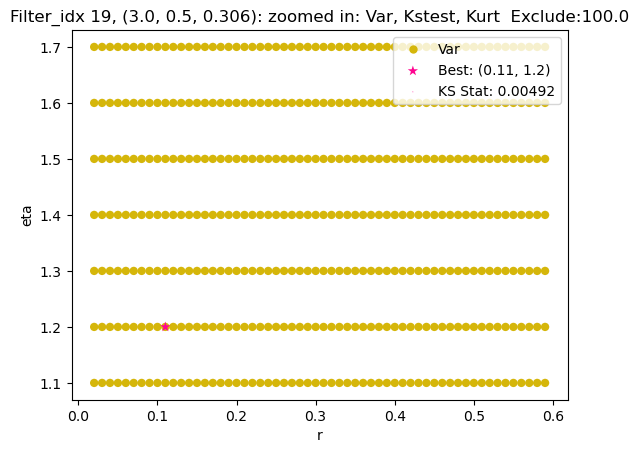

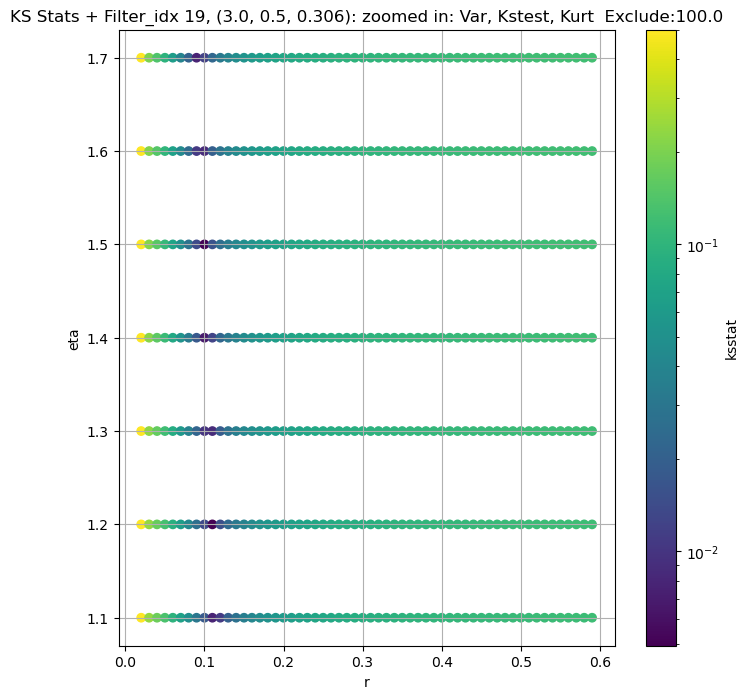

Filter_idx 20, (3.0, 0.5, 0.45):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 100.0 + 100 = 200, ksstat: 0.005760694565655311, var: 7.267921859679271


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 100.0 + 75 = 175, ksstat: 0.005376906626111233, var: 7.407913853057134


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 100.0 + 50 = 150, ksstat: 0.00498148489928707, var: 7.558316821735151


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 100.0 + 25 = 125, ksstat: 0.004599459735530442, var: 7.721225208078784


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 100.0 + 0 = 100, ksstat: 0.004418081081909164, var: 7.899778091104452


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 100.0 + -25 = 75, ksstat: 0.004232107075777647, var: 8.09895345456225


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 100.0 + -50 = 50, ksstat: 0.0049964144655574305, var: 8.327385754740419


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 100.0 + -75 = 25, ksstat: 0.005663468581515507, var: 8.606796005944854


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 100.0 + -100 = 0, ksstat: 0.005920151064449264, var: 9.30091777009618
Number of samples: 100000, Without approximation : 136161000.0


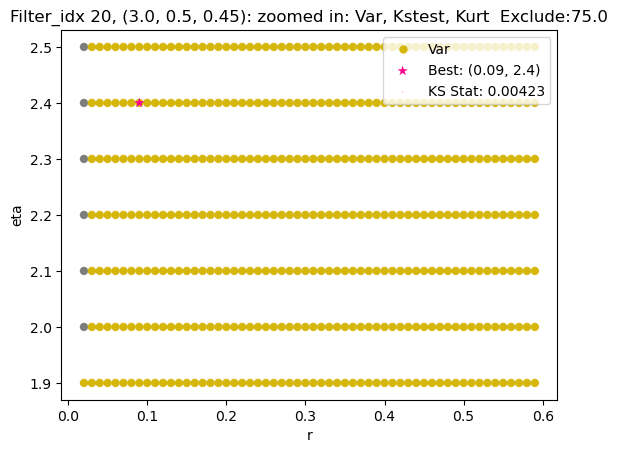

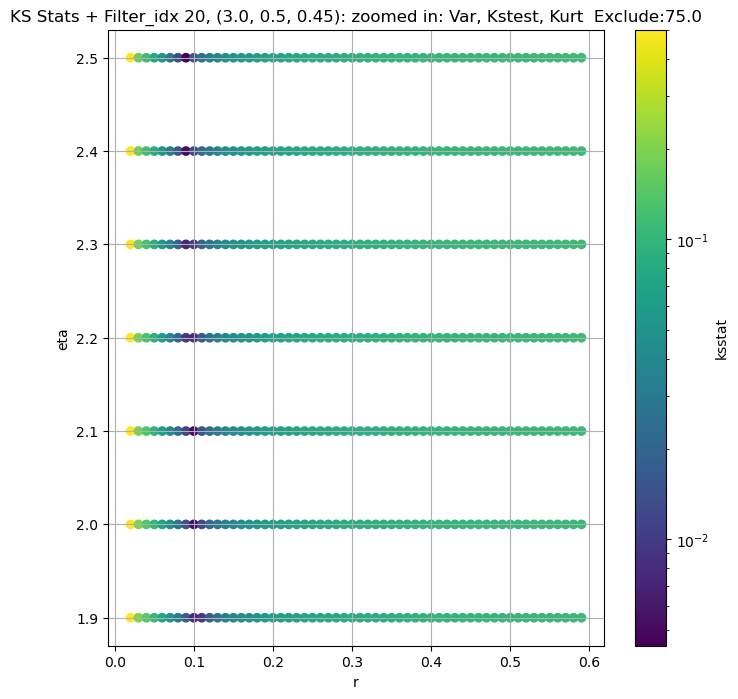

Filter_idx 21, (3.0, 1.0, 0.044):


  0%|          | 0/1557 [00:00<?, ?it/s]

Finding Minimum after computing 1557 CDFs
filter_idx 21, 100.0 + 100 = 200, ksstat: 0.0024407680642201113, var: 21262.767777242752


  0%|          | 0/1557 [00:00<?, ?it/s]

Finding Minimum after computing 1557 CDFs
filter_idx 21, 100.0 + 75 = 175, ksstat: 0.0022031137508881932, var: 21498.47991787563


  0%|          | 0/1557 [00:00<?, ?it/s]

Finding Minimum after computing 1557 CDFs
filter_idx 21, 100.0 + 50 = 150, ksstat: 0.001973698640439836, var: 21753.153947820392


  0%|          | 0/1557 [00:00<?, ?it/s]

Finding Minimum after computing 1557 CDFs
filter_idx 21, 100.0 + 25 = 125, ksstat: 0.001761683075164916, var: 22031.22362074854


  0%|          | 0/1557 [00:00<?, ?it/s]

Finding Minimum after computing 1557 CDFs
filter_idx 21, 100.0 + 0 = 100, ksstat: 0.001556956501341265, var: 22339.029038266406


  0%|          | 0/1557 [00:00<?, ?it/s]

Finding Minimum after computing 1557 CDFs
filter_idx 21, 100.0 + -25 = 75, ksstat: 0.0013441477957161219, var: 22686.537008517767


  0%|          | 0/1557 [00:00<?, ?it/s]

Finding Minimum after computing 1557 CDFs
filter_idx 21, 100.0 + -50 = 50, ksstat: 0.0013015135764586905, var: 23090.125027728925


  0%|          | 0/1557 [00:00<?, ?it/s]

Finding Minimum after computing 1557 CDFs
filter_idx 21, 100.0 + -75 = 25, ksstat: 0.0019608956114126608, var: 23585.21601968001


  0%|          | 0/1557 [00:00<?, ?it/s]

Finding Minimum after computing 1557 CDFs
filter_idx 21, 100.0 + -100 = 0, ksstat: 0.003335931229871525, var: 24402.94069481798
Number of samples: 100000, Without approximation : 136161000.0


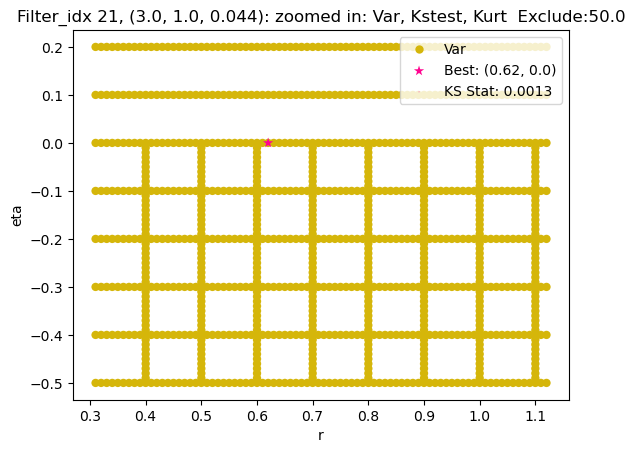

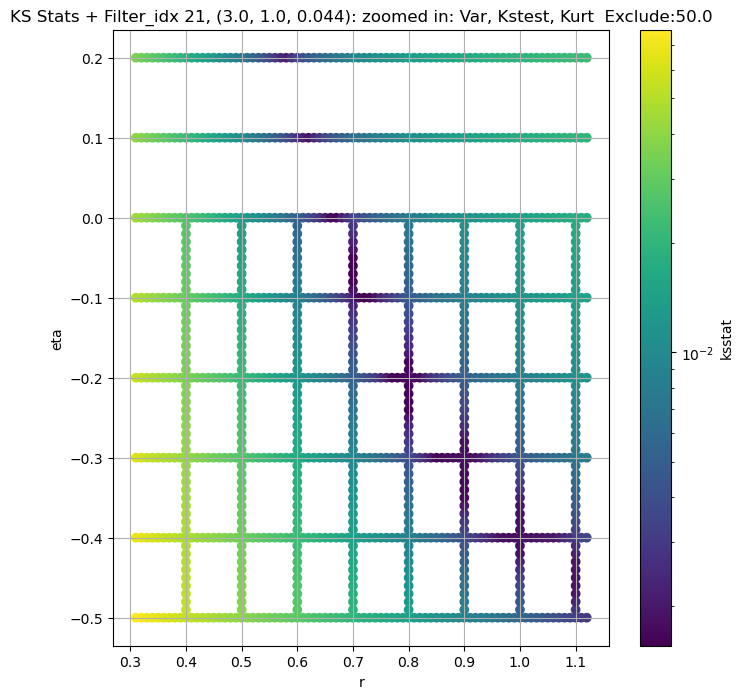

Filter_idx 22, (3.0, 1.0, 0.065):


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 22, 100.0 + 100 = 200, ksstat: 0.002596982731758346, var: 7274.537302450895


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 22, 100.0 + 75 = 175, ksstat: 0.0023262531807780595, var: 7383.022177790368


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 22, 100.0 + 50 = 150, ksstat: 0.00204964176714284, var: 7502.160734328274


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 22, 100.0 + 25 = 125, ksstat: 0.0017720077627463304, var: 7634.723376229984


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 22, 100.0 + 0 = 100, ksstat: 0.0015012000661907, var: 7784.91086859165


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 22, 100.0 + -25 = 75, ksstat: 0.0012850369369380894, var: 7959.229935786246


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 22, 100.0 + -50 = 50, ksstat: 0.0013116959400149009, var: 8169.214356649814


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 22, 100.0 + -75 = 25, ksstat: 0.002071730403657976, var: 8440.387800149198


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 22, 100.0 + -100 = 0, ksstat: 0.003656426492746445, var: 8900.258528887729
Number of samples: 100000, Without approximation : 136161000.0


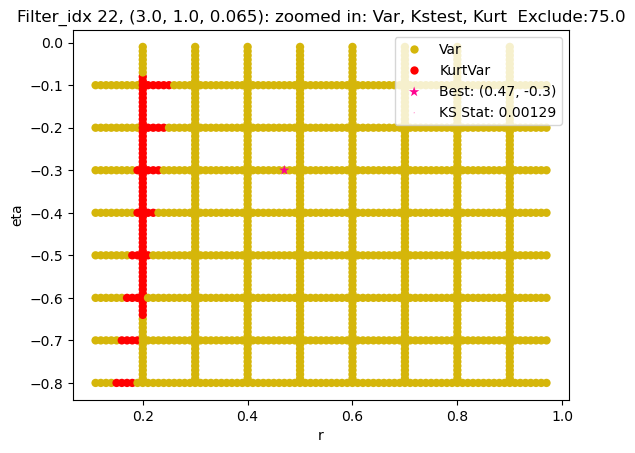

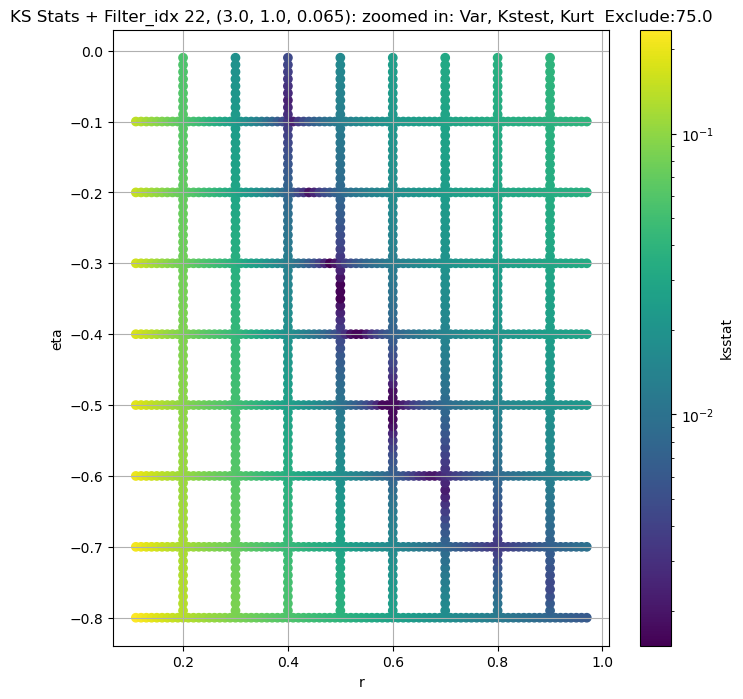

Filter_idx 23, (3.0, 1.0, 0.096):


  0%|          | 0/879 [00:00<?, ?it/s]

Finding Minimum after computing 879 CDFs
filter_idx 23, 100.0 + 100 = 200, ksstat: 0.003095988109467984, var: 2569.0273636188067


  0%|          | 0/879 [00:00<?, ?it/s]

Finding Minimum after computing 879 CDFs
filter_idx 23, 100.0 + 75 = 175, ksstat: 0.002717829857997227, var: 2633.9394387787415


  0%|          | 0/879 [00:00<?, ?it/s]

Finding Minimum after computing 879 CDFs
filter_idx 23, 100.0 + 50 = 150, ksstat: 0.0023820305864004467, var: 2706.320238471379


  0%|          | 0/879 [00:00<?, ?it/s]

Finding Minimum after computing 879 CDFs
filter_idx 23, 100.0 + 25 = 125, ksstat: 0.0020655142513247293, var: 2787.8809018505885


  0%|          | 0/879 [00:00<?, ?it/s]

Finding Minimum after computing 879 CDFs
filter_idx 23, 100.0 + 0 = 100, ksstat: 0.0017625457083765284, var: 2880.891760441422


  0%|          | 0/879 [00:00<?, ?it/s]

Finding Minimum after computing 879 CDFs
filter_idx 23, 100.0 + -25 = 75, ksstat: 0.0017825353124341359, var: 2988.395939823294


  0%|          | 0/879 [00:00<?, ?it/s]

Finding Minimum after computing 879 CDFs
filter_idx 23, 100.0 + -50 = 50, ksstat: 0.0024111649540222713, var: 3114.9827503677816


  0%|          | 0/879 [00:00<?, ?it/s]

Finding Minimum after computing 879 CDFs
filter_idx 23, 100.0 + -75 = 25, ksstat: 0.0030130870119876585, var: 3269.3825361155186


  0%|          | 0/879 [00:00<?, ?it/s]

Finding Minimum after computing 879 CDFs
filter_idx 23, 100.0 + -100 = 0, ksstat: 0.004897146208813985, var: 3508.70525172296
Number of samples: 100000, Without approximation : 136161000.0


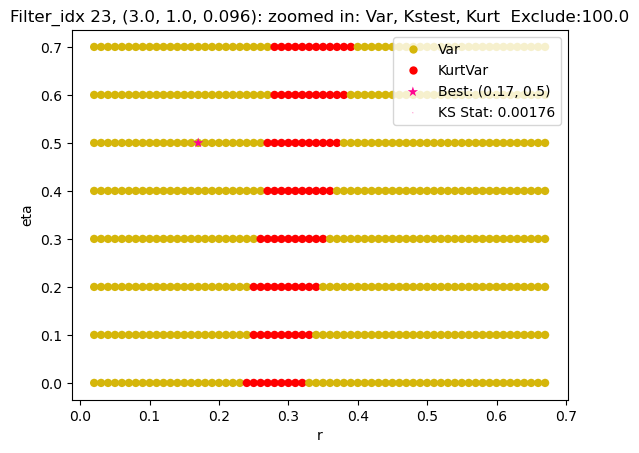

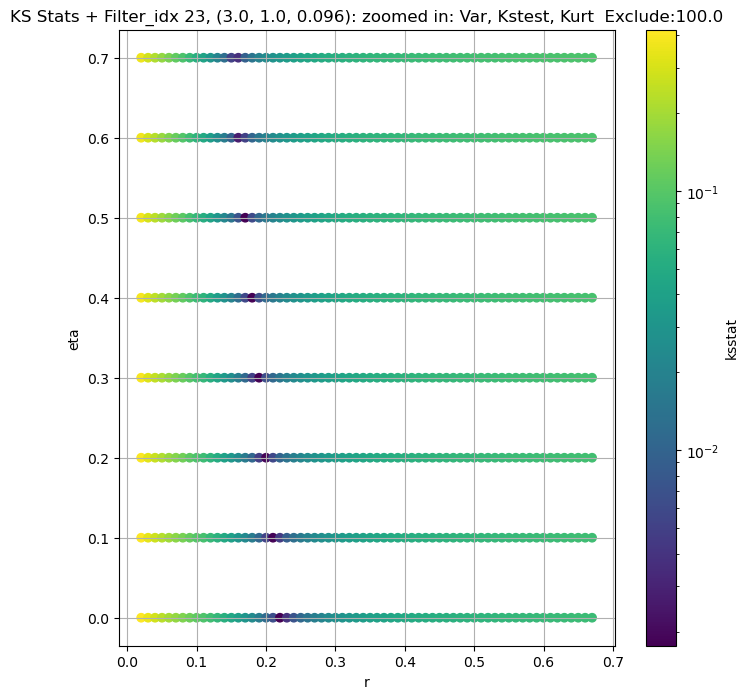

Filter_idx 24, (3.0, 1.0, 0.141):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 24, 50.0 + 100 = 150, ksstat: 0.003605905557496604, var: 683.2367393398553


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 24, 50.0 + 75 = 125, ksstat: 0.0027565298238971803, var: 704.8194367281509


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 24, 50.0 + 50 = 100, ksstat: 0.002222938221224789, var: 728.8584353625754


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 24, 50.0 + 25 = 75, ksstat: 0.0018587359669781645, var: 755.9666820977945


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 24, 50.0 + 0 = 50, ksstat: 0.0015307923673350404, var: 787.1885352100794


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 24, 50.0 + -25 = 25, ksstat: 0.0024202176820400656, var: 824.8445130536552


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 24, 50.0 + -50 = 0, ksstat: 0.002851780229156664, var: 893.056330892022
Number of samples: 100000, Without approximation : 136161000.0


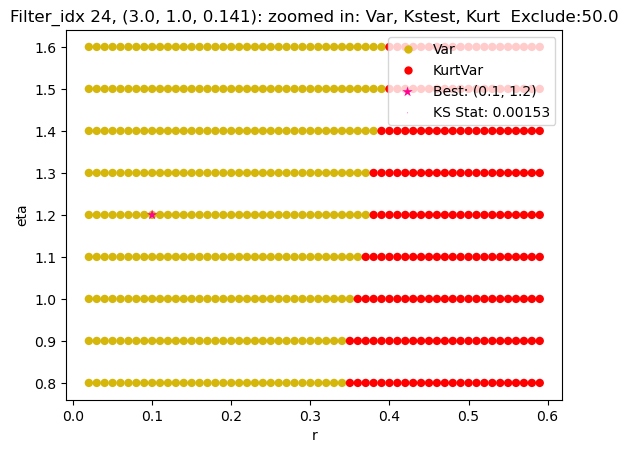

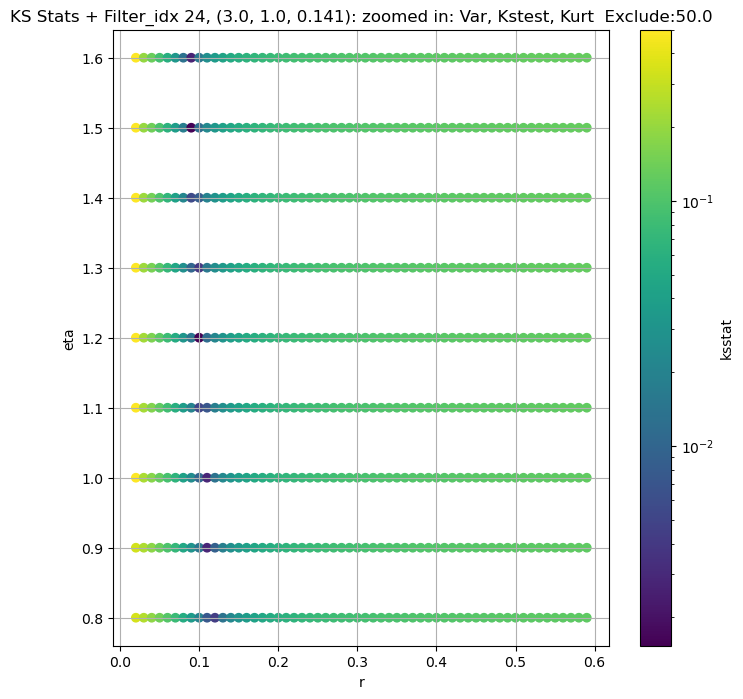

Filter_idx 25, (3.0, 1.0, 0.208):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 25, 50.0 + 100 = 150, ksstat: 0.004241475113404183, var: 102.69564792971138


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 25, 50.0 + 75 = 125, ksstat: 0.0034563618407528196, var: 105.76416780720737


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 25, 50.0 + 50 = 100, ksstat: 0.003354421508391381, var: 109.21089840272519


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 25, 50.0 + 25 = 75, ksstat: 0.002667150426002185, var: 113.1661286080422


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 25, 50.0 + 0 = 50, ksstat: 0.002907451234683167, var: 117.88972183831996


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 25, 50.0 + -25 = 25, ksstat: 0.004047676777799825, var: 124.08098674972214


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 25, 50.0 + -50 = 0, ksstat: 0.005966938251752318, var: 145.8257812444831
Number of samples: 100000, Without approximation : 136161000.0


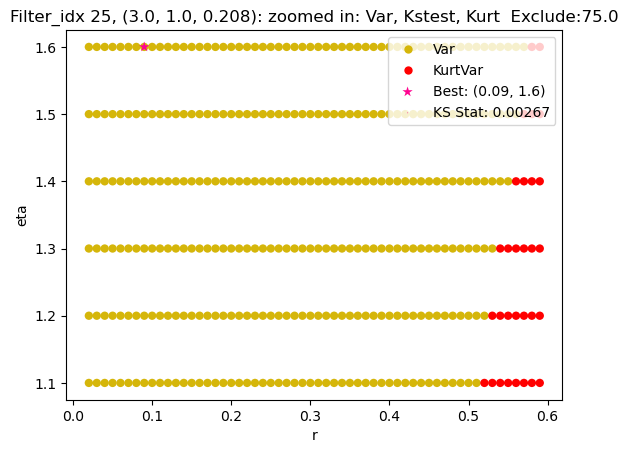

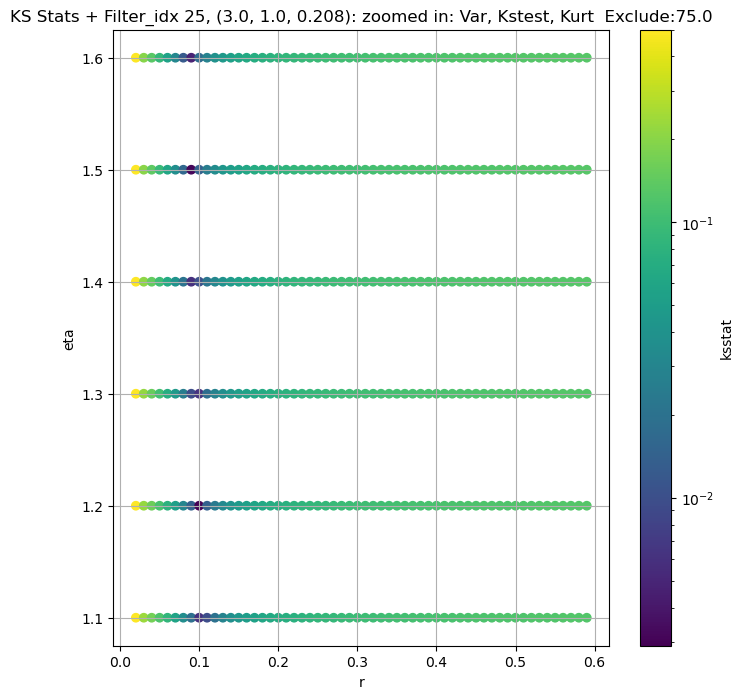

Filter_idx 26, (3.0, 1.0, 0.306):


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 26, 100.0 + 100 = 200, ksstat: 0.006094721606389134, var: 19.53439786968151


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 26, 100.0 + 75 = 175, ksstat: 0.00576010291144188, var: 19.990590843602952


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 26, 100.0 + 50 = 150, ksstat: 0.005112914205947502, var: 20.492954211262447


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 26, 100.0 + 25 = 125, ksstat: 0.005107783511936637, var: 21.054801998823446


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 26, 100.0 + 0 = 100, ksstat: 0.005515537895408901, var: 21.698167067351193


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 26, 100.0 + -25 = 75, ksstat: 0.005128458060958574, var: 22.463328632772978


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 26, 100.0 + -50 = 50, ksstat: 0.00611695776212462, var: 23.435893215598


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 26, 100.0 + -75 = 25, ksstat: 0.006654181077469068, var: 24.865317954217105


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 26, 100.0 + -100 = 0, ksstat: 0.00964372350037307, var: 30.76690778400487
Number of samples: 100000, Without approximation : 136161000.0


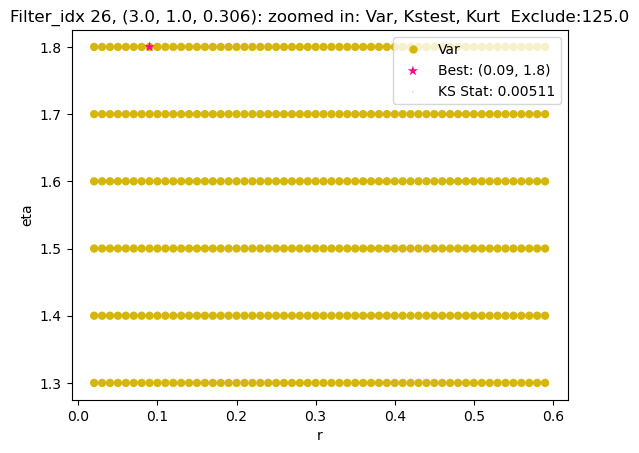

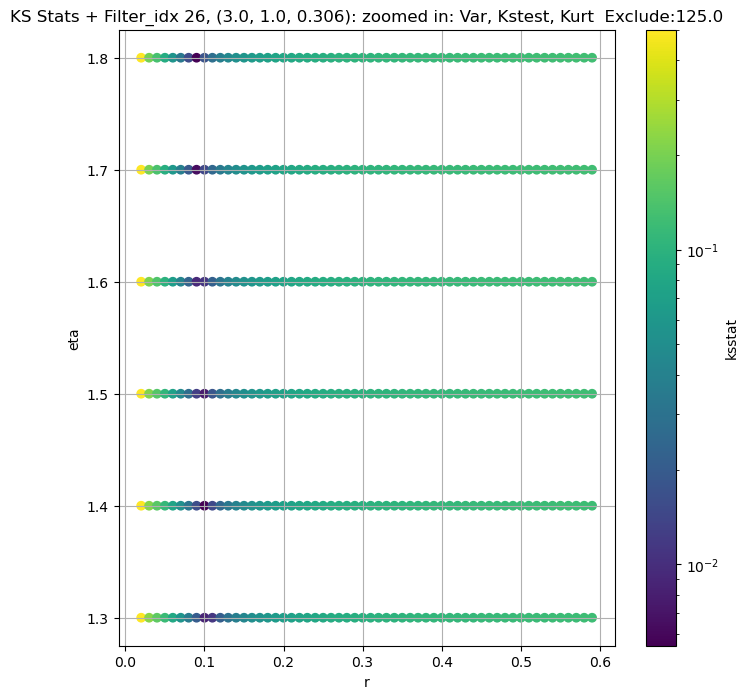

Filter_idx 27, (3.0, 1.0, 0.45):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 27, 200.0 + 100 = 300, ksstat: 0.006720253144805396, var: 6.563851858274407


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 27, 200.0 + 75 = 275, ksstat: 0.006471161258071751, var: 6.6890141381123005


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 27, 200.0 + 50 = 250, ksstat: 0.005935444136586601, var: 6.822762541986154


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 27, 200.0 + 25 = 225, ksstat: 0.00564778103683905, var: 6.966471275613009


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 27, 200.0 + 0 = 200, ksstat: 0.005358755976611895, var: 7.121911576749765


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 27, 200.0 + -25 = 175, ksstat: 0.0061317272480193585, var: 7.291295559416134


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 27, 200.0 + -50 = 150, ksstat: 0.006058055128833784, var: 7.4777389133533925


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 27, 200.0 + -75 = 125, ksstat: 0.006225090815714762, var: 7.685463685583281


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 27, 200.0 + -100 = 100, ksstat: 0.007135776239609926, var: 7.920732239672799
Number of samples: 100000, Without approximation : 136161000.0


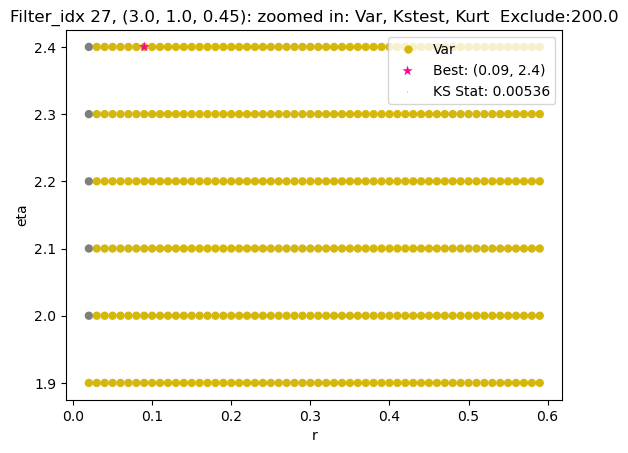

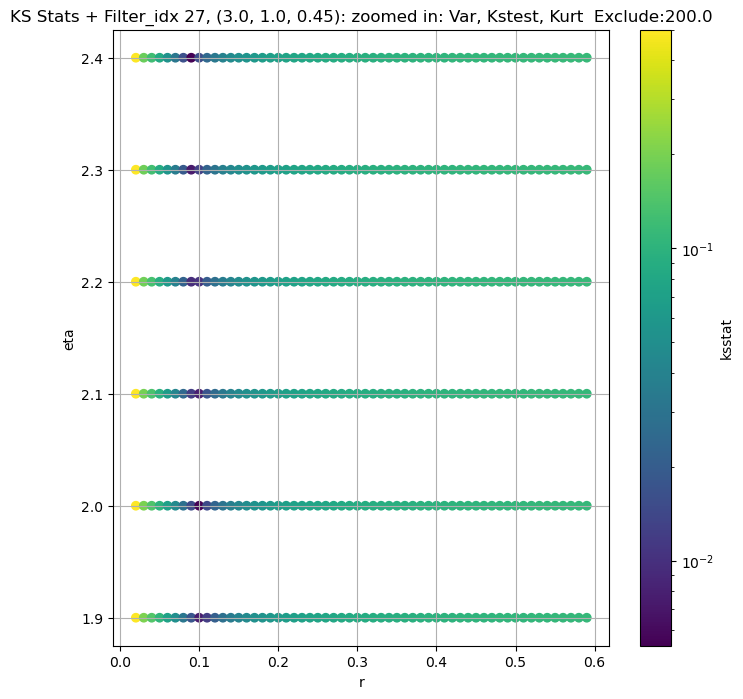

Filter_idx 28, (4.0, 0.5, 0.044):


  0%|          | 0/1377 [00:00<?, ?it/s]

Finding Minimum after computing 1377 CDFs
filter_idx 28, 100.0 + 100 = 200, ksstat: 0.0025512249312212233, var: 17345.725960100885


  0%|          | 0/1377 [00:00<?, ?it/s]

Finding Minimum after computing 1377 CDFs
filter_idx 28, 100.0 + 75 = 175, ksstat: 0.0023804849278427076, var: 17548.866347453375


  0%|          | 0/1377 [00:00<?, ?it/s]

Finding Minimum after computing 1377 CDFs
filter_idx 28, 100.0 + 50 = 150, ksstat: 0.002186919665372896, var: 17769.43447031404


  0%|          | 0/1377 [00:00<?, ?it/s]

Finding Minimum after computing 1377 CDFs
filter_idx 28, 100.0 + 25 = 125, ksstat: 0.0019938128557067795, var: 18011.041515948895


  0%|          | 0/1377 [00:00<?, ?it/s]

Finding Minimum after computing 1377 CDFs
filter_idx 28, 100.0 + 0 = 100, ksstat: 0.0018265172953616515, var: 18279.126745343543


  0%|          | 0/1377 [00:00<?, ?it/s]

Finding Minimum after computing 1377 CDFs
filter_idx 28, 100.0 + -25 = 75, ksstat: 0.0017895103746798924, var: 18581.82444263971


  0%|          | 0/1377 [00:00<?, ?it/s]

Finding Minimum after computing 1377 CDFs
filter_idx 28, 100.0 + -50 = 50, ksstat: 0.002365433216704793, var: 18933.955153392704


  0%|          | 0/1377 [00:00<?, ?it/s]

Finding Minimum after computing 1377 CDFs
filter_idx 28, 100.0 + -75 = 25, ksstat: 0.0033395415421986208, var: 19366.341770548664


  0%|          | 0/1377 [00:00<?, ?it/s]

Finding Minimum after computing 1377 CDFs
filter_idx 28, 100.0 + -100 = 0, ksstat: 0.004752634350397633, var: 20059.093307146166
Number of samples: 100000, Without approximation : 136161000.0


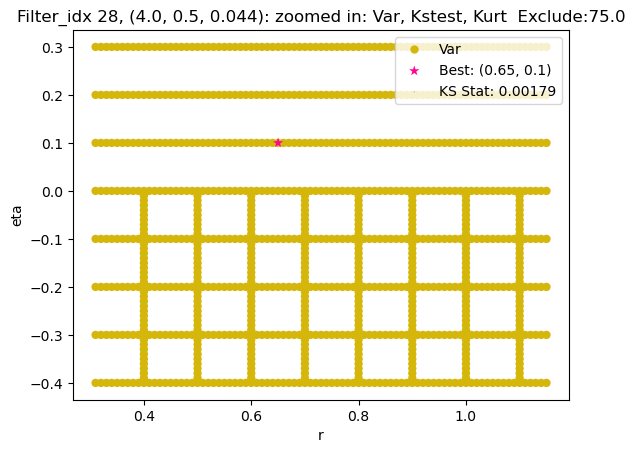

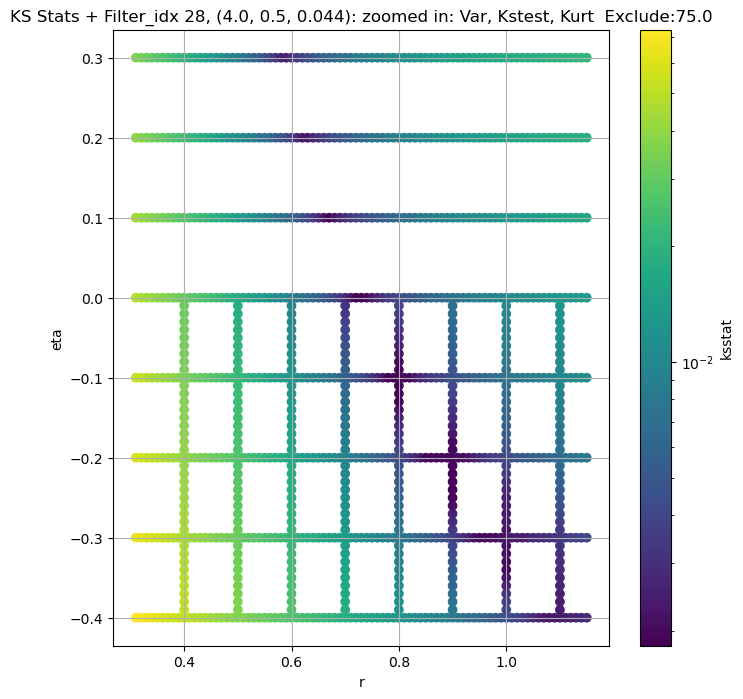

Filter_idx 29, (4.0, 0.5, 0.065):


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 29, 100.0 + 100 = 200, ksstat: 0.002937314224400467, var: 5654.527726388245


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 29, 100.0 + 75 = 175, ksstat: 0.002662480321134586, var: 5733.347038537561


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 29, 100.0 + 50 = 150, ksstat: 0.002391139570962264, var: 5818.578957818354


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 29, 100.0 + 25 = 125, ksstat: 0.0020987752831772566, var: 5911.712918840884


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 29, 100.0 + 0 = 100, ksstat: 0.0018130393558580815, var: 6014.935116677389


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 29, 100.0 + -25 = 75, ksstat: 0.0015355186607953226, var: 6131.822038725838


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 29, 100.0 + -50 = 50, ksstat: 0.001453857504190692, var: 6268.8327786850305


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 29, 100.0 + -75 = 25, ksstat: 0.002138739353683028, var: 6440.017399106541


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 29, 100.0 + -100 = 0, ksstat: 0.0032833885588728906, var: 6728.662667856983
Number of samples: 100000, Without approximation : 136161000.0


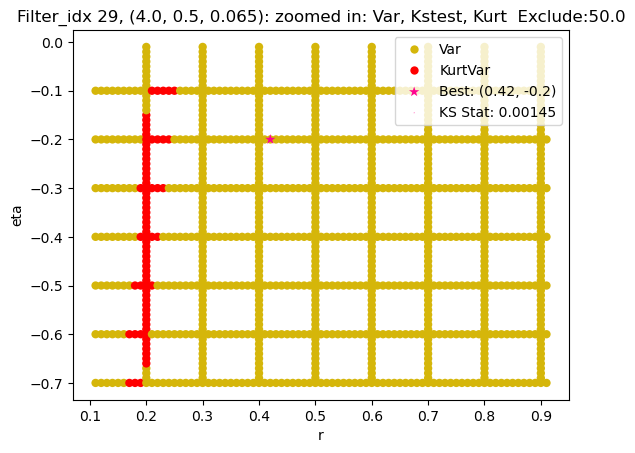

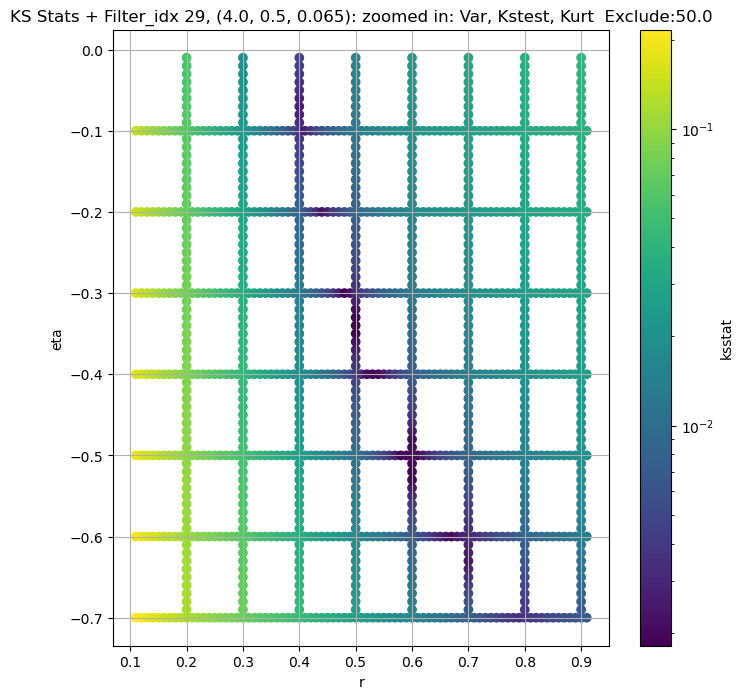

Filter_idx 30, (4.0, 0.5, 0.096):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 30, 0.0 + 100 = 100, ksstat: 0.003428856936953495, var: 1843.9887726024197


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 30, 0.0 + 75 = 75, ksstat: 0.003315109899102331, var: 1898.4577655656515


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 30, 0.0 + 50 = 50, ksstat: 0.0025801524808997667, var: 1962.9626100081314


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 30, 0.0 + 25 = 25, ksstat: 0.0015539389033812911, var: 2042.8764002303271


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 30, 0.0 + 0 = 0, ksstat: 0.0016365882383175268, var: 2174.2950657251185
Number of samples: 100000, Without approximation : 136161000.0


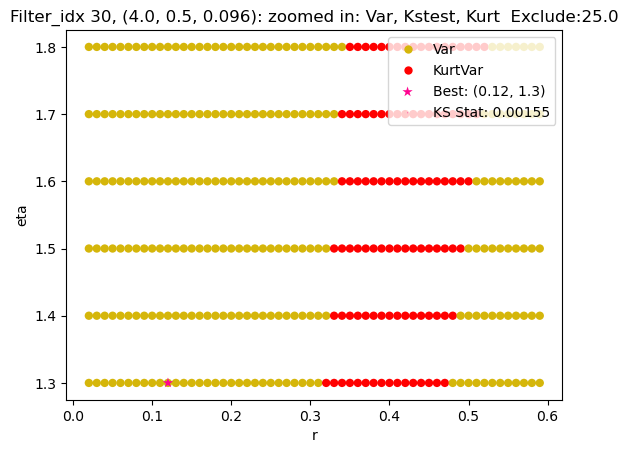

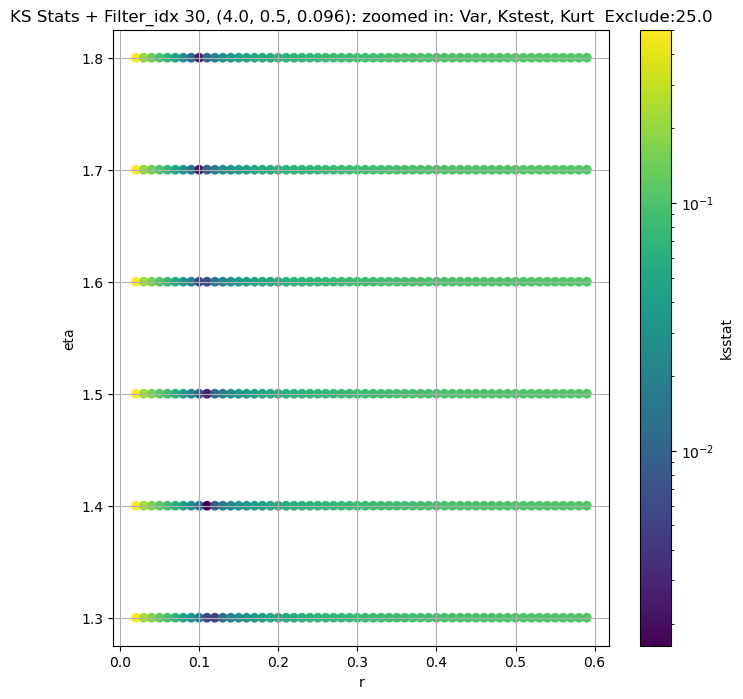

Filter_idx 31, (4.0, 0.5, 0.141):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 50.0 + 100 = 150, ksstat: 0.005139349271015711, var: 333.56198445535165


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 50.0 + 75 = 125, ksstat: 0.004130019740222889, var: 343.0719219009785


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 50.0 + 50 = 100, ksstat: 0.00351389528401036, var: 353.7276937156897


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 50.0 + 25 = 75, ksstat: 0.002983107501764226, var: 365.87181657461105


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 50.0 + 0 = 50, ksstat: 0.0024308446475395235, var: 380.0858256257585


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 50.0 + -25 = 25, ksstat: 0.002548494350563535, var: 397.77598665807926


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 50.0 + -50 = 0, ksstat: 0.0024083843898589086, var: 440.2984572847581
Number of samples: 100000, Without approximation : 136161000.0


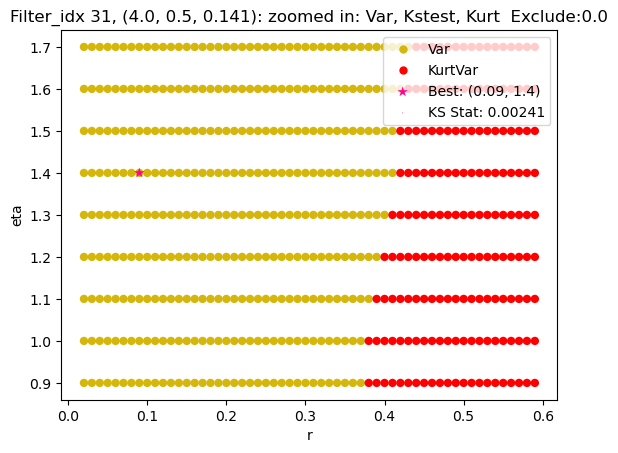

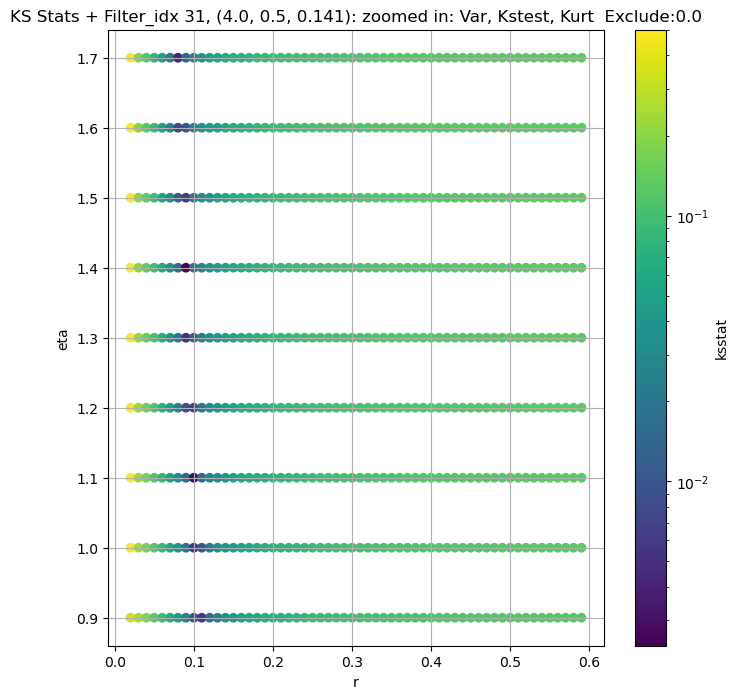

Filter_idx 32, (4.0, 0.5, 0.208):


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 32, 200.0 + 100 = 300, ksstat: 0.00697245285111181, var: 25.52236596990208


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 32, 200.0 + 75 = 275, ksstat: 0.006613224573182475, var: 26.046531101353807


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 32, 200.0 + 50 = 250, ksstat: 0.006293634620331057, var: 26.611562083095798


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 32, 200.0 + 25 = 225, ksstat: 0.0056687060113653764, var: 27.22450235931307


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 32, 200.0 + 0 = 200, ksstat: 0.005160433347011929, var: 27.894820252588136


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 32, 200.0 + -25 = 175, ksstat: 0.005017063579342791, var: 28.635211293709524


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 32, 200.0 + -50 = 150, ksstat: 0.004576944412649331, var: 29.463349606564343


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 32, 200.0 + -75 = 125, ksstat: 0.004476039588621389, var: 30.40687751985795


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 32, 200.0 + -100 = 100, ksstat: 0.005062811839999737, var: 31.509890171118233
Number of samples: 100000, Without approximation : 136161000.0


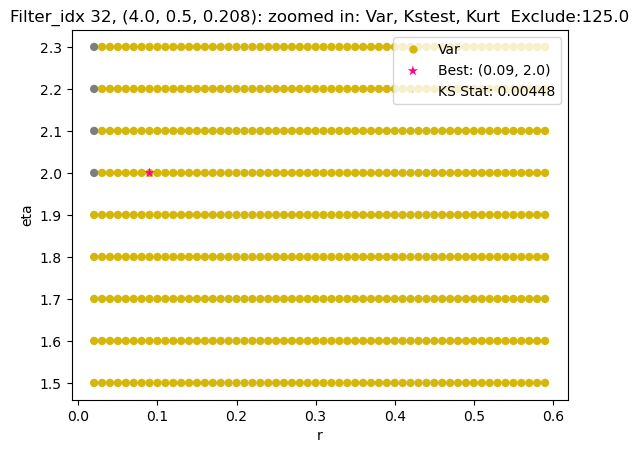

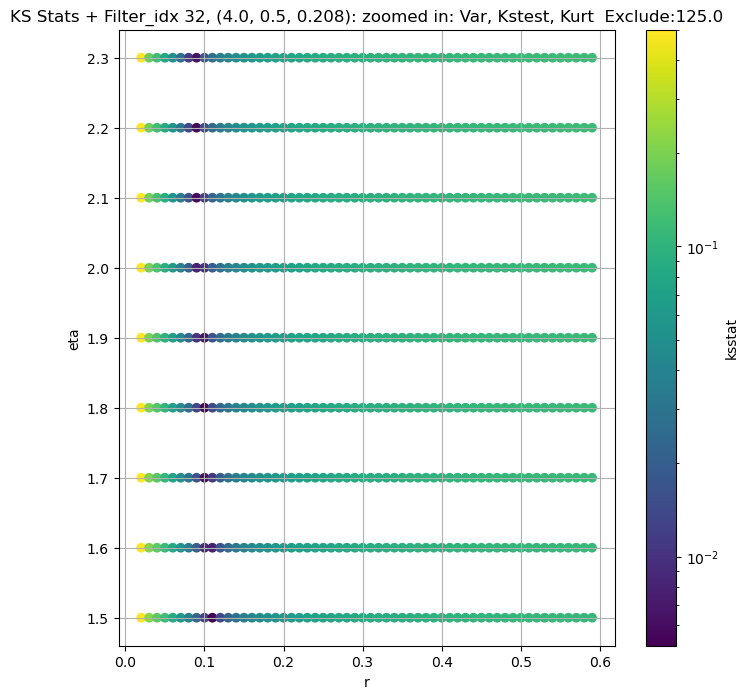

Filter_idx 33, (4.0, 0.5, 0.306):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 33, 200.0 + 100 = 300, ksstat: 0.0075400844322001115, var: 11.00384290958002


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 33, 200.0 + 75 = 275, ksstat: 0.007322937178864897, var: 11.208847895024599


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 33, 200.0 + 50 = 250, ksstat: 0.006979639741901855, var: 11.427079341877379


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 33, 200.0 + 25 = 225, ksstat: 0.006399749660655818, var: 11.660598698744781


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 33, 200.0 + 0 = 200, ksstat: 0.006095237181229951, var: 11.911849865569206


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 33, 200.0 + -25 = 175, ksstat: 0.005588399594794135, var: 12.18423601059263


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 33, 200.0 + -50 = 150, ksstat: 0.0060820118274362844, var: 12.4824614781641


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 33, 200.0 + -75 = 125, ksstat: 0.006154169364655626, var: 12.813303712057584


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 33, 200.0 + -100 = 100, ksstat: 0.006097866804066376, var: 13.187443044488834
Number of samples: 100000, Without approximation : 136161000.0


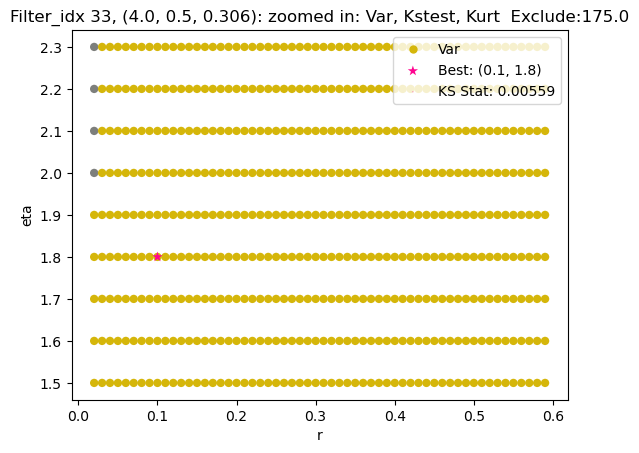

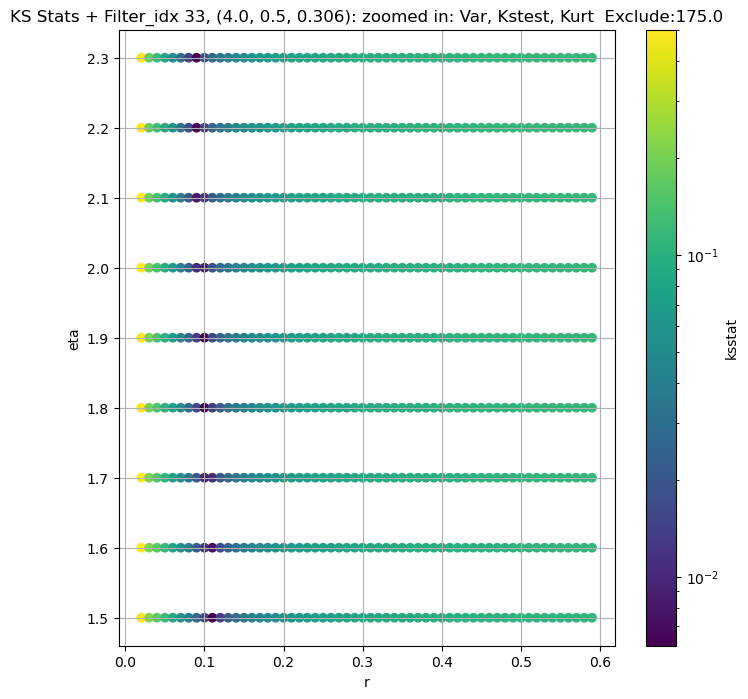

Filter_idx 34, (4.0, 0.5, 0.45):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 200.0 + 100 = 300, ksstat: 0.006468547313300377, var: 5.371723218838242


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 200.0 + 75 = 275, ksstat: 0.0062047164937754085, var: 5.462153947742491


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 200.0 + 50 = 250, ksstat: 0.005796941448353077, var: 5.557595110571129


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 200.0 + 25 = 225, ksstat: 0.00543385586849765, var: 5.658645842191955


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 200.0 + 0 = 200, ksstat: 0.0050619765766311, var: 5.7661535753618125


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 200.0 + -25 = 175, ksstat: 0.004787428802026761, var: 5.881200602647315


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 200.0 + -50 = 150, ksstat: 0.004503493921185542, var: 6.005123832249928


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 200.0 + -75 = 125, ksstat: 0.004907477550647077, var: 6.139718919270462


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 200.0 + -100 = 100, ksstat: 0.005247986505885094, var: 6.287698761238738
Number of samples: 100000, Without approximation : 136161000.0


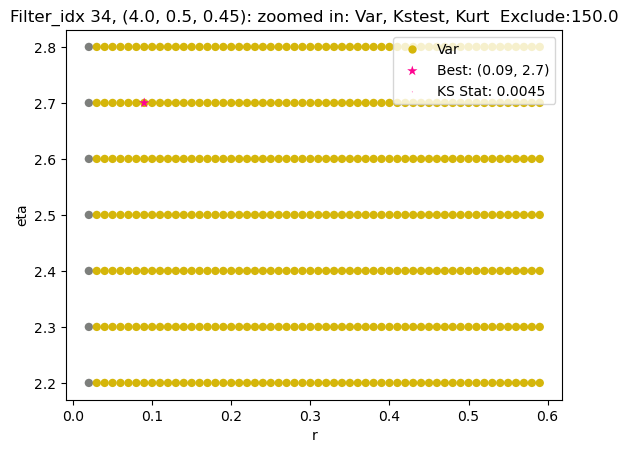

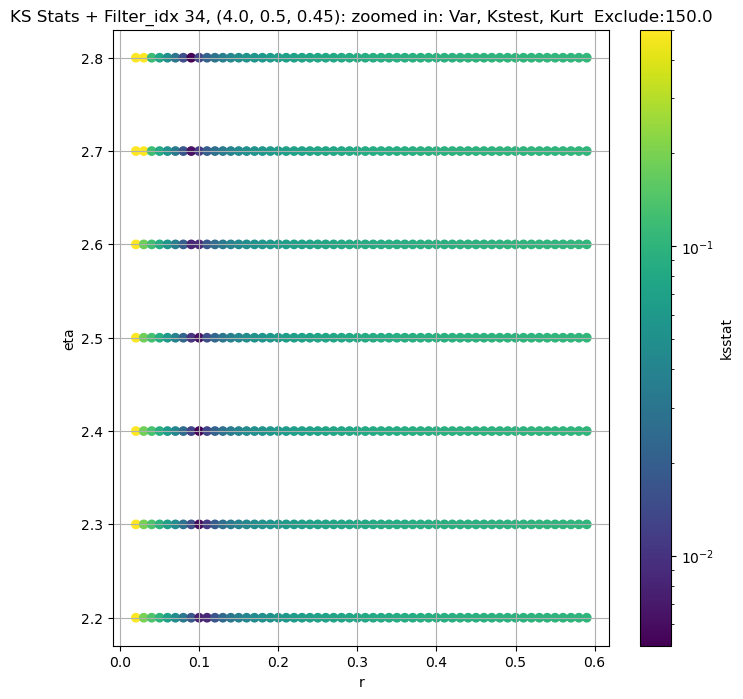

Filter_idx 35, (4.0, 1.0, 0.044):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 35, 50.0 + 100 = 150, ksstat: 0.0023981958228898037, var: 21072.508986064753


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 35, 50.0 + 75 = 125, ksstat: 0.002047935424506764, var: 21337.905519084754


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 35, 50.0 + 50 = 100, ksstat: 0.0017325796465460508, var: 21629.303227488537


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 35, 50.0 + 25 = 75, ksstat: 0.0015101797369514447, var: 21954.32008301133


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 35, 50.0 + 0 = 50, ksstat: 0.0011800033384401134, var: 22327.32167794589


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 35, 50.0 + -25 = 25, ksstat: 0.001851666758546755, var: 22776.88639722179


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 35, 50.0 + -50 = 0, ksstat: 0.0029021831889606553, var: 23481.683202374305
Number of samples: 100000, Without approximation : 136161000.0


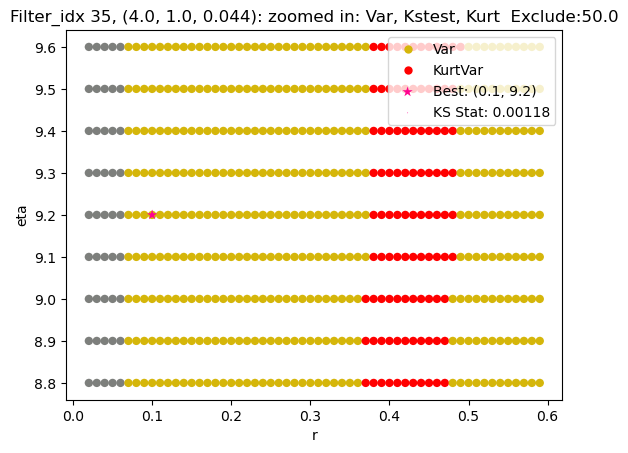

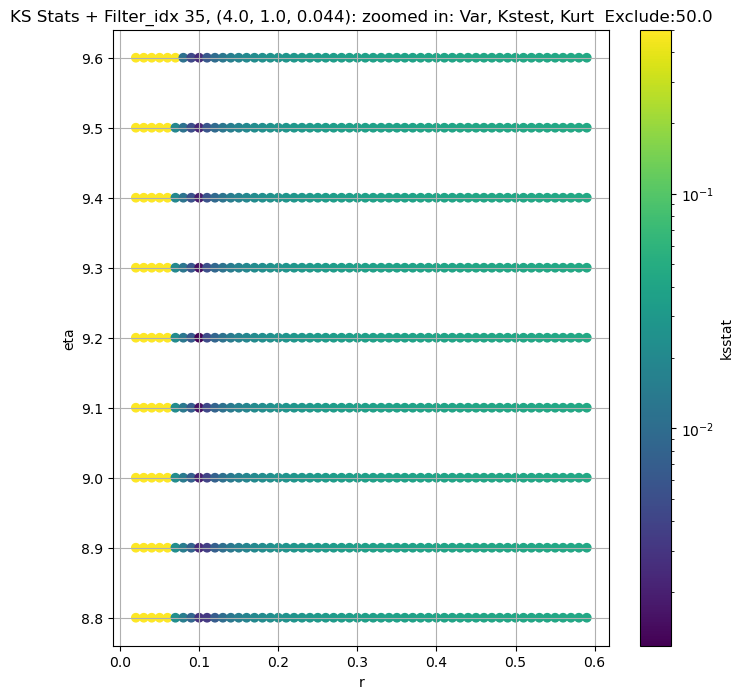

Filter_idx 36, (4.0, 1.0, 0.065):


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 36, 50.0 + 100 = 150, ksstat: 0.002379868128471699, var: 6246.973625424242


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 36, 50.0 + 75 = 125, ksstat: 0.002030439799610817, var: 6341.8556484092205


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 36, 50.0 + 50 = 100, ksstat: 0.0016490485412056222, var: 6447.449415991868


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 36, 50.0 + 25 = 75, ksstat: 0.0013379664462209728, var: 6567.673931957421


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 36, 50.0 + 0 = 50, ksstat: 0.001007325056339492, var: 6709.078412905789


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 36, 50.0 + -25 = 25, ksstat: 0.0010835422781061144, var: 6886.221216346353


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 36, 50.0 + -50 = 0, ksstat: 0.0022945809290014912, var: 7210.980530068478
Number of samples: 100000, Without approximation : 136161000.0


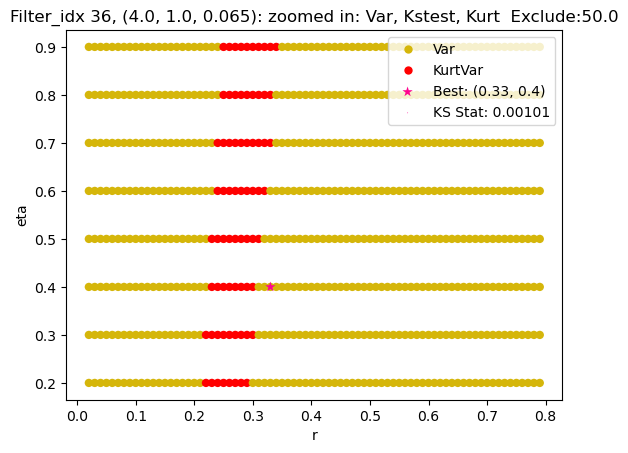

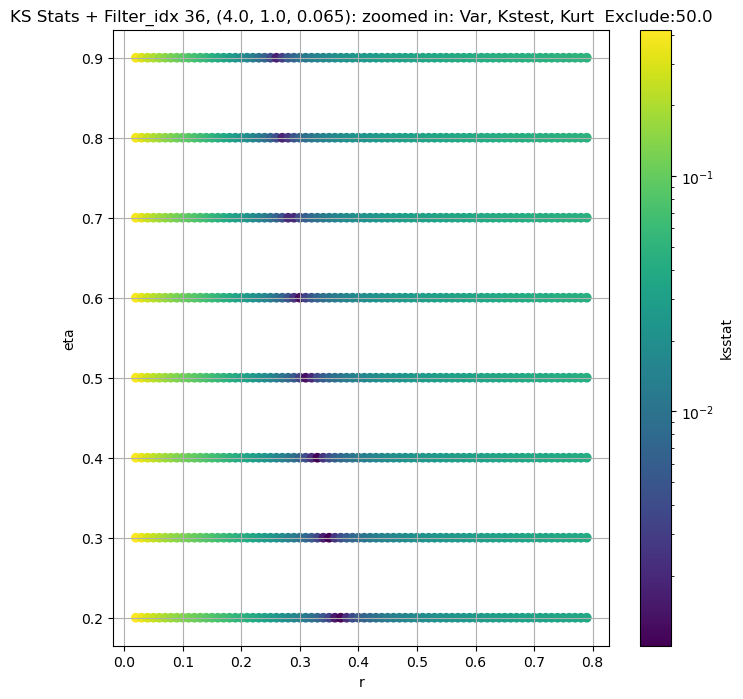

Filter_idx 37, (4.0, 1.0, 0.096):


  0%|          | 0/684 [00:00<?, ?it/s]

Finding Minimum after computing 684 CDFs
filter_idx 37, 50.0 + 100 = 150, ksstat: 0.00323841261676705, var: 1730.1506763835328


  0%|          | 0/684 [00:00<?, ?it/s]

Finding Minimum after computing 684 CDFs
filter_idx 37, 50.0 + 75 = 125, ksstat: 0.0028411606815805894, var: 1766.0195078175


  0%|          | 0/684 [00:00<?, ?it/s]

Finding Minimum after computing 684 CDFs
filter_idx 37, 50.0 + 50 = 100, ksstat: 0.0023704979546309776, var: 1806.4077409944566


  0%|          | 0/684 [00:00<?, ?it/s]

Finding Minimum after computing 684 CDFs
filter_idx 37, 50.0 + 25 = 75, ksstat: 0.0018673613287614188, var: 1853.1872630699127


  0%|          | 0/684 [00:00<?, ?it/s]

Finding Minimum after computing 684 CDFs
filter_idx 37, 50.0 + 0 = 50, ksstat: 0.0015703532724715696, var: 1909.8994342976696


  0%|          | 0/684 [00:00<?, ?it/s]

Finding Minimum after computing 684 CDFs
filter_idx 37, 50.0 + -25 = 25, ksstat: 0.001160522548899423, var: 1985.5071020139992


  0%|          | 0/684 [00:00<?, ?it/s]

Finding Minimum after computing 684 CDFs
filter_idx 37, 50.0 + -50 = 0, ksstat: 0.0028018300679329977, var: 2145.196983360842
Number of samples: 100000, Without approximation : 136161000.0


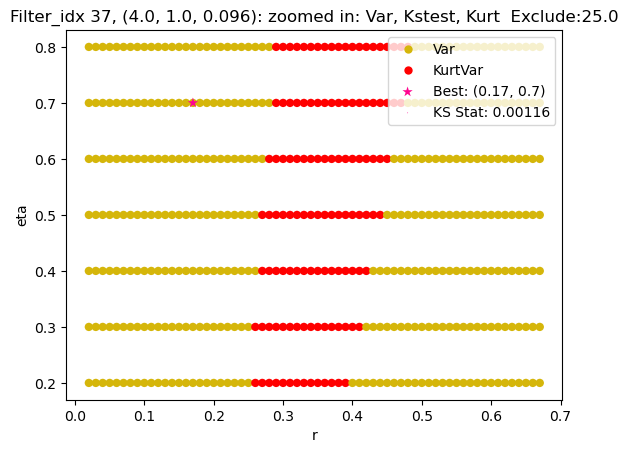

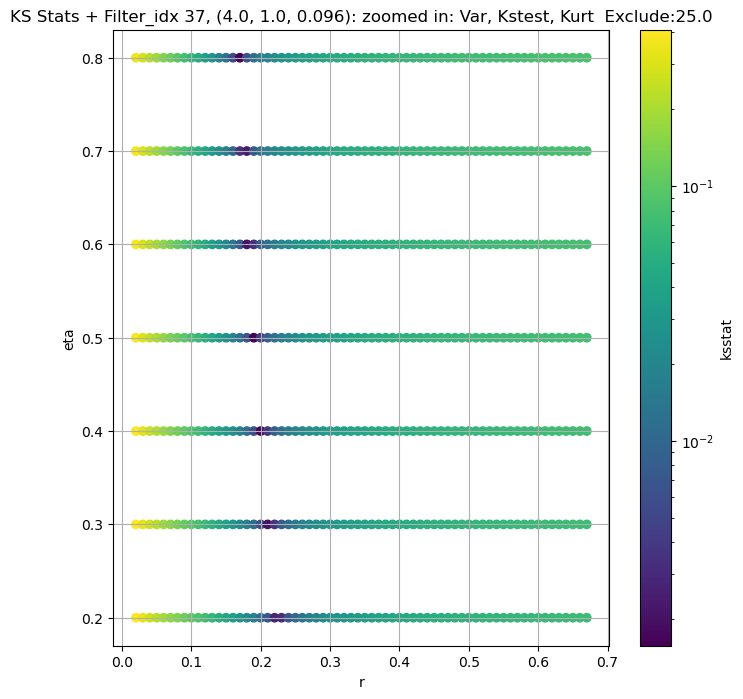

Filter_idx 38, (4.0, 1.0, 0.141):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 38, 100.0 + 100 = 200, ksstat: 0.005300740185671858, var: 344.82599538036783


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 38, 100.0 + 75 = 175, ksstat: 0.004398880436809249, var: 353.7530974621728


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 38, 100.0 + 50 = 150, ksstat: 0.0038709659647672146, var: 363.71717585357055


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 38, 100.0 + 25 = 125, ksstat: 0.003298665863960999, var: 374.9884450326394


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 38, 100.0 + 0 = 100, ksstat: 0.0026131671465408346, var: 387.93697947406883


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 38, 100.0 + -25 = 75, ksstat: 0.002042399887353108, var: 403.12996526058504


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 38, 100.0 + -50 = 50, ksstat: 0.0020036718203644277, var: 421.48905785742835


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 38, 100.0 + -75 = 25, ksstat: 0.002418347355405359, var: 445.00340824395516


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 38, 100.0 + -100 = 0, ksstat: 0.00418230596585889, var: 497.9098207081813
Number of samples: 100000, Without approximation : 136161000.0


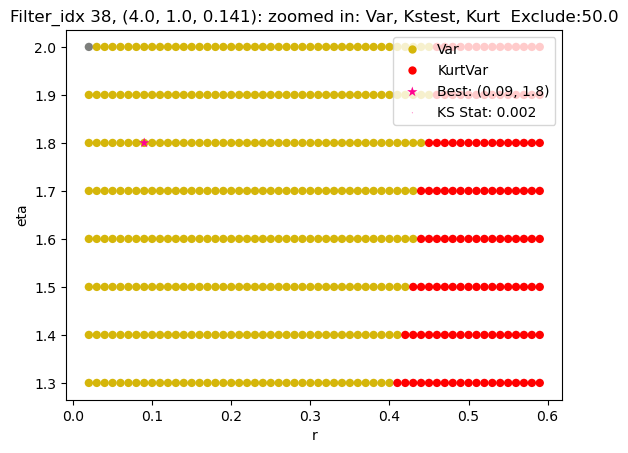

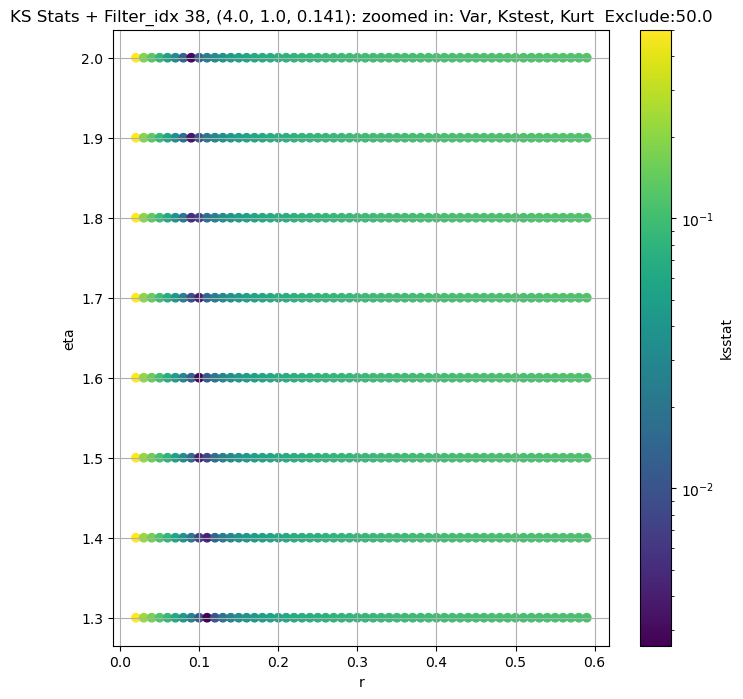

Filter_idx 39, (4.0, 1.0, 0.208):


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 39, 200.0 + 100 = 300, ksstat: 0.006727270661376711, var: 30.985272015561712


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 39, 200.0 + 75 = 275, ksstat: 0.006036248108082787, var: 31.669586539118697


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 39, 200.0 + 50 = 250, ksstat: 0.005687199390717938, var: 32.412566860886365


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 39, 200.0 + 25 = 225, ksstat: 0.005174194870193386, var: 33.22478890090816


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 39, 200.0 + 0 = 200, ksstat: 0.004645276724031561, var: 34.119987986094436


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 39, 200.0 + -25 = 175, ksstat: 0.00418899245467419, var: 35.11648125108905


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 39, 200.0 + -50 = 150, ksstat: 0.00468053492848397, var: 36.23949284725087


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 39, 200.0 + -75 = 125, ksstat: 0.005075593168890169, var: 37.52692453171496


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 39, 200.0 + -100 = 100, ksstat: 0.004890710125000419, var: 39.03789091667893
Number of samples: 100000, Without approximation : 136161000.0


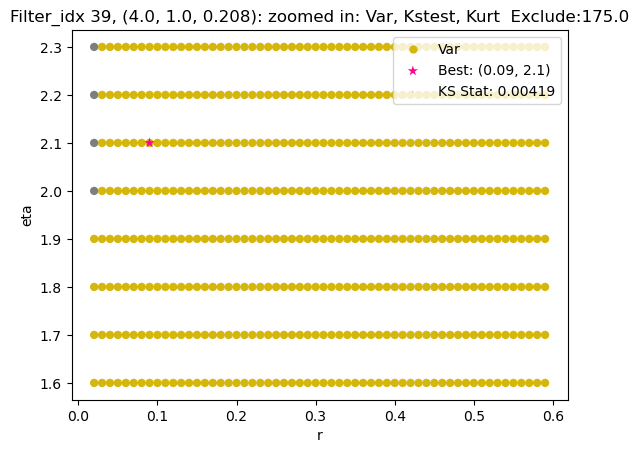

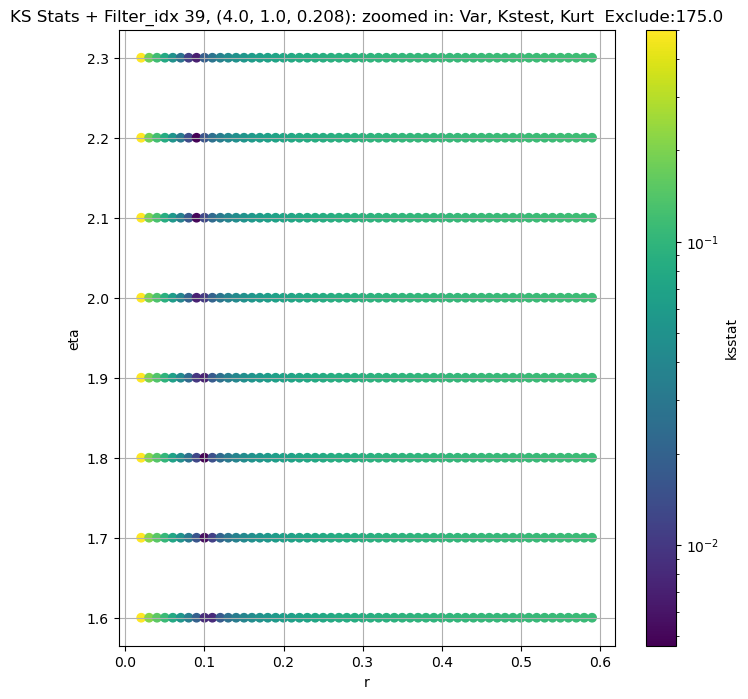

Filter_idx 40, (4.0, 1.0, 0.306):


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 40, 200.0 + 100 = 300, ksstat: 0.00910624438626817, var: 10.263871548928991


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 40, 200.0 + 75 = 275, ksstat: 0.009802085629426915, var: 10.509724026429407


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 40, 200.0 + 50 = 250, ksstat: 0.00982294909785919, var: 10.775385857771923


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 40, 200.0 + 25 = 225, ksstat: 0.009897055889015571, var: 11.064389782282728


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 40, 200.0 + 0 = 200, ksstat: 0.010447474252082811, var: 11.381341138066013


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 40, 200.0 + -25 = 175, ksstat: 0.010235192223124662, var: 11.732707287655881


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 40, 200.0 + -50 = 150, ksstat: 0.011148924881644984, var: 12.127268720896664


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 40, 200.0 + -75 = 125, ksstat: 0.012363654952306513, var: 12.577559952430105


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 40, 200.0 + -100 = 100, ksstat: 0.012252737321540669, var: 13.103297868830493
Number of samples: 100000, Without approximation : 136161000.0


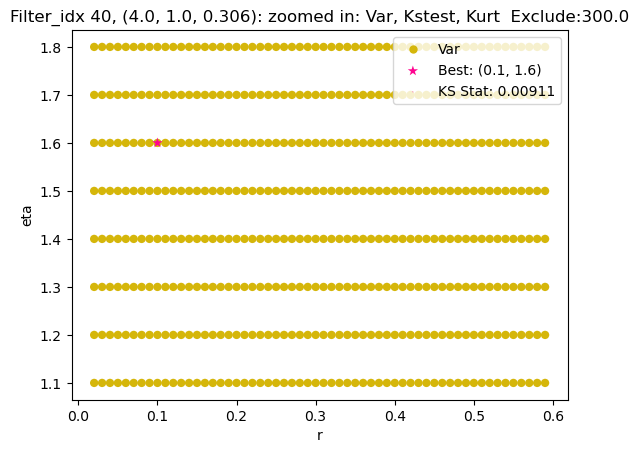

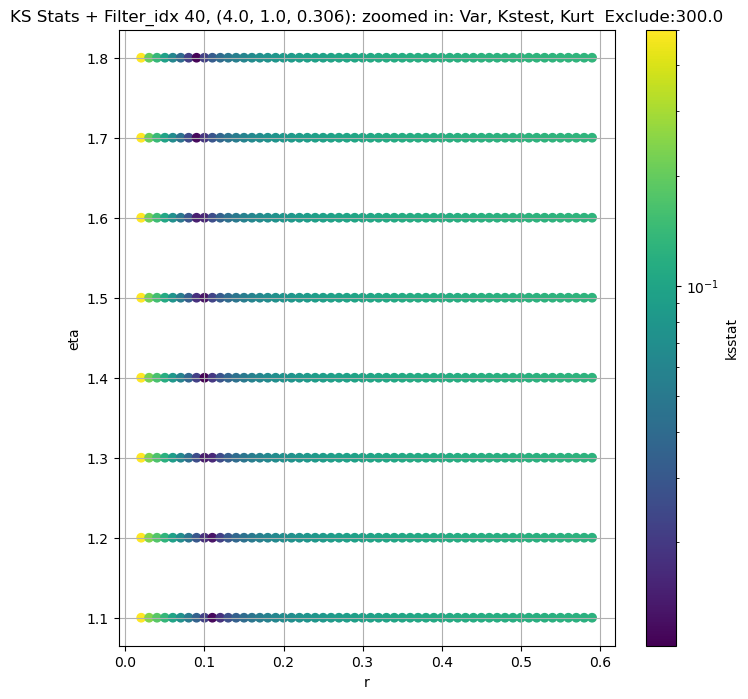

Filter_idx 41, (4.0, 1.0, 0.45):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 200.0 + 100 = 300, ksstat: 0.011840256221574808, var: 4.579753355666269


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 200.0 + 75 = 275, ksstat: 0.013298522662282708, var: 4.6975418940184035


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 200.0 + 50 = 250, ksstat: 0.01283671819883575, var: 4.824860611678761


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 200.0 + 25 = 225, ksstat: 0.012743122554874642, var: 4.963046885172426


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 200.0 + 0 = 200, ksstat: 0.013736758850721897, var: 5.113788967259275


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 200.0 + -25 = 175, ksstat: 0.014246053156906885, var: 5.279288504194882


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 200.0 + -50 = 150, ksstat: 0.014896563899783888, var: 5.462324140599895


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 200.0 + -75 = 125, ksstat: 0.014980433018946249, var: 5.66661447585759


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 200.0 + -100 = 100, ksstat: 0.015831927921471756, var: 5.897408554747421
Number of samples: 100000, Without approximation : 136161000.0


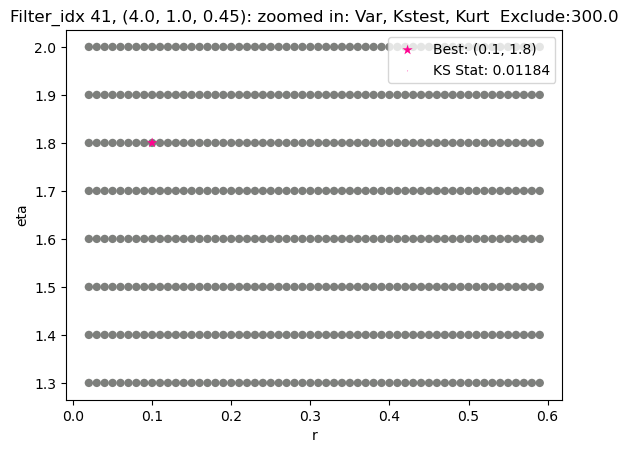

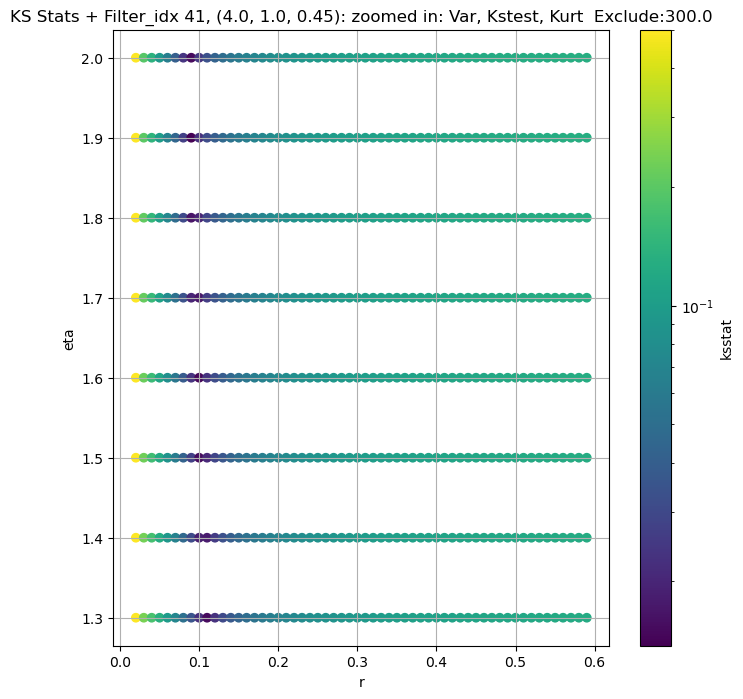

,params,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,...,initial_scale,initial_exclude_cutoff,best_augmented_var,kstest_stat_cutoff_0.05,kstest_stat_best,best_r,best_eta,best_scale,best_exclude_cutoff,n_pval_0.05
filter_idx,,,,,,,,,,,,,,,,,,,,,
0,"(2.0, 0.5, 0.044)",24111.888294,19052.401645,30447.957447,5.579921,2.075283,14.192461,136161000.0,"(2.0, 0.5, 0.044)",0.003550,...,2.205116e+04,200.0,22016.318736,0.000116,0.002945,0.99,-0.40,1.971584e+04,125.0,224383
1,"(2.0, 0.5, 0.065)",11877.167756,8706.483888,16085.379803,10.964418,5.169127,17.980163,136161000.0,"(2.0, 0.5, 0.065)",0.005938,...,1.653819e+03,200.0,9764.085897,0.000116,0.004414,0.50,-0.46,1.524114e+03,225.0,99726
2,"(2.0, 0.5, 0.096)",4272.713551,3134.622665,5762.139707,12.807588,6.852190,22.106602,136161000.0,"(2.0, 0.5, 0.096)",0.004213,...,1.565653e+01,200.0,3603.677217,0.000116,0.003966,0.30,-0.31,1.631141e+01,175.0,112191
3,"(2.0, 0.5, 0.141)",1078.932665,776.505441,1487.405395,14.176789,6.576698,46.788592,136161000.0,"(2.0, 0.5, 0.141)",0.004014,...,1.375636e-02,50.0,1034.641004,0.000116,0.002770,0.20,-0.01,1.453527e-02,25.0,252430
4,"(2.0, 0.5, 0.208)",218.209237,150.523220,373.627688,26.427271,6.846993,183.210028,136161000.0,"(2.0, 0.5, 0.208)",0.003010,...,1.272019e-13,0.0,218.209237,0.000116,0.002552,0.11,1.10,1.760678e-11,0.0,299181
5,"(2.0, 0.5, 0.306)",39.820943,25.610523,77.371432,48.922184,6.457623,273.277159,136161000.0,"(2.0, 0.5, 0.306)",0.003506,...,3.150340e-14,0.0,39.820943,0.000116,0.002876,0.09,1.60,7.516523e-17,0.0,224383
6,"(2.0, 0.5, 0.45)",19.318296,12.843038,45.810489,58.404167,6.968506,329.241909,136161000.0,"(2.0, 0.5, 0.45)",0.003977,...,4.103220e-15,50.0,17.298086,0.000116,0.003890,0.09,2.00,9.915616e-18,25.0,126214
7,"(2.0, 1.0, 0.044)",29661.968209,24103.130769,37590.664964,5.471542,1.646046,19.096018,136161000.0,"(2.0, 1.0, 0.044)",0.001471,...,1.186923e+03,50.0,28201.286850,0.000116,0.001436,0.48,0.80,8.712422e+02,50.0,897543
8,"(2.0, 1.0, 0.065)",14517.113438,10519.183070,19456.750483,12.431846,4.327867,26.223462,136161000.0,"(2.0, 1.0, 0.065)",0.004106,...,1.117933e+03,200.0,12100.943431,0.000116,0.003226,0.38,0.20,1.546369e+02,175.0,179704


In [29]:
master_df_optimized_path = Path(os.path.join(CWD, "CSVs", 'master_df_optimized.csv'))

NUM_ITERS = dict(zip(GROUPS, [1]*len(GROUPS))) # By default, does one iteration per group
NUM_SAMPLES_OPTIMIZE = 2000
EXCLUDE_CUTOFFS_OPTIMIZE = np.arange(100, -101, -25)

if RERUN or not master_df_optimized_path.exists():

    if SKIP_OPTIMIZE_STEP:

        master_df['kstest_stat_best'] = master_df['kstest_stat_initial']
        master_df[f'best_r'] = master_df['initial_r']
        master_df[f'best_eta'] = master_df['initial_eta']
        master_df[f'best_scale'] = master_df['initial_scale']
        master_df[f'best_exclude_cutoff'] = master_df['initial_exclude_cutoff']

    else:
        for group in GROUPS: # TODO For quick testing purposes
            print(f"{GROUP.capitalize()} {group}, {str(filter_group_map[group])}:")
            master_df.loc[group, 'kstest_stat_best'] = master_df.loc[group, 'kstest_stat_initial']
            master_df.loc[group, 'best_r'] = master_df.loc[group, 'initial_r']
            master_df.loc[group, 'best_eta'] = master_df.loc[group, 'initial_eta']
            master_df.loc[group, 'best_scale'] = master_df.loc[group, 'initial_scale']

            sample = group_data_map[group]
            if len(sample) == 0:
                continue
            initial_r, initial_eta = master_df.loc[group, 'initial_r'], master_df.loc[group, f'initial_eta']
            eps = 0.5
            group_cdfs_df = fine_cdfs_df[(np.abs(master_df.loc[group, 'initial_r'] - fine_cdfs_df['r']) < eps) & 
                                        (np.abs(master_df.loc[group, 'initial_eta'] - fine_cdfs_df['eta']) < eps)].reset_index(drop=True)
            group_cdfs = {x[0]:x[1] for x in group_cdfs_df['(r,eta),cdf']}

            for adjust_exclude_cutoff in EXCLUDE_CUTOFFS_OPTIMIZE: # -50, -25, 0, 25, 50
                
                exclude_cutoff = int(max(0, adjust_exclude_cutoff + master_df.loc[group, 'initial_exclude_cutoff']))
                
                if exclude_cutoff == 0:
                    augmented_var = np.var(group_data_map[group])
                else:
                    augmented_var = np.var(group_data_map[group][exclude_cutoff:-exclude_cutoff])                       

                group_cdfs_df['scale'] = np.clip((augmented_var / group_cdfs_df['variance']), 0,  SCALE_CAP)
                ksstats, initial_param, min_stat = gridsearch(sample, group_cdfs, debug=True, scales=group_cdfs_df['scale'])
                
                cutoff_label = generate_cutoff_label(adjust_exclude_cutoff)

                augmented_var_df.loc[group, f"kstest_stat_{cutoff_label}"] = min_stat
                group_cdfs_df[f'ksstat_exclude_{cutoff_label}'] = ksstats
                
                print(f"{GROUP} {group}, {master_df.loc[group, 'initial_exclude_cutoff']} + {adjust_exclude_cutoff} = {exclude_cutoff}, ksstat: {min_stat}, var: {augmented_var}")
                best_adjust = 0

                if min_stat < master_df.loc[group, 'kstest_stat_best']:

                    inital_min_stat = min_stat
                    inital_best_param = initial_param
                    master_df.loc[group, 'kstest_stat_best'] = min_stat
                    initial_scale = group_cdfs_df.loc[(group_cdfs_df["r"] ==  initial_param[0]) & (group_cdfs_df["eta"] ==  initial_param[1])]["scale"].iloc[0]
                    master_df.loc[group, 'best_r'], master_df.loc[group, 'best_eta'] = initial_param
                    master_df.loc[group, 'best_scale'] = initial_scale
                    master_df.loc[group, 'best_exclude_cutoff'] = exclude_cutoff
                    master_df.loc[group, 'best_augmented_var'] = augmented_var
                    augmented_var_df.loc[group, 'best_augmented_var'] = augmented_var
                    best_adjust = adjust_exclude_cutoff

                if exclude_cutoff == 0:
                    break

            cutoff_label = generate_cutoff_label(best_adjust)
            ksstats = group_cdfs_df[f"ksstat_exclude_{cutoff_label}"]
            
            print(f"Number of samples: {sample.size}, Without approximation : {master_df.loc[group, 'total_samples']}")
            
            cutoff = stats.kstwo(n=master_df.loc[group, 'total_samples']).isf(0.05)
            master_df.loc[group, 'kstest_stat_cutoff_0.05'] = cutoff

            best_scales = np.clip((master_df.loc[group, 'best_augmented_var'] / group_cdfs_df['variance']), 0,  SCALE_CAP)

            group_cdfs_df['variance'] = group_cdfs_df['variance'] * best_scales
            group_cdfs_df['kurtosis'] = group_cdfs_df['kurtosis'] * best_scales

            group_cdfs_df = add_tests_to_df(cdfs_df = group_cdfs_df, group = group, var_kurt_df = master_df, ksstats = ksstats).sort_values(['r', 'eta'])

            group_dict = rEtaKsstats_dict[group]
            group_dict.update({'r_optimize' : group_cdfs_df['r'], 'eta_optimize' : group_cdfs_df['eta'], f'ksstat_exclude_{cutoff_label}' : ksstats})
            rEtaKsstats_dict[group] = group_dict

            cols = ['pass_var', 'pass_kstest', 'pass_kurt']
            fig = combo_test_plot(group_cdfs_df, cols, 
                                plot_name=f"{GROUP.capitalize()} {group}, {str(filter_group_map[group])}: zoomed in: {', '.join([col[5:].capitalize() for col in cols])}  Exclude:{master_df.loc[group, 'best_exclude_cutoff']}",
                                best_param=(master_df.loc[group, 'best_r'], master_df.loc[group, f'best_eta']),
                                best_ksstat=master_df.loc[group, 'kstest_stat_best'])
            fig.figure.savefig(os.path.join(CWD, "plots", f"optimized_full_grid_search_combo_plot_layer{group}.jpg"), bbox_inches = 'tight', dpi=100)
            
    master_df['n_pval_0.05'] = master_df.apply(lambda row : find_n_fixed_pval_stat(row.loc['kstest_stat_best'], row.loc['total_samples']), axis = 1)    
    master_df[['total_samples', 'initial_r', 'initial_eta', 'kstest_stat_initial', 'initial_exclude_cutoff', 'best_r', 'best_eta', 'best_scale', 'kstest_stat_best', 'best_exclude_cutoff', 'n_pval_0.05']].to_csv(os.path.join(CWD, "CSVs", 'optimized_params.csv'))
    master_df.to_csv(os.path.join(CWD, "CSVs", 'master_df_optimized.csv'))
    augmented_var_df.to_csv(augmented_var_df_path)
    pd.to_pickle(rEtaKsstats_dict, rEtaKsstats_dict_path)

rEtaKsstats_dict = pd.read_pickle(rEtaKsstats_dict_path)
master_df = pd.read_csv(master_df_optimized_path, index_col = GROUP)
augmented_var_df = pd.read_csv(augmented_var_df_path, index_col = GROUP)
master_df

## Comparing Empirical and Computed CDF/PDF

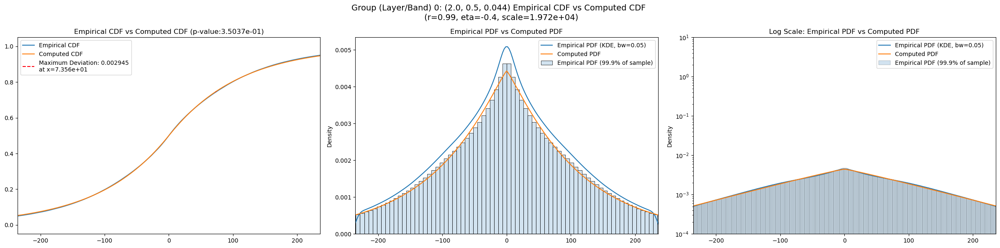

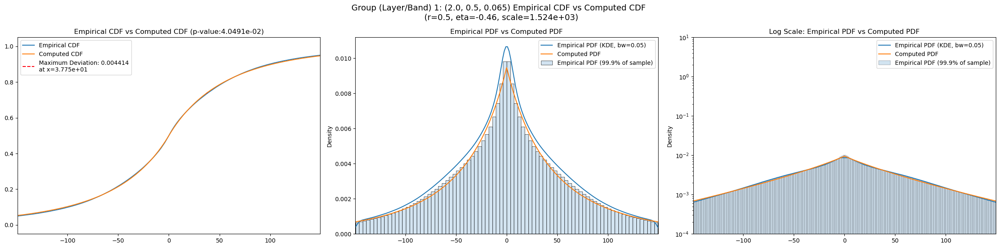

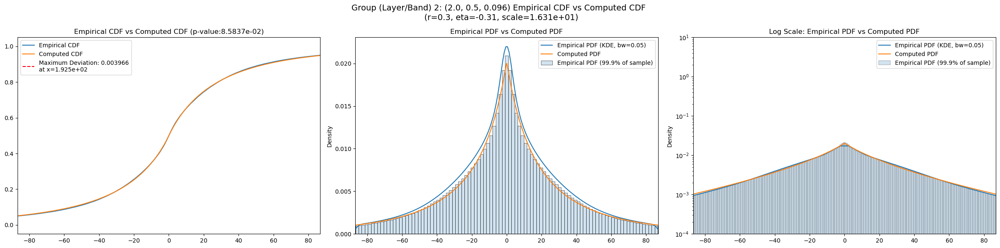

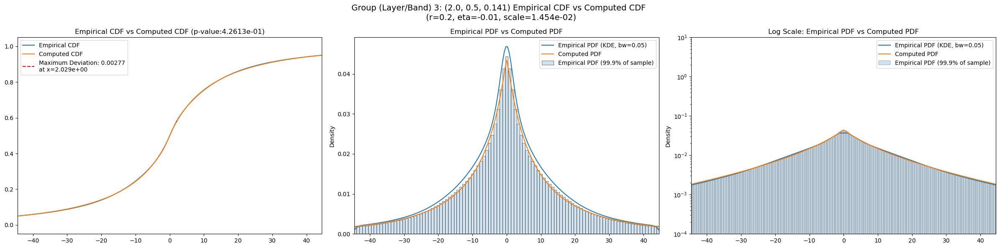

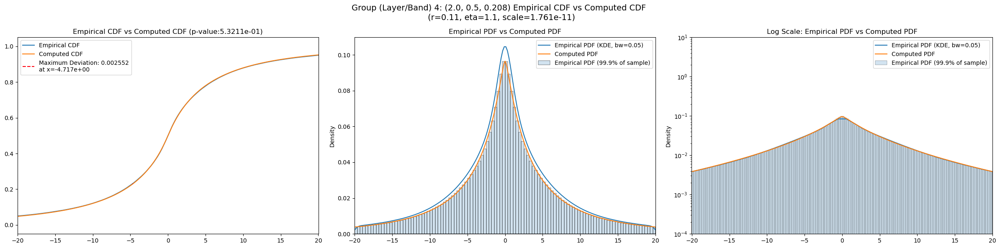

...

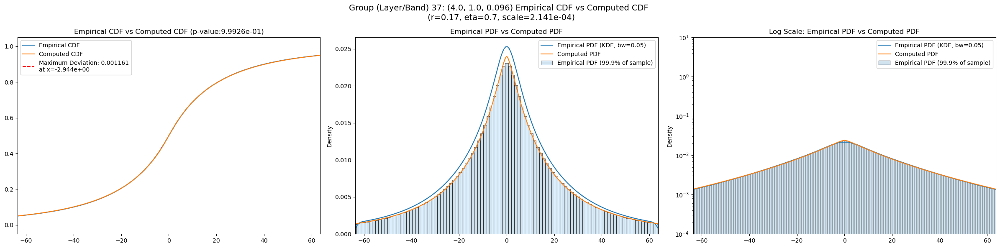

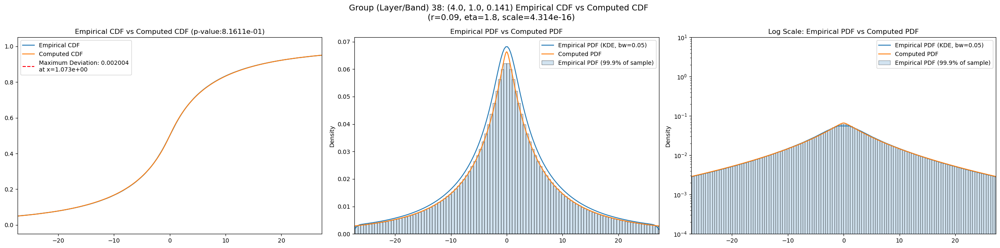

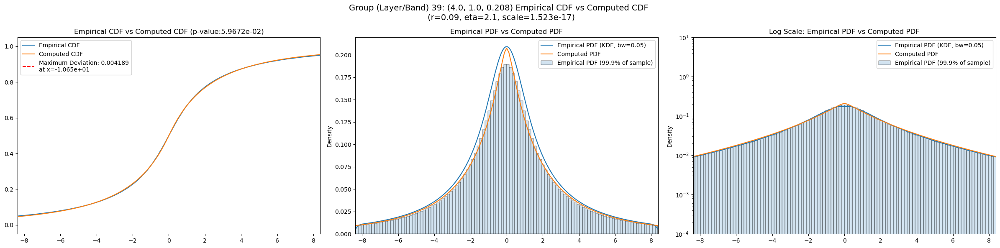

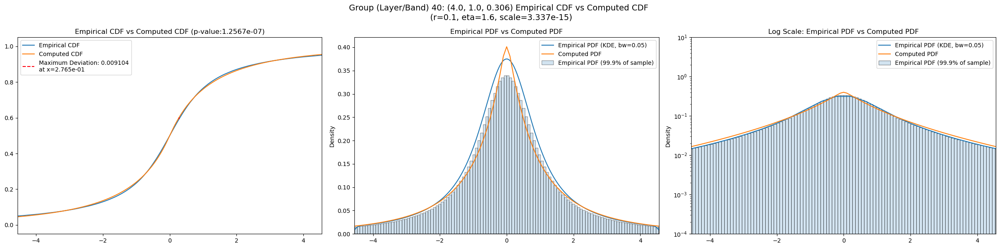

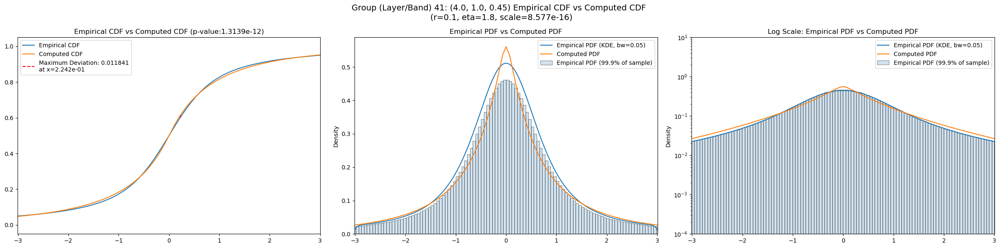

In [30]:
for group in GROUPS:
    group_info = master_df.loc[group]
    best_r = group_info['best_r']
    best_eta = group_info['best_eta']
    best_scale = group_info['best_scale']
    fig = visualize_cdf_pdf(sample = group_data_map[group], 
                    params = (best_r, best_eta, best_scale), 
                    log_scale = True,
                    group = f"{group}: {filter_group_map[group]}")
    fig.savefig(os.path.join(CWD, "plots", f'compare_cdf_pdf_layer_{group}.jpg'), bbox_inches = 'tight', dpi = 100)

## Comparing with Gaussian and Laplace Priors

In [31]:
def generate_func(sample, distro, *args, n_samples=200):
    if distro == 'gaussian' or distro == 'normal':
        def var_func(var):
            cdf = scipy.stats.norm(scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 'laplace':
        def var_func(var):
            cdf = scipy.stats.laplace(scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 't':
        def var_func(var):
            cdf = scipy.stats.t(df=2, scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 'prior_r':
        eta = args[0]
        def r_func(r):
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples)
            return compute_ksstat(sample, cdf)
        return r_func
    elif distro == 'prior_eta':
        r = args[0]
        def eta_func(eta):
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples)
            return compute_ksstat(sample, cdf)
        return eta_func
    elif distro == 'prior':
        def r_eta_func(params):
            r = params[0]
            eta = params[1]
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples, debug=False)
            return compute_ksstat(sample, cdf)
        return r_eta_func
    elif distro == 'prior_with_scale':
        def r_eta_scale_func(params):
            r = params[0]
            eta = params[1]
            scale = params[2]
            print(r, eta, scale)
            cdf = compute_prior_cdf(r = r, eta = eta, n_samples=n_samples, debug=False)
            return compute_ksstat(sample/ np.sqrt(scale), cdf)
        return r_eta_scale_func

    print("Please enter a valid argument for `distro`: 'gaussian', 'laplace', 'prior_r', 'prior_eta', 'prior','prior_with_scale', 't'")

In [32]:
master_df_path = Path(os.path.join(CWD, "CSVs", 'master_df.csv'))

if RERUN or not master_df_path.exists():
    upper_bound = int(1e6)
    for group in GROUPS:
        if len(group_data_map[group]) == 0:
            continue
        norm_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 'gaussian'), method = 'bounded', bounds = (0, upper_bound))
        laplace_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 'laplace'), method = 'bounded', bounds = (0, upper_bound))
        t_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 't'), method = 'bounded', bounds = (0, upper_bound))
        
        master_df.loc[group, 'param_gaussian'] = round_to_sigfigs(norm_result['x'], 6)
        master_df.loc[group, 'kstest_stat_gaussian'] = round_to_sigfigs(norm_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_gaussian'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_gaussian']), 6)

        master_df.loc[group, 'param_laplace'] = round_to_sigfigs(laplace_result['x'], 6)
        master_df.loc[group, 'kstest_stat_laplace'] = round_to_sigfigs(laplace_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_laplace'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_laplace']), 6)

        master_df.loc[group, 'param_laplace'] = round_to_sigfigs(laplace_result['x'], 6)
        master_df.loc[group, 'kstest_stat_laplace'] = round_to_sigfigs(laplace_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_laplace'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_laplace']), 6) 

        master_df.loc[group, 'param_t'] = round_to_sigfigs(t_result['x'], 6)
        master_df.loc[group, 'kstest_stat_t'] = round_to_sigfigs(t_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_t'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_t']), 6) 

        master_df.loc[group, 'kstest_pval_gengamma'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_best']))

    master_df.to_csv(os.path.join(CWD, "CSVs", 'master_df.csv'))
    
master_df = pd.read_csv(os.path.join(CWD, "CSVs", 'master_df.csv'), index_col = GROUP)
master_df

,params,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,...,param_gaussian,kstest_stat_gaussian,kstest_pval_gaussian,param_laplace,kstest_stat_laplace,kstest_pval_laplace,param_t,kstest_stat_t,kstest_pval_t,kstest_pval_gengamma
filter_idx,,,,,,,,,,,,,,,,,,,,,
0,"(2.0, 0.5, 0.044)",24111.888294,19052.401645,30447.957447,5.579921,2.075283,14.192461,136161000.0,"(2.0, 0.5, 0.044)",0.003550,...,121.56400,0.024186,0.0,106.73000,0.004682,0.0,88.263000,0.010941,0.0,0.000000e+00
1,"(2.0, 0.5, 0.065)",11877.167756,8706.483888,16085.379803,10.964418,5.169127,17.980163,136161000.0,"(2.0, 0.5, 0.065)",0.005938,...,68.98540,0.035714,0.0,60.42210,0.010735,0.0,48.518400,0.014825,0.0,0.000000e+00
2,"(2.0, 0.5, 0.096)",4272.713551,3134.622665,5762.139707,12.807588,6.852190,22.106602,136161000.0,"(2.0, 0.5, 0.096)",0.004213,...,36.25900,0.044156,0.0,31.77280,0.018386,0.0,24.855400,0.019991,0.0,0.000000e+00
3,"(2.0, 0.5, 0.141)",1078.932665,776.505441,1487.405395,14.176789,6.576698,46.788592,136161000.0,"(2.0, 0.5, 0.141)",0.004014,...,17.42940,0.049398,0.0,15.29630,0.023240,0.0,11.926800,0.023871,0.0,0.000000e+00
4,"(2.0, 0.5, 0.208)",218.209237,150.523220,373.627688,26.427271,6.846993,183.210028,136161000.0,"(2.0, 0.5, 0.208)",0.003010,...,7.58671,0.052051,0.0,6.67912,0.025500,0.0,5.227650,0.025309,0.0,0.000000e+00
5,"(2.0, 0.5, 0.306)",39.820943,25.610523,77.371432,48.922184,6.457623,273.277159,136161000.0,"(2.0, 0.5, 0.306)",0.003506,...,3.10196,0.052526,0.0,2.74207,0.025838,0.0,2.165610,0.024106,0.0,0.000000e+00
6,"(2.0, 0.5, 0.45)",19.318296,12.843038,45.810489,58.404167,6.968506,329.241909,136161000.0,"(2.0, 0.5, 0.45)",0.003977,...,2.22014,0.050610,0.0,1.96319,0.024142,0.0,1.559440,0.021307,0.0,0.000000e+00
7,"(2.0, 1.0, 0.044)",29661.968209,24103.130769,37590.664964,5.471542,1.646046,19.096018,136161000.0,"(2.0, 1.0, 0.044)",0.001471,...,141.34000,0.020721,0.0,123.78100,0.007954,0.0,100.329000,0.013120,0.0,2.589134e-244
8,"(2.0, 1.0, 0.065)",14517.113438,10519.183070,19456.750483,12.431846,4.327867,26.223462,136161000.0,"(2.0, 1.0, 0.065)",0.004106,...,82.35770,0.030001,0.0,73.50110,0.005649,0.0,59.097400,0.008824,0.0,0.000000e+00


## Results

In [33]:
import pandas as pd
import os
master_df = pd.read_csv(os.path.join(os.getcwd(), "CSVs", 'master_df.csv'), index_col = 0)

In [34]:
master_df.filter(regex="kstest_stat.*")

,kstest_stat_initial,kstest_stat_cutoff_0.05,kstest_stat_best,kstest_stat_gaussian,kstest_stat_laplace,kstest_stat_t
filter_idx,,,,,,
0,0.003550,0.000116,0.002945,0.024186,0.004682,0.010941
1,0.005938,0.000116,0.004414,0.035714,0.010735,0.014825
2,0.004213,0.000116,0.003966,0.044156,0.018386,0.019991
3,0.004014,0.000116,0.002770,0.049398,0.023240,0.023871
4,0.003010,0.000116,0.002552,0.052051,0.025500,0.025309
5,0.003506,0.000116,0.002876,0.052526,0.025838,0.024106
6,0.003977,0.000116,0.003890,0.050610,0.024142,0.021307
7,0.001471,0.000116,0.001436,0.020721,0.007954,0.013120
8,0.004106,0.000116,0.003226,0.030001,0.005649,0.008824


In [35]:
master_df.filter(regex="best.*")

,best_augmented_var,kstest_stat_best,best_r,best_eta,best_scale,best_exclude_cutoff
filter_idx,,,,,,
0,22016.318736,0.002945,0.99,-0.40,1.971584e+04,125.0
1,9764.085897,0.004414,0.50,-0.46,1.524114e+03,225.0
2,3603.677217,0.003966,0.30,-0.31,1.631141e+01,175.0
3,1034.641004,0.002770,0.20,-0.01,1.453527e-02,25.0
4,218.209237,0.002552,0.11,1.10,1.760678e-11,0.0
5,39.820943,0.002876,0.09,1.60,7.516523e-17,0.0
6,17.298086,0.003890,0.09,2.00,9.915616e-18,25.0
7,28201.286850,0.001436,0.48,0.80,8.712422e+02,50.0
8,12100.943431,0.003226,0.38,0.20,1.546369e+02,175.0
